In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
np.random.seed(42)

# Data Loading

In [4]:
IMAGENET_DIR = "../data/imagenet/"
METACLASSES = [
    "device",
    "dog",
    "commodity",
    "bird",
    "structure",
    "covering",
    "wheeled_vehicle",
    "food",
    "equipment",
    "insect",
    "vehicle",
    "furniture",
    "primate",
    "vessel",
    "snake",
    "natural_object",
    "other",
]

FACTORS = [
    "pose",
    "background",
    "pattern",
    "color",
    "smaller",
    "shape",
    "partial_view",
    "subcategory",
    "texture",
    "larger",
    "darker",
    "object_blocking",
    "person_blocking",
    "style",
    "brighter",
    "multiple_objects",
]

FACTORS_DESC_POS = [
    "(pictured at an angle)",
    "(background is a weird location)",
    "(weird color pattern)",
    "(weird color)",
    "(wide angle lens)",
    "(unusually shaped)",
    "(close up shot)",
    "(RARE)",
    "(rare texture)",
    "a macro shot of",
    "a night image of",
    "(obect infront of it)",
    "(person infront of it)",
    "(untraditional media style)",
    "daytime image of",
    "(MULTIPLE)",
]
FACTORS_DESC_NEG = [
    "(upright angle)",
    "(background is a normal location)",
    "(normal color pattern)",
    "(normal color)",
    "(centered in image)",
    "(normal shape)",
    "(the full object is visible)",
    "(COMMON)",
    "(traditional texture)",
    "(shown as medium size in image)",
    "daytime image of",
    "(it is infront of object in image)",
    "(it is infront of person in image)",
    "(traditional media style)",
    "daytime image of",
    "(SINGLE OBJECT)",
]

In [5]:
import numpy as np

def diff_to_nl(diff):
    nl = []
    for i in np.nonzero(diff)[0]:
        if diff[i] > 0:
            nl.append(FACTORS_DESC_POS[i])
        else:
            nl.append(FACTORS_DESC_NEG[i])
    return ", ".join(nl)

In [6]:
import pandas as pd

metaclass_mapping = pd.read_csv("../data/imagenetx/imagenet_1k_classes_to_100_metaclasses.csv")
df = pd.read_json("../data/imagenetx/imagenet_x_val_multi_factor.jsonl", lines=True)

mask = metaclass_mapping.isin(METACLASSES)
metaclass_mapping = metaclass_mapping.where(mask, "other")
df["metaclass"] = metaclass_mapping.name.loc[df["class"]].reset_index(drop=True)
df['sum'] = df[FACTORS].sum(axis=1)
print(df.shape)
df.head(10)

(48868, 22)


,file_name,class,multiple_objects,background,color,brighter,darker,style,larger,smaller,...,partial_view,pattern,pose,shape,subcategory,texture,justification,one_word,metaclass,sum
0,ILSVRC2012_val_00004487.JPEG,762,0,1,0,0,0,0,1,0,...,0,0,1,0,0,0,close up of a pan fried sea bass.,sea bass close up,structure,3
1,ILSVRC2012_val_00003963.JPEG,292,0,1,1,0,0,1,0,0,...,0,0,1,0,0,0,sepia image of tiger,digitally altered,other,4
2,ILSVRC2012_val_00041992.JPEG,718,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,the bridge is brown,rare view,device,2
3,ILSVRC2012_val_00028056.JPEG,635,0,1,0,0,0,0,0,0,...,0,1,1,1,0,0,the magnetic compass is on the bronze container,wood shape,device,4
4,ILSVRC2012_val_00016832.JPEG,497,0,0,1,0,1,0,0,0,...,0,0,1,0,0,0,A dark image of a church.,dark,structure,3
5,ILSVRC2012_val_00002788.JPEG,919,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,gold bended street sign,gold bended,other,2
6,ILSVRC2012_val_00030364.JPEG,253,0,1,0,0,0,0,0,0,...,0,0,1,0,0,0,Image of a yawning dog.,yawning blanket,dog,2
7,ILSVRC2012_val_00046428.JPEG,894,0,0,1,0,0,0,0,0,...,0,1,1,0,0,0,Image of a white wardrobe with parallel pattern,white,furniture,3
8,ILSVRC2012_val_00019395.JPEG,572,0,1,1,0,0,0,0,1,...,0,1,1,1,0,0,goblets with different shapes and sizes,goblets different shapes different sizes,other,6
9,ILSVRC2012_val_00035903.JPEG,991,0,1,1,0,0,0,0,0,...,0,0,0,0,0,0,A mushroom grew in a dry leaves surface,dry leaves,other,2


In [7]:
from robustness.tools.breeds_helpers import setup_breeds

setup_breeds("../data/breeds/")

In [8]:
from robustness.tools.breeds_helpers import ClassHierarchy
import numpy as np

hier = ClassHierarchy("../data/breeds/")
print(f"# Levels in hierarchy: {np.max(list(hier.level_to_nodes.keys()))}")
print(f"# Nodes/level:",
   [f"Level {k}: {len(v)}" for k, v in hier.level_to_nodes.items()])

level = 3 # Could be any number smaller than max level
superclasses = hier.get_nodes_at_level(level)
print(f"Superclasses at level {level}:\n")
print(superclasses)
print(", ".join([f"({hier.HIER_NODE_NAME[s]})" for s in superclasses]))

# Levels in hierarchy: 8
# Nodes/level: ['Level 0: 1', 'Level 1: 2', 'Level 2: 10', 'Level 3: 29', 'Level 4: 128', 'Level 5: 466', 'Level 6: 591', 'Level 7: 98', 'Level 8: 3']
Superclasses at level 3:

{'n01767661', 'dummy54', 'n07570720', 'n03294048', 'n04341686', 'dummy32', 'n09287968', 'n01861778', 'n01661091', 'n01922303', 'dummy38', 'n04447443', 'n04576211', 'n01909422', 'n03574816', 'n03125870', 'n01627424', 'n01503061', 'n02671780', 'n02729837', 'dummy66', 'n03405725', 'n01940736', 'n02316707', 'n07705711', 'n07881800', 'n13083586', 'n02512053', 'n12992868'}
(arthropod), (sled, sledge, sleigh), (cooked food, prepared food), (equipment), (man-made structure, construction), (garment), (geological formation, formation), (mammal, mammalian), (reptile, reptilian), (worm), (soft furnishings, accessories), (toiletry, toilet articles), (wheeled vehicle), (coelenterate, cnidarian), (instrument), (craft), (amphibian), (bird), (accessory, accoutrement, accouterment), (appliance), (person),

In [9]:
from robustness.tools.breeds_helpers import BreedsDatasetGenerator

DG = BreedsDatasetGenerator("../data/breeds/")
ret = DG.get_superclasses(level=4,
    Nsubclasses=6,
    split="bad",
    # ancestor="n00015388",
    ancestor="n01861778",
    # ancestor="dummy63",
    balanced=True)
superclasses, subclass_split, label_map = ret
print(superclasses)
print(label_map)
print(subclass_split[0])
print(subclass_split[1])

['n02075296', 'n02329401', 'n02370806', 'n02469914']
{0: 'carnivore', 1: 'rodent, gnawer', 2: 'ungulate, hoofed mammal', 3: 'primate'}
[[151, 152, 153], [333, 335, 337], [351, 352, 353], [370, 371, 372]]
[[281, 282, 283], [334, 336, 338], [339, 340, 341], [365, 366, 367]]


In [10]:
def flatlist(l):
    return [item for sublist in l for item in sublist]
    

source_classes = []
target_classes = []
for i in flatlist(subclass_split[0][1:3]):
    source_classes.append(i)
for i in flatlist(subclass_split[1][1:3]):
    target_classes.append(i)

In [11]:
from sklearn.cluster import KMeans
import numpy as np

# combined_df = df
# source = []
# target = []
# source_files = []
# target_files = []
# for i, c in enumerate(range(1000)):
#     class_df = df[df["class"] == c] #.sort_values(by="sum")
#     s_class = class_df[(class_df["darker"] == 0)]
#     t_class = class_df[(class_df["darker"] == 1)]
#     # print(s_class[FACTORS].value_counts())
#     size = min(len(s_class), len(t_class)) # len(class_df)//2
#     source.append(s_class.iloc[:size][FACTORS].to_numpy().astype(float))
#     target.append(t_class.iloc[:size][FACTORS].to_numpy().astype(float))
#     source_files += s_class.iloc[:size]["file_name"].to_list()
#     target_files += t_class.iloc[:size]["file_name"].to_list()
# source = np.concatenate(source, axis=0)
# target = np.concatenate(target, axis=0)

source_df = df[df["class"].isin(source_classes)]
target_df = df[df["class"].isin(target_classes)]
source_files = source_df["file_name"].to_list()
target_files = target_df["file_name"].to_list()
source_labels = source_df["class"].isin(subclass_split[0][1]).to_numpy().astype(float)
target_labels = target_df["class"].isin(subclass_split[1][1]).to_numpy().astype(float)
print(len(source_files), len(target_files))
# source_df = df[df["class"].isin(source_classes)]
# target_df = df[df["class"].isin(target_classes)]
# source = source_df[FACTORS].to_numpy().astype(float)
# target = target_df[FACTORS].to_numpy().astype(float)
# print((source_df["class"].value_counts() + target_df["class"].value_counts().sort_values()).sort_values().tail(10))


299 298


In [48]:
from PIL import Image

print(source_classes)
# hamster, fox squirel, beaver, hartebeast, antelope, gazelle
print(target_classes)
# porcupine, marmot, guinea pig, horse, zebra, hog

source_c = set(source_classes)
target_c = set(target_classes)
source_img = []
target_img = []
offset = 20
for i, filename in enumerate(source_files[offset:]):
    i = i + offset
    if source_df.iloc[i]["class"] in source_c:
        source_c.remove(source_df.iloc[i]["class"])
        img = Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512))
        source_img.append(img)
for i, filename in enumerate(target_files[offset:]):
    i = i + offset
    if target_df.iloc[i]["class"] in target_c:
        target_c.remove(target_df.iloc[i]["class"])
        img = Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512))
        target_img.append(img)

[333, 335, 337, 351, 352, 353]
[334, 336, 338, 339, 340, 341]


In [53]:
from matplotlib import pyplot as plt

# fig, axs = plt.subplots(2, 6, figsize=(50, 20))
# axs[0][0].imshow(source_img[0])
# axs[0][1].imshow(source_img[1])
# axs[0][2].imshow(source_img[2])
# axs[0][3].imshow(source_img[3])
# axs[0][4].imshow(source_img[4])
# axs[0][5].imshow(source_img[5])
# axs[1][0].imshow(target_img[0])
# axs[1][1].imshow(target_img[1])
# axs[1][2].imshow(target_img[2])
# axs[1][3].imshow(target_img[3])
# axs[1][4].imshow(target_img[4])
# axs[1][5].imshow(target_img[5])

for i in range(6):
    plt.axis('off')
    plt.imshow(source_img[i])
    plt.savefig(f'figures/source_{i}.jpg', bbox_inches='tight', pad_inches = 0)
    plt.clf()
    
for i in range(6):
    plt.axis('off')
    plt.imshow(target_img[i])
    plt.savefig(f'figures/target_{i}.jpg', bbox_inches='tight', pad_inches = 0)
    plt.clf()

<Figure size 640x480 with 0 Axes>

In [11]:

# source_labels = source_df[["background", "pose", "color"]].to_numpy()
# target_labels = target_df[["background", "pose", "color"]].to_numpy()
source_groups = np.concatenate([
    # ((source_df["class"] == 154) | (source_df["class"] == 169) | (source_df["class"] == 180) | (source_df["class"] == 212)).to_numpy().astype(int)[:, np.newaxis],
    # ((source_df["class"] == 200) | (source_df["class"] == 158) | (source_df["class"] == 176) | (source_df["class"] == 155)).to_numpy().astype(int)[:, np.newaxis],
    # (source[:, 2] == 1)[:, np.newaxis], # differs by pattern or texture
    # (source[:, 7] == 1)[:, np.newaxis],
    # (source[:, 8] == 1)[:, np.newaxis], # differs by pattern or texture
    # np.logical_and(source[:, 2] == 0, np.logical_and(source[:, 7] == 0, source[:, 8] == 0))[:, np.newaxis], # does not differ by pattern or texture
    # np.logical_and(source[:, 0] == 1, source[:, 2] == 1)[:, np.newaxis], # differs by size

    (source_labels == 1)[:, np.newaxis], # pattern
    (source_labels == 0)[:, np.newaxis], # pattern
#     np.logical_and(source_labels[:, 1] == 1, source_labels[:, 3] == 1)[:, np.newaxis], # color, not pattern
#     np.logical_and(source_labels[:, 1] == 0, source_labels[:, 3] == 1)[:, np.newaxis], # color, not pattern
#     np.logical_and(source_labels[:, 1] == 1, source_labels[:, 3] == 0)[:, np.newaxis], # background change, no color change
#     np.logical_and(source_labels[:, 1] == 1, source_labels[:, 3] == 1)[:, np.newaxis], # background change, no color change
#     np.logical_and(source_labels[:, 1] == 0, source_labels[:, 3] == 1)[:, np.newaxis],
#     np.logical_and(source_labels[:, 1] == 0, source_labels[:, 3] == 0)[:, np.newaxis],
#     (source_labels[:, 1] == 0)[:, np.newaxis], # no background change
    # np.logical_and(source_labels[:, 1] == 0, source_labels[:, 3] == 0)[:, np.newaxis], # not color, not pattern
    # (source[:, 2] == 0)[:, np.newaxis],
    # (source[:, 3] == 1)[:, np.newaxis], # background
    # (source[:, 3] == 0)[:, np.newaxis],

    # np.logical_and(np.sum(source, axis=1) >= 0, np.sum(source, axis=1) < 2)[:, np.newaxis],
    # np.logical_and(np.sum(source, axis=1) >= 2, np.sum(source, axis=1) < 3)[:, np.newaxis],
    # np.logical_and(np.sum(source, axis=1) >= 3, np.sum(source, axis=1) < 20)[:, np.newaxis],

    # (clusters[:source.shape[0]] == 0)[:, np.newaxis],
    # (clusters[:source.shape[0]] == 1)[:, np.newaxis],
    # (clusters[:source.shape[0]] == 2)[:, np.newaxis],
    # (clusters[:source.shape[0]] == 3)[:, np.newaxis],

    # np.logical_and(source[:, 0] == 1, source[:, 1] == 1)[:, np.newaxis],
    # np.logical_and(source[:, 0] == 1, source[:, 1] == 0)[:, np.newaxis],
    # np.logical_and(source[:, 0] == 0, source[:, 1] == 1)[:, np.newaxis],
    # np.logical_and(source[:, 0] == 0, source[:, 1] == 0)[:, np.newaxis],
    # np.logical_or(source[:, 2] == 1, source[:, 8] == 1)[:, np.newaxis], # differs by size
    # np.logical_and(source[:, 2] == 0, np.logical_and(source[:, 7] == 0, source[:, 8] == 0))[:, np.newaxis], # differs by size
    # np.logical_or(source[:, 10] == 1, source[:, 14] == 1)[:, np.newaxis], # differs by lighting
    # (source[:, 7] == 1)[:, np.newaxis], # differs by subcategory
    # (source[:, 13] == 1)[:, np.newaxis], # differs by style

    # source_df["class"].isin(subclass_split[0][0]).to_numpy().astype(int)[:, np.newaxis],
    # source_df["class"].isin(subclass_split[0][1]).to_numpy().astype(int)[:, np.newaxis],
    # source_df["class"].isin(subclass_split[0][2]).to_numpy().astype(int)[:, np.newaxis],
    # source_df["class"].isin(subclass_split[0][3]).to_numpy().astype(int)[:, np.newaxis],
], axis=1).copy()
target_groups = np.concatenate([
    # ((target_df["class"] == 154) | (target_df["class"] == 169) | (target_df["class"] == 180) | (target_df["class"] == 212)).to_numpy().astype(int)[:, np.newaxis],
    # ((target_df["class"] == 200) | (target_df["class"] == 158) | (target_df["class"] == 176) | (target_df["class"] == 155)).to_numpy().astype(int)[:, np.newaxis],
    # (target[:, 2] == 1)[:, np.newaxis], # differs by pattern or texture
    # (target[:, 7] == 1)[:, np.newaxis],
    # (target[:, 8] == 1)[:, np.newaxis], # differs by pattern or texture
    # np.logical_and(target[:, 2] == 0, np.logical_and(target[:, 7] == 0, target[:, 8] == 0))[:, np.newaxis], # does not differ by pattern or texture
    # np.logical_and(target[:, 0] == 1, target[:, 1] == 1)[:, np.newaxis],
    # np.logical_and(target[:, 0] == 1, target[:, 1] == 0)[:, np.newaxis],
    # np.logical_and(target[:, 0] == 0, target[:, 1] == 1)[:, np.newaxis],
    # np.logical_and(target[:, 0] == 0, target[:, 1] == 0)[:, np.newaxis],

    (target_labels == 1)[:, np.newaxis], # background
    (target_labels == 0)[:, np.newaxis], # background
#     np.logical_and(target_labels[:, 1] == 1, target_labels[:, 3] == 1)[:, np.newaxis], # color, pattern
#     np.logical_and(target_labels[:, 1] == 0, target_labels[:, 3] == 1)[:, np.newaxis], # color, not pattern
#     np.logical_and(target_labels[:, 1] == 1, target_labels[:, 3] == 0)[:, np.newaxis], # color, not pattern
#     np.logical_and(target_labels[:, 1] == 1, target_labels[:, 3] == 1)[:, np.newaxis], # color, not pattern
#     np.logical_and(target_labels[:, 1] == 0, target_labels[:, 3] == 1)[:, np.newaxis],
#     np.logical_and(target_labels[:, 1] == 0, target_labels[:, 3] == 0)[:, np.newaxis],
#     (target_labels[:, 1] == 0)[:, np.newaxis], # background
    # np.logical_and(target_labels[:, 1] == 0, target_labels[:, 3] == 0)[:, np.newaxis], # color, not pattern
    # (target[:, 2] == 0)[:, np.newaxis],
    # (target[:, 3] == 1)[:, np.newaxis], # background
    # (target[:, 3] == 0)[:, np.newaxis],

    # np.logical_and(np.sum(target, axis=1) >= 0, np.sum(target, axis=1) < 4)[:, np.newaxis],
    # np.logical_and(np.sum(target, axis=1) >= 3, np.sum(target, axis=1) < 4)[:, np.newaxis],
    # np.logical_and(np.sum(target, axis=1) >= 4, np.sum(target, axis=1) < 20)[:, np.newaxis],

    # (clusters[source.shape[0]:] == 0)[:, np.newaxis],
    # (clusters[source.shape[0]:] == 1)[:, np.newaxis],
    # (clusters[source.shape[0]:] == 2)[:, np.newaxis],
    # (clusters[source.shape[0]:] == 3)[:, np.newaxis],

    # np.logical_or(target[:, 2] == 1, target[:, 8] == 1)[:, np.newaxis], # differs by size
    # np.logical_and(target[:, 2] == 0, np.logical_and(target[:, 7] == 0, target[:, 8] == 0))[:, np.newaxis], # differs by size
    # np.logical_or(target[:, 10] == 1, target[:, 14] == 1)[:, np.newaxis], # differs by lighting
    # (target[:, 7] == 1)[:, np.newaxis], # differs by subcategory
    # (target[:, 13] == 1)[:, np.newaxis], # differs by style

    # target_df["class"].isin(subclass_split[1][0]).to_numpy().astype(int)[:, np.newaxis],
    # target_df["class"].isin(subclass_split[1][1]).to_numpy().astype(int)[:, np.newaxis],
    # target_df["class"].isin(subclass_split[1][2]).to_numpy().astype(int)[:, np.newaxis],
    # target_df["class"].isin(subclass_split[1][3]).to_numpy().astype(int)[:, np.newaxis],
], axis=1).copy()

for i in range(2):
    print(np.sum(source_groups[:, i] == 1), np.sum(target_groups[:, i] == 1))
print(np.sum(source_labels, axis=0))
print(np.sum(target_labels, axis=0))
print(np.sum(source_labels, axis=0) + np.sum(target_labels, axis=0))

149 149
150 149
149.0
149.0
298.0


In [12]:
# %%capture

from clip_interrogator import Config, Interrogator
from PIL import Image
from sklearn.feature_extraction.text import CountVectorizer
import pickle
import os

if os.path.exists("../data/imagenetx/source_captions.pkl"):
    source_captions = pickle.load(open("../data/imagenetx/source_captions.pkl", "rb"))
    target_captions = pickle.load(open("../data/imagenetx/target_captions.pkl", "rb"))
else:
    ci = Interrogator(Config(clip_model_name="ViT-L-14/openai", device="cuda:0"))
    source_captions = []
    target_captions = []
    source_groups_new = []
    target_groups_new = []
    
    for i, filename in enumerate(source_files):
        img = Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512))
        print(np.array(img).shape)
        if len(np.array(img).shape) != 3:
            continue
        caption = ci.interrogate_fast(img)
        source_captions.append(caption)
        source_groups_new.append(source_groups[i, :])
    for i, filename in enumerate(target_files):
        img = Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512))
        if len(np.array(img).shape) != 3:
            continue
        caption = ci.interrogate_fast(img)
        target_captions.append(caption)
        target_groups_new.append(target_groups[i, :])
    
    source_groups = np.stack(source_groups_new, axis=0)
    target_groups = np.stack(target_groups_new, axis=0)
    
    with open("../data/imagenetx/source_captions.pkl", "wb") as f:
        pickle.dump(source_captions, f)
    with open("../data/imagenetx/target_captions.pkl", "wb") as f:
        pickle.dump(target_captions, f)
    with open("../data/imagenetx/source_groups.pkl", "wb") as f:
        pickle.dump(source_groups, f)
    with open("../data/imagenetx/target_groups.pkl", "wb") as f:
        pickle.dump(target_groups, f)

In [13]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_selection import VarianceThreshold
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

source_captions = [", ".join(cap.split(", ")[:10]) for cap in source_captions]
target_captions = [", ".join(cap.split(", ")[:10]) for cap in target_captions]

ngram_vectorizer = CountVectorizer(ngram_range=(1, 1), stop_words='english') #, max_features=2000)
vectorized_data = ngram_vectorizer.fit_transform(source_captions + target_captions).toarray()

source = vectorized_data[:len(source_captions), :].astype(float)
target = vectorized_data[len(source_captions):, :].astype(float)
features = ngram_vectorizer.get_feature_names_out()
# print(features)

X = np.concatenate([source, target], axis=0)
sel = SelectKBest(chi2, k=50).fit(X, np.concatenate([np.zeros(source.shape[0]), np.ones(target.shape[0])], axis=0))
print(features[sel.get_support()])
features = features[sel.get_support()]
source = source[:, sel.get_support()]
target = target[:, sel.get_support()]

['african' 'antelope' 'art' 'background' 'beaver' 'black' 'bushveld'
 'crossed' 'deer' 'equine' 'factory' 'gerenuk' 'guinea' 'hair' 'hamster'
 'head' 'horn' 'horns' 'horse' 'hybrid' 'introduction' 'king'
 'klipspringer' 'male' 'op' 'pig' 'pigs' 'plains' 'polaroid' 'porcup'
 'pork' 'riding' 'running' 'sables' 'samburu' 'savana' 'spiky' 'spines'
 'squirrel' 'squirrels' 'steppe' 'stick' 'stripes' 'tail' 'walking'
 'water' 'wild' 'wildlife' 'young' 'zebra']


In [14]:
import pandas as pd

source_df = pd.DataFrame(data=source, columns=features)
target_df = pd.DataFrame(data=target, columns=features)
source_df["_label"] = 1
target_df["_label"] = 0

# DiCE

In [25]:
from src.logistic_regression import PTLogisticRegression, PTNN, PTNNSimple, FFNetwork
from src.training import regular_training, eval_acc, dro_training
from src.cf_transport import get_dice_transformed, get_closest_target
from src.counterfactual_img import resnet50_classify
from src.distance import group_percent_explained
from src.counterfactual_img import counterfactual_img2img

import torch
from sklearn.model_selection import train_test_split

np.random.seed(0)
sample_source = np.random.permutation(source.shape[0])

reg_total = []
reg_worst = []
emb_total = []
emb_worst = []
emb_group_total = []
emb_group_worst = []
reg_feas = []
reg_flip = []
group_total = []
group_worst = []
group_feas = []
group_flip = []
for i in range(3):
    np.random.seed(i)
    full_df = pd.concat([source_df, target_df])
    minx = full_df.drop(columns=["_label"]).min().to_numpy().astype(float)
    maxx = full_df.drop(columns=["_label"]).max().to_numpy().astype(float)

    nn = PTLogisticRegression(source.shape[1], 1)
    x_train = torch.from_numpy((np.concatenate([source, target], axis=0) - minx) / (maxx - minx)).float()
    group_mat = np.concatenate([source_groups, target_groups], axis=0)
    group_mat = torch.from_numpy(group_mat).float()
    y = torch.from_numpy(np.concatenate([np.ones(source.shape[0]), np.zeros(target.shape[0])], axis=0)).float()[:, None]

    regular_training(
        nn,
        x_train,
        y,
        group_mat,
        100,
        0.1,
        1e-4)
    
    nn_group = PTLogisticRegression(source.shape[1], 1)
    dro_training(
        nn_group,
        x_train,
        y,
        group_mat.double(),
        100,
        0.1,
        1e-4)
    
    x_s = get_dice_transformed(
        nn,
        (full_df - full_df.min()) / (full_df.max() - full_df.min()),
        ((source_df - full_df.min()) / (full_df.max() - full_df.min())).drop(columns=['_label']).iloc[sample_source],
        "_label",
        0)
    
    x_s_group = get_dice_transformed(
        nn_group,
        (full_df - full_df.min()) / (full_df.max() - full_df.min()),
        ((source_df - full_df.min()) / (full_df.max() - full_df.min())).drop(columns=['_label']).iloc[sample_source],
        "_label",
        0)
    
    x_s_norm = (x_s.to_numpy().astype(float))
    total, worst = group_percent_explained(
        (source[sample_source]),# / norm_const,
        x_s_norm * maxx,
        (target),# / norm_const, #[closest_target_to_boundary],
        source_groups[sample_source],
        target_groups, #[closest_target_to_boundary],
        ["c1", "c2", "c3", "c4"])
    reg_total.append(total)
    reg_worst.append(worst)
    
    x_s_group_norm = (x_s_group.to_numpy().astype(float))
    g_total, g_worst = group_percent_explained(
                        (source[sample_source]),# / norm_const,
                        x_s_group_norm * maxx,
                        (target),# / norm_const, #[closest_target_to_boundary],
                        source_groups[sample_source],
                        target_groups, #[closest_target_to_boundary],
                        ["c1", "c2", "c3", "c4"])
    group_total.append(g_total)
    group_worst.append(g_worst)

    source_imgs = []
    for filename in source_files:
        source_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

    target_imgs = []
    for filename in target_files:
        target_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))


    diff_group = ((x_s_group_norm * maxx) - source[sample_source]).round(0)
    diff_tot = ((x_s_norm * maxx) - source[sample_source]).round(0)

    counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample_source], features, diff_tot)
    counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample_source], features, diff_group)

    source_emb = resnet50_embed([source_imgs[i] for i in sample1])
#     source_gen_emb = resnet50_embed(source_gen_imgs)
    target_emb = resnet50_embed(target_imgs)
    cf_emb = resnet50_embed(counterfactual_images)
    cf_g_emb = resnet50_embed(counterfactual_images_group)

    no_group_s = np.ones((source_emb.shape[0], 1))
    no_group_t = np.ones((target_emb.shape[0], 1))
    pe, wgpe = group_percent_explained(source_emb, cf_emb, target_emb, source_groups[sample_source], target_groups, ["g1", "g2", "g3", "g4"])
    emb_total.append(pe)
    emb_worst.append(wgpe)
    pe, wgpe = group_percent_explained(source_emb, cf_g_emb, target_emb, source_groups[sample_source], target_groups, ["g1", "g2", "g3", "g4"])
    emb_group_total.append(pe)
    emb_group_worst.append(wgpe)
        
    print("ResNet classify")
    source_cls = resnet50_classify([source_imgs[i] for i in sample_source])
    cf_cls = resnet50_classify(counterfactual_images)
    cf_group_cls = resnet50_classify(counterfactual_images_group)
    print("Finished ResNet classify")

    init_group1 = (source_labels[sample_source] == 1)
    init_group2 = (source_labels[sample_source] == 0)
    cf_group1 = np.isin(cf_cls, subclass_split[1][1])
    cf_group2 = np.isin(cf_cls, subclass_split[1][2])
    cf_g_group1 = np.isin(cf_group_cls, subclass_split[1][1])
    cf_g_group2 = np.isin(cf_group_cls, subclass_split[1][2])

    reg_feas.append((np.sum(np.logical_or(init_group1 & cf_group1, init_group2 & cf_group2))) / sample_source.shape[0])
    group_feas.append((np.sum(np.logical_or(init_group1 & cf_g_group1, init_group2 & cf_g_group2))) / sample_source.shape[0])
    
    flipped = np.logical_or(cf_group1, cf_group2)
    flipped_group = np.logical_or(cf_g_group1, cf_g_group2)
    reg_flip.append(np.sum(flipped) / flipped.shape[0])
    group_flip.append(np.sum(flipped_group) / flipped_group.shape[0])

tensor(0.5008)


0 0.6799910664558411
1 0.6766778826713562
2 0.6704926490783691
3 0.6619149446487427
4 0.6514301300048828
5 0.6395019888877869
6 0.6265518665313721
7 0.6129460334777832
8 0.5989895462989807
9 0.584928035736084
10 0.5709517598152161
11 0.5572047233581543
12 0.5437923669815063
13 0.5307901501655579
14 0.5182498097419739
15 0.5062052607536316
16 0.49467581510543823
17 0.4836695194244385
18 0.4731852114200592
19 0.46321430802345276
20 0.45374220609664917
21 0.44474977254867554
22 0.4362145662307739
23 0.42811205983161926
24 0.4204164743423462
25 0.41310176253318787
26 0.40614253282546997
27 0.39951440691947937
28 0.393194317817688
29 0.3871610462665558
30 0.3813950717449188
31 0.3758787214756012
32 0.3705960810184479
33 0.36553269624710083
34 0.3606756627559662
35 0.3560132682323456
36 0.351534903049469
37 0.3472307324409485
38 0.343091756105423
39 0.33910951018333435
40 0.33527621626853943
41 0.3315843343734741
42 0.32802674174308777
43 0.3245967626571655
44 0.32128793001174927
45 0.318094

torch.Size([597, 1]) torch.Size([597, 1])
Accuracy: tensor(0.9497)
tensor([0.9128, 0.9866])


1 0.7059602418007445
2 0.6916627311412886
3 0.680429969464135
4 0.6685135803613231
5 0.6558012683617249
6 0.6375552443911183
7 0.6173632713283523
8 0.6049012759852173
9 0.5896296445826896
10 0.5701220876449818
11 0.5595320283139089
12 0.5393242992876064
13 0.5182338246086613
14 0.5192544709698005
15 0.5066882931800031
16 0.5097692258831259
17 0.49066097092656225
18 0.4690287271786866
19 0.4576662521670656
20 0.4542630791427862
21 0.4326232747693222
22 0.4303441684897714
23 0.43394174667160823
24 0.432853699567723
25 0.40910697852171796
26 0.4019835910187911
27 0.40515760308351173
28 0.40475382729903964
29 0.4041863322043182
30 0.38469719555173715
31 0.3829053222442066
32 0.37759788673842787
33 0.3561923566653292
34 0.36293392165592087
35 0.3657223485913138
36 0.3412010776560454
37 0.3510524904525749
38 0.361398512632225
39 0.3356169752053255
40 0.33237691892283383
41 0.3394784130269063
42 0.32647132686026503
43 0.32616434873333516
44 0.31601107959323765
45 0.3331956627280642
46 0.33369

Accuracy: tensor(0.9497)
tensor([0.9161, 0.9833], dtype=torch.float64)
new


  0%|▉                                                                                                                                                                                                                                                                                                      | 1/299 [00:00<01:25,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▉                                                                                                                                                                                                                                                                                                     | 2/299 [00:00<01:23,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|██▉                                                                                                                                                                                                                                                                                                    | 3/299 [00:00<01:21,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|███▉                                                                                                                                                                                                                                                                                                   | 4/299 [00:01<01:21,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|████▉                                                                                                                                                                                                                                                                                                  | 5/299 [00:01<01:21,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|█████▉                                                                                                                                                                                                                                                                                                 | 6/299 [00:01<01:21,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|██████▉                                                                                                                                                                                                                                                                                                | 7/299 [00:01<01:21,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|███████▉                                                                                                                                                                                                                                                                                               | 8/299 [00:02<01:20,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|████████▉                                                                                                                                                                                                                                                                                              | 9/299 [00:02<01:20,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████████▊                                                                                                                                                                                                                                                                                            | 10/299 [00:02<01:20,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|██████████▊                                                                                                                                                                                                                                                                                           | 11/299 [00:03<01:19,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████████▊                                                                                                                                                                                                                                                                                          | 12/299 [00:03<01:19,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|████████████▊                                                                                                                                                                                                                                                                                         | 13/299 [00:03<01:18,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|█████████████▊                                                                                                                                                                                                                                                                                        | 14/299 [00:03<01:19,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|██████████████▋                                                                                                                                                                                                                                                                                       | 15/299 [00:04<01:19,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|███████████████▋                                                                                                                                                                                                                                                                                      | 16/299 [00:04<01:18,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|████████████████▋                                                                                                                                                                                                                                                                                     | 17/299 [00:04<01:18,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|█████████████████▋                                                                                                                                                                                                                                                                                    | 18/299 [00:05<01:18,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|██████████████████▋                                                                                                                                                                                                                                                                                   | 19/299 [00:05<01:18,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|███████████████████▋                                                                                                                                                                                                                                                                                  | 20/299 [00:05<01:18,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|████████████████████▋                                                                                                                                                                                                                                                                                 | 21/299 [00:05<01:17,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|█████████████████████▋                                                                                                                                                                                                                                                                                | 22/299 [00:06<01:17,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|██████████████████████▌                                                                                                                                                                                                                                                                               | 23/299 [00:06<01:17,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|███████████████████████▌                                                                                                                                                                                                                                                                              | 24/299 [00:06<01:16,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|████████████████████████▌                                                                                                                                                                                                                                                                             | 25/299 [00:06<01:16,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████████████▌                                                                                                                                                                                                                                                                            | 26/299 [00:07<01:15,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|██████████████████████████▌                                                                                                                                                                                                                                                                           | 27/299 [00:07<01:15,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|███████████████████████████▌                                                                                                                                                                                                                                                                          | 28/299 [00:07<01:14,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|████████████████████████████▌                                                                                                                                                                                                                                                                         | 29/299 [00:08<01:14,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 30/299 [00:08<01:14,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|██████████████████████████████▍                                                                                                                                                                                                                                                                       | 31/299 [00:08<01:13,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|███████████████████████████████▍                                                                                                                                                                                                                                                                      | 32/299 [00:08<01:13,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|████████████████████████████████▍                                                                                                                                                                                                                                                                     | 33/299 [00:09<01:12,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████████████████▍                                                                                                                                                                                                                                                                    | 34/299 [00:09<01:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|██████████████████████████████████▍                                                                                                                                                                                                                                                                   | 35/299 [00:09<01:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████████████████▍                                                                                                                                                                                                                                                                  | 36/299 [00:09<01:11,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|████████████████████████████████████▍                                                                                                                                                                                                                                                                 | 37/299 [00:10<01:11,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████████████████▎                                                                                                                                                                                                                                                                | 38/299 [00:10<01:11,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|██████████████████████████████████████▎                                                                                                                                                                                                                                                               | 39/299 [00:10<01:11,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|███████████████████████████████████████▎                                                                                                                                                                                                                                                              | 40/299 [00:11<01:11,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|████████████████████████████████████████▎                                                                                                                                                                                                                                                             | 41/299 [00:11<01:10,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|█████████████████████████████████████████▎                                                                                                                                                                                                                                                            | 42/299 [00:11<01:10,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████████████████████▎                                                                                                                                                                                                                                                           | 43/299 [00:11<01:10,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|███████████████████████████████████████████▎                                                                                                                                                                                                                                                          | 44/299 [00:12<01:09,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████████████████████▏                                                                                                                                                                                                                                                         | 45/299 [00:12<01:09,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|█████████████████████████████████████████████▏                                                                                                                                                                                                                                                        | 46/299 [00:12<01:09,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████████████████████▏                                                                                                                                                                                                                                                       | 47/299 [00:12<01:09,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|███████████████████████████████████████████████▏                                                                                                                                                                                                                                                      | 48/299 [00:13<01:09,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|████████████████████████████████████████████████▏                                                                                                                                                                                                                                                     | 49/299 [00:13<01:08,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|█████████████████████████████████████████████████▏                                                                                                                                                                                                                                                    | 50/299 [00:13<01:08,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|██████████████████████████████████████████████████▏                                                                                                                                                                                                                                                   | 51/299 [00:14<01:08,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|███████████████████████████████████████████████████▏                                                                                                                                                                                                                                                  | 52/299 [00:14<01:08,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|████████████████████████████████████████████████████                                                                                                                                                                                                                                                  | 53/299 [00:14<01:08,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|█████████████████████████████████████████████████████                                                                                                                                                                                                                                                 | 54/299 [00:14<01:07,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████████████████████████                                                                                                                                                                                                                                                | 55/299 [00:15<01:07,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|███████████████████████████████████████████████████████                                                                                                                                                                                                                                               | 56/299 [00:15<01:07,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|████████████████████████████████████████████████████████                                                                                                                                                                                                                                              | 57/299 [00:15<01:07,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|█████████████████████████████████████████████████████████                                                                                                                                                                                                                                             | 58/299 [00:16<01:07,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 59/299 [00:16<01:06,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                           | 60/299 [00:16<01:06,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|███████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                          | 61/299 [00:16<01:05,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                         | 62/299 [00:17<01:05,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|█████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                        | 63/299 [00:17<01:05,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|██████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                       | 64/299 [00:17<01:04,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|███████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                      | 65/299 [00:17<01:04,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                     | 66/299 [00:18<01:04,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|█████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                    | 67/299 [00:18<01:04,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|██████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                   | 68/299 [00:18<01:03,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|███████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                  | 69/299 [00:19<01:03,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                 | 70/299 [00:19<01:02,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|█████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                | 71/299 [00:19<01:02,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|██████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                               | 72/299 [00:19<01:02,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                             | 74/299 [00:20<00:51,  4.36it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                            | 75/299 [00:20<00:54,  4.15it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                           | 76/299 [00:20<00:55,  3.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                          | 77/299 [00:21<00:57,  3.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                         | 78/299 [00:21<00:58,  3.79it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                        | 79/299 [00:21<00:58,  3.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                       | 80/299 [00:21<00:58,  3.72it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                      | 81/299 [00:22<00:59,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                     | 82/299 [00:22<01:04,  3.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                    | 83/299 [00:22<01:02,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                   | 84/299 [00:23<01:01,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                  | 85/299 [00:23<01:01,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                 | 86/299 [00:23<01:00,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                | 87/299 [00:23<00:59,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                               | 88/299 [00:24<00:58,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                              | 89/299 [00:24<00:58,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                             | 90/299 [00:24<00:57,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                            | 91/299 [00:25<00:57,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                           | 92/299 [00:25<00:57,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                          | 93/299 [00:25<00:57,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                         | 94/299 [00:25<00:57,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                        | 95/299 [00:26<00:56,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                       | 96/299 [00:26<00:55,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                      | 97/299 [00:26<00:55,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                     | 98/299 [00:26<00:55,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                    | 99/299 [00:27<00:55,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                   | 100/299 [00:27<00:54,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                  | 101/299 [00:27<00:54,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                 | 102/299 [00:28<00:54,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                | 103/299 [00:28<00:54,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                               | 104/299 [00:28<00:53,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                              | 105/299 [00:28<00:53,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                             | 106/299 [00:29<00:52,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                            | 107/299 [00:29<00:52,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                           | 108/299 [00:29<00:52,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                          | 109/299 [00:30<00:52,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                         | 110/299 [00:30<00:51,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                        | 111/299 [00:30<00:51,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                       | 112/299 [00:30<00:51,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                      | 113/299 [00:31<00:51,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                     | 114/299 [00:31<00:50,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                    | 115/299 [00:31<00:50,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                   | 116/299 [00:31<00:50,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                  | 117/299 [00:32<00:49,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                 | 118/299 [00:32<00:49,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 119/299 [00:32<00:49,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                               | 120/299 [00:33<00:48,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                              | 121/299 [00:33<00:48,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                             | 122/299 [00:33<00:48,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                            | 123/299 [00:33<00:48,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                           | 124/299 [00:34<00:48,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                          | 125/299 [00:34<00:47,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                         | 126/299 [00:34<00:47,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                        | 127/299 [00:34<00:47,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                       | 128/299 [00:35<00:47,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 129/299 [00:35<00:46,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                    | 131/299 [00:35<00:38,  4.35it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                   | 132/299 [00:36<00:40,  4.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                  | 133/299 [00:36<00:41,  4.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                 | 134/299 [00:36<00:42,  3.91it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                | 135/299 [00:36<00:42,  3.84it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                               | 136/299 [00:37<00:43,  3.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                              | 137/299 [00:37<00:43,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                             | 138/299 [00:37<00:43,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                            | 139/299 [00:38<00:43,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                           | 140/299 [00:38<00:43,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                          | 141/299 [00:38<00:43,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                         | 142/299 [00:38<00:43,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                        | 143/299 [00:39<00:42,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                        | 144/299 [00:39<00:42,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                       | 145/299 [00:39<00:42,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                      | 146/299 [00:39<00:41,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                     | 147/299 [00:40<00:41,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                    | 148/299 [00:40<00:41,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 149/299 [00:40<00:41,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                  | 150/299 [00:41<00:40,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                 | 151/299 [00:41<00:41,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                | 152/299 [00:41<00:40,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                               | 153/299 [00:41<00:40,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                              | 154/299 [00:42<00:40,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                             | 155/299 [00:42<00:39,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                            | 156/299 [00:42<00:39,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                           | 157/299 [00:43<00:39,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                          | 158/299 [00:43<00:38,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                         | 159/299 [00:43<00:38,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                        | 160/299 [00:43<00:37,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                       | 161/299 [00:44<00:37,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                      | 162/299 [00:44<00:37,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                     | 163/299 [00:44<00:37,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                    | 164/299 [00:44<00:37,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                   | 165/299 [00:45<00:36,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                  | 166/299 [00:45<00:36,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                 | 167/299 [00:45<00:36,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                | 168/299 [00:46<00:35,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                               | 169/299 [00:46<00:35,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                              | 170/299 [00:46<00:35,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                             | 171/299 [00:46<00:35,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                            | 172/299 [00:47<00:34,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                           | 173/299 [00:47<00:34,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                          | 174/299 [00:47<00:34,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                         | 175/299 [00:47<00:33,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 176/299 [00:48<00:33,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 177/299 [00:48<00:33,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 178/299 [00:48<00:33,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 179/299 [00:49<00:33,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 180/299 [00:49<00:32,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 181/299 [00:49<00:32,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 182/299 [00:49<00:32,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 183/299 [00:50<00:31,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 184/299 [00:50<00:31,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 185/299 [00:50<00:31,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 186/299 [00:50<00:31,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 187/299 [00:51<00:30,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 188/299 [00:51<00:30,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 189/299 [00:51<00:30,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 190/299 [00:52<00:30,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 191/299 [00:52<00:28,  3.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 192/299 [00:52<00:28,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 193/299 [00:52<00:28,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 194/299 [00:53<00:28,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 195/299 [00:53<00:28,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 196/299 [00:53<00:28,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 197/299 [00:53<00:27,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 198/299 [00:54<00:27,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 199/299 [00:54<00:27,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 200/299 [00:54<00:27,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 201/299 [00:55<00:27,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 202/299 [00:55<00:26,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 203/299 [00:55<00:26,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 204/299 [00:55<00:26,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 205/299 [00:56<00:25,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 206/299 [00:56<00:25,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 208/299 [00:56<00:21,  4.32it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 209/299 [00:57<00:21,  4.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 210/299 [00:57<00:22,  3.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 211/299 [00:57<00:22,  3.91it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 212/299 [00:57<00:22,  3.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 213/299 [00:58<00:22,  3.79it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 214/299 [00:58<00:22,  3.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 215/299 [00:58<00:22,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 216/299 [00:59<00:22,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 217/299 [00:59<00:22,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 218/299 [00:59<00:22,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 219/299 [00:59<00:21,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 220/299 [01:00<00:21,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 221/299 [01:00<00:21,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 222/299 [01:00<00:21,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 223/299 [01:00<00:20,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 224/299 [01:01<00:20,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 225/299 [01:01<00:20,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 226/299 [01:01<00:20,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 227/299 [01:02<00:19,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 228/299 [01:02<00:19,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 230/299 [01:02<00:17,  3.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 231/299 [01:03<00:17,  3.86it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 232/299 [01:03<00:17,  3.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 233/299 [01:03<00:17,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 234/299 [01:03<00:17,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 235/299 [01:04<00:17,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 236/299 [01:04<00:17,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 237/299 [01:04<00:16,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 238/299 [01:05<00:16,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 239/299 [01:05<00:16,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 240/299 [01:05<00:16,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 241/299 [01:05<00:16,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 242/299 [01:06<00:15,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 243/299 [01:06<00:15,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 244/299 [01:06<00:15,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 245/299 [01:06<00:14,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 246/299 [01:07<00:14,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 247/299 [01:07<00:14,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 248/299 [01:07<00:14,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 249/299 [01:08<00:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 250/299 [01:08<00:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 251/299 [01:08<00:13,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 252/299 [01:08<00:12,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 253/299 [01:09<00:12,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 254/299 [01:09<00:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 255/299 [01:09<00:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 256/299 [01:09<00:11,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 257/299 [01:10<00:11,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 258/299 [01:10<00:11,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 259/299 [01:10<00:11,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 260/299 [01:11<00:10,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 261/299 [01:11<00:10,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 262/299 [01:11<00:10,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 263/299 [01:11<00:10,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 264/299 [01:12<00:09,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 265/299 [01:12<00:09,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 266/299 [01:12<00:09,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 267/299 [01:13<00:08,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 268/299 [01:13<00:08,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 269/299 [01:13<00:08,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 270/299 [01:13<00:08,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 271/299 [01:14<00:07,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 272/299 [01:14<00:07,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 273/299 [01:14<00:07,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 274/299 [01:14<00:06,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 275/299 [01:15<00:06,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 276/299 [01:15<00:06,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 277/299 [01:15<00:06,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 278/299 [01:16<00:05,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 279/299 [01:16<00:05,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 280/299 [01:16<00:05,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 281/299 [01:16<00:04,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 282/299 [01:17<00:04,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 283/299 [01:17<00:04,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 284/299 [01:17<00:04,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 285/299 [01:18<00:03,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 286/299 [01:18<00:03,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 287/299 [01:18<00:03,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 288/299 [01:18<00:03,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 290/299 [01:19<00:02,  3.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 291/299 [01:19<00:02,  3.86it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 292/299 [01:19<00:01,  3.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 293/299 [01:20<00:01,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 294/299 [01:20<00:01,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 295/299 [01:20<00:01,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 296/299 [01:20<00:00,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 297/299 [01:21<00:00,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 298/299 [01:21<00:00,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 299/299 [01:21<00:00,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


new


  0%|▉                                                                                                                                                                                                                                                                                                      | 1/299 [00:00<01:23,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▉                                                                                                                                                                                                                                                                                                     | 2/299 [00:00<01:23,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|██▉                                                                                                                                                                                                                                                                                                    | 3/299 [00:00<01:22,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|███▉                                                                                                                                                                                                                                                                                                   | 4/299 [00:01<01:21,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|████▉                                                                                                                                                                                                                                                                                                  | 5/299 [00:01<01:21,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|█████▉                                                                                                                                                                                                                                                                                                 | 6/299 [00:01<01:17,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|██████▉                                                                                                                                                                                                                                                                                                | 7/299 [00:01<01:18,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|███████▉                                                                                                                                                                                                                                                                                               | 8/299 [00:02<01:19,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|████████▉                                                                                                                                                                                                                                                                                              | 9/299 [00:02<01:19,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████████▊                                                                                                                                                                                                                                                                                            | 10/299 [00:02<01:19,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|██████████▊                                                                                                                                                                                                                                                                                           | 11/299 [00:03<02:23,  2.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████████▊                                                                                                                                                                                                                                                                                          | 12/299 [00:04<02:04,  2.31it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|████████████▊                                                                                                                                                                                                                                                                                         | 13/299 [00:04<01:50,  2.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|█████████████▊                                                                                                                                                                                                                                                                                        | 14/299 [00:04<01:40,  2.83it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|██████████████▋                                                                                                                                                                                                                                                                                       | 15/299 [00:04<01:34,  3.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|███████████████▋                                                                                                                                                                                                                                                                                      | 16/299 [00:05<01:29,  3.17it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|████████████████▋                                                                                                                                                                                                                                                                                     | 17/299 [00:05<01:20,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|█████████████████▋                                                                                                                                                                                                                                                                                    | 18/299 [00:05<01:19,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|██████████████████▋                                                                                                                                                                                                                                                                                   | 19/299 [00:05<01:18,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|███████████████████▋                                                                                                                                                                                                                                                                                  | 20/299 [00:06<01:18,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|████████████████████▋                                                                                                                                                                                                                                                                                 | 21/299 [00:06<01:12,  3.81it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|█████████████████████▋                                                                                                                                                                                                                                                                                | 22/299 [00:06<01:14,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|██████████████████████▌                                                                                                                                                                                                                                                                               | 23/299 [00:06<01:14,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|███████████████████████▌                                                                                                                                                                                                                                                                              | 24/299 [00:07<01:14,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|████████████████████████▌                                                                                                                                                                                                                                                                             | 25/299 [00:07<01:14,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████████████▌                                                                                                                                                                                                                                                                            | 26/299 [00:07<01:15,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|██████████████████████████▌                                                                                                                                                                                                                                                                           | 27/299 [00:08<01:14,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|███████████████████████████▌                                                                                                                                                                                                                                                                          | 28/299 [00:08<01:14,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|████████████████████████████▌                                                                                                                                                                                                                                                                         | 29/299 [00:08<01:14,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 30/299 [00:08<01:14,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|██████████████████████████████▍                                                                                                                                                                                                                                                                       | 31/299 [00:09<01:14,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|███████████████████████████████▍                                                                                                                                                                                                                                                                      | 32/299 [00:09<01:14,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|████████████████████████████████▍                                                                                                                                                                                                                                                                     | 33/299 [00:09<01:14,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████████████████▍                                                                                                                                                                                                                                                                    | 34/299 [00:10<01:13,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|██████████████████████████████████▍                                                                                                                                                                                                                                                                   | 35/299 [00:10<01:13,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████████████████▍                                                                                                                                                                                                                                                                  | 36/299 [00:10<01:12,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|████████████████████████████████████▍                                                                                                                                                                                                                                                                 | 37/299 [00:10<01:12,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████████████████▎                                                                                                                                                                                                                                                                | 38/299 [00:11<01:12,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|██████████████████████████████████████▎                                                                                                                                                                                                                                                               | 39/299 [00:11<01:12,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|███████████████████████████████████████▎                                                                                                                                                                                                                                                              | 40/299 [00:11<01:12,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|████████████████████████████████████████▎                                                                                                                                                                                                                                                             | 41/299 [00:11<01:12,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|█████████████████████████████████████████▎                                                                                                                                                                                                                                                            | 42/299 [00:12<01:12,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████████████████████▎                                                                                                                                                                                                                                                           | 43/299 [00:12<01:11,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|███████████████████████████████████████████▎                                                                                                                                                                                                                                                          | 44/299 [00:12<01:11,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████████████████████▏                                                                                                                                                                                                                                                         | 45/299 [00:13<01:11,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|█████████████████████████████████████████████▏                                                                                                                                                                                                                                                        | 46/299 [00:13<01:10,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████████████████████▏                                                                                                                                                                                                                                                       | 47/299 [00:13<01:10,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|███████████████████████████████████████████████▏                                                                                                                                                                                                                                                      | 48/299 [00:13<01:10,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|████████████████████████████████████████████████▏                                                                                                                                                                                                                                                     | 49/299 [00:14<01:09,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|█████████████████████████████████████████████████▏                                                                                                                                                                                                                                                    | 50/299 [00:14<01:09,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|██████████████████████████████████████████████████▏                                                                                                                                                                                                                                                   | 51/299 [00:14<01:09,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|███████████████████████████████████████████████████▏                                                                                                                                                                                                                                                  | 52/299 [00:15<01:09,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|████████████████████████████████████████████████████                                                                                                                                                                                                                                                  | 53/299 [00:15<01:08,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|█████████████████████████████████████████████████████                                                                                                                                                                                                                                                 | 54/299 [00:15<01:09,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████████████████████████                                                                                                                                                                                                                                                | 55/299 [00:15<01:08,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|███████████████████████████████████████████████████████                                                                                                                                                                                                                                               | 56/299 [00:16<01:08,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|████████████████████████████████████████████████████████                                                                                                                                                                                                                                              | 57/299 [00:16<01:08,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|█████████████████████████████████████████████████████████                                                                                                                                                                                                                                             | 58/299 [00:16<01:08,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 59/299 [00:17<01:07,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                           | 60/299 [00:17<01:07,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|███████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                          | 61/299 [00:17<01:06,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                         | 62/299 [00:17<01:06,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 21%|██████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                       | 64/299 [00:18<00:57,  4.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|███████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                      | 65/299 [00:18<00:59,  3.91it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                     | 66/299 [00:18<01:01,  3.81it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|█████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                    | 67/299 [00:19<01:02,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|██████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                   | 68/299 [00:19<01:02,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|███████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                  | 69/299 [00:19<01:02,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                 | 70/299 [00:20<01:02,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|█████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                | 71/299 [00:20<01:02,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|██████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                               | 72/299 [00:20<01:02,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                             | 74/299 [00:20<00:51,  4.34it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                            | 75/299 [00:21<00:53,  4.15it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                           | 76/299 [00:21<00:55,  3.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                          | 77/299 [00:21<00:57,  3.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                         | 78/299 [00:22<00:58,  3.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                        | 79/299 [00:22<00:59,  3.71it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                       | 80/299 [00:22<00:59,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                      | 81/299 [00:22<00:59,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                     | 82/299 [00:23<00:59,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                    | 83/299 [00:23<00:59,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                   | 84/299 [00:23<00:59,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                  | 85/299 [00:23<00:59,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                 | 86/299 [00:24<00:59,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                | 87/299 [00:24<00:59,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                               | 88/299 [00:24<01:00,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                              | 89/299 [00:25<01:01,  3.41it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                             | 90/299 [00:25<01:00,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                            | 91/299 [00:25<00:59,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                           | 92/299 [00:25<00:59,  3.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                          | 93/299 [00:26<00:58,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                         | 94/299 [00:26<00:57,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                        | 95/299 [00:26<00:58,  3.46it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                       | 96/299 [00:27<00:58,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                      | 97/299 [00:27<00:57,  3.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                     | 98/299 [00:27<00:57,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                    | 99/299 [00:27<00:56,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                   | 100/299 [00:28<00:56,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                  | 101/299 [00:28<00:56,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                 | 102/299 [00:28<00:52,  3.77it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                | 103/299 [00:29<00:53,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                               | 104/299 [00:29<00:54,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                              | 105/299 [00:29<00:54,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                             | 106/299 [00:29<00:54,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                            | 107/299 [00:30<00:54,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                           | 108/299 [00:30<00:54,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                          | 109/299 [00:30<00:54,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                         | 110/299 [00:31<00:54,  3.44it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                        | 111/299 [00:31<00:54,  3.44it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                       | 112/299 [00:31<00:54,  3.46it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                      | 113/299 [00:31<00:53,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                     | 114/299 [00:32<00:53,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                    | 115/299 [00:32<00:53,  3.46it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                   | 116/299 [00:32<00:52,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                  | 117/299 [00:33<00:52,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                 | 118/299 [00:33<00:52,  3.46it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 119/299 [00:33<00:51,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                               | 120/299 [00:33<00:50,  3.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                              | 121/299 [00:34<00:50,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                             | 122/299 [00:34<00:49,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                            | 123/299 [00:34<00:49,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                           | 124/299 [00:35<00:48,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                          | 125/299 [00:35<00:48,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                         | 126/299 [00:35<00:47,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                        | 127/299 [00:35<00:47,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                       | 128/299 [00:36<00:47,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 129/299 [00:36<00:47,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                    | 131/299 [00:36<00:38,  4.34it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                   | 132/299 [00:37<00:40,  4.11it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                  | 133/299 [00:37<00:41,  3.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                 | 134/299 [00:37<00:42,  3.84it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                | 135/299 [00:37<00:43,  3.77it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                               | 136/299 [00:38<00:44,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                              | 137/299 [00:38<00:44,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                             | 138/299 [00:38<00:44,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                            | 139/299 [00:39<00:44,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                           | 140/299 [00:39<00:43,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                          | 141/299 [00:39<00:43,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                         | 142/299 [00:39<00:43,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                        | 143/299 [00:40<00:43,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                        | 144/299 [00:40<00:42,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                       | 145/299 [00:40<00:42,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                      | 146/299 [00:40<00:42,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                     | 147/299 [00:41<00:42,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                    | 148/299 [00:41<00:41,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 149/299 [00:41<00:41,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                  | 150/299 [00:42<00:41,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                 | 151/299 [00:42<00:41,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                | 152/299 [00:42<00:41,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                               | 153/299 [00:42<00:40,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                              | 154/299 [00:43<00:40,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                             | 155/299 [00:43<00:40,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                            | 156/299 [00:43<00:39,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                           | 157/299 [00:44<00:39,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                          | 158/299 [00:44<00:39,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                         | 159/299 [00:44<00:38,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                        | 160/299 [00:44<00:38,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                       | 161/299 [00:45<00:38,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                      | 162/299 [00:45<00:38,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                     | 163/299 [00:45<00:37,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                    | 164/299 [00:46<00:37,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                   | 165/299 [00:46<00:37,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                  | 166/299 [00:46<00:36,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                 | 167/299 [00:46<00:36,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                | 168/299 [00:47<00:36,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                               | 169/299 [00:47<00:36,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                              | 170/299 [00:47<00:35,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                             | 171/299 [00:47<00:35,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                            | 172/299 [00:48<00:35,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                           | 173/299 [00:48<00:34,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                          | 174/299 [00:48<00:34,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                         | 175/299 [00:49<00:34,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 176/299 [00:49<00:34,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 177/299 [00:49<00:34,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 178/299 [00:49<00:33,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 179/299 [00:50<00:33,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 180/299 [00:50<00:34,  3.40it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 181/299 [00:50<00:34,  3.42it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 182/299 [00:51<00:33,  3.47it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 183/299 [00:51<00:33,  3.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 184/299 [00:51<00:32,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 185/299 [00:51<00:31,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 186/299 [00:52<00:31,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 187/299 [00:52<00:31,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 188/299 [00:52<00:30,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 189/299 [00:52<00:30,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 190/299 [00:53<00:30,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 191/299 [00:53<00:29,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 192/299 [00:53<00:29,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 193/299 [00:54<00:29,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 194/299 [00:54<00:28,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 195/299 [00:54<00:28,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 196/299 [00:54<00:28,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 197/299 [00:55<00:27,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 198/299 [00:55<00:27,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 199/299 [00:55<00:27,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 200/299 [00:56<00:27,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 201/299 [00:56<00:27,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 202/299 [00:56<00:26,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 203/299 [00:56<00:26,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 204/299 [00:57<00:26,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 205/299 [00:57<00:25,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 206/299 [00:57<00:25,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 207/299 [00:57<00:25,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 208/299 [00:58<00:25,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 209/299 [00:58<00:24,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 210/299 [00:58<00:24,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 212/299 [00:59<00:21,  4.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 213/299 [00:59<00:21,  3.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 214/299 [00:59<00:22,  3.85it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 215/299 [01:00<00:22,  3.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 216/299 [01:00<00:22,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 217/299 [01:00<00:22,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 218/299 [01:00<00:22,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 219/299 [01:01<00:21,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 220/299 [01:01<00:21,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 221/299 [01:01<00:21,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 222/299 [01:01<00:21,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 223/299 [01:02<00:20,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 224/299 [01:02<00:20,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 225/299 [01:02<00:20,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 226/299 [01:03<00:20,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 227/299 [01:03<00:19,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 228/299 [01:03<00:19,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 229/299 [01:03<00:19,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 230/299 [01:04<00:18,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 231/299 [01:04<00:18,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 232/299 [01:04<00:18,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 233/299 [01:05<00:18,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 234/299 [01:05<00:17,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 235/299 [01:05<00:17,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 236/299 [01:05<00:17,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 237/299 [01:06<00:17,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 238/299 [01:06<00:16,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 239/299 [01:06<00:16,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 240/299 [01:06<00:16,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 241/299 [01:07<00:16,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 242/299 [01:07<00:15,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 243/299 [01:07<00:15,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 244/299 [01:08<00:15,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 245/299 [01:08<00:14,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 246/299 [01:08<00:14,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 247/299 [01:08<00:14,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 248/299 [01:09<00:14,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 249/299 [01:09<00:13,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 250/299 [01:09<00:13,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 251/299 [01:09<00:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 252/299 [01:10<00:12,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 253/299 [01:10<00:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 254/299 [01:10<00:12,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 255/299 [01:11<00:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 256/299 [01:11<00:11,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 257/299 [01:11<00:11,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 258/299 [01:11<00:11,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 259/299 [01:12<00:11,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 260/299 [01:12<00:10,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 261/299 [01:12<00:10,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 262/299 [01:13<00:10,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 263/299 [01:13<00:09,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 264/299 [01:13<00:09,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 265/299 [01:13<00:09,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 266/299 [01:14<00:09,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 267/299 [01:14<00:08,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 268/299 [01:14<00:08,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 269/299 [01:14<00:08,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 270/299 [01:15<00:07,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 271/299 [01:15<00:07,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 272/299 [01:15<00:07,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 273/299 [01:16<00:07,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 274/299 [01:16<00:06,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 275/299 [01:16<00:06,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 276/299 [01:16<00:06,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 277/299 [01:17<00:06,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 278/299 [01:17<00:05,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 279/299 [01:17<00:05,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 280/299 [01:17<00:05,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 281/299 [01:18<00:05,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 282/299 [01:18<00:04,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 283/299 [01:18<00:04,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 284/299 [01:19<00:04,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 285/299 [01:19<00:03,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 286/299 [01:19<00:03,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 287/299 [01:19<00:03,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 288/299 [01:20<00:03,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 289/299 [01:20<00:02,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 290/299 [01:20<00:02,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 291/299 [01:20<00:02,  3.81it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 292/299 [01:21<00:01,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 293/299 [01:21<00:01,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 294/299 [01:21<00:01,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 295/299 [01:22<00:01,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 296/299 [01:22<00:00,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 297/299 [01:22<00:00,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 298/299 [01:22<00:00,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 299/299 [01:23<00:00,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Total Percent Explained: 8.56351392846638
c1 Percent Explained: 11.173265445940462
c2 Percent Explained: 8.71631920535744
Worst group PE: 8.71631920535744
Total Percent Explained: 6.964133544034247
c1 Percent Explained: 17.640412460915286
c2 Percent Explained: 3.537538401330714
Worst group PE: 3.537538401330714


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (87 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sables crossed in background, sharp long horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['running in savana']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plains, single, two small horn on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pair of twins, single horn']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains, young male, african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['lipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photography canon']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horn on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photography canon']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife photography canon, klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', black, a couple of standing on top of a lush green field, in,, on the plains, bushveld, samburu, savana, with,, sharp long']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['steppe']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female looking']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', running in']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plain']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mm']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Total Percent Explained: -0.7752023021206911
g1 Percent Explained: -15.970623412998087
g2 Percent Explained: 17.73134359770296
Worst group PE: -15.970623412998087
Total Percent Explained: -0.8288837311859069
g1 Percent Explained: -17.802923716654174
g2 Percent Explained: 18.3911057953428
Worst group PE: -17.802923716654174
ResNet classify
Finished ResNet classify
tensor(0.5008)


0 0.6958916187286377
1 0.692062497138977
2 0.6849435567855835
3 0.6751369833946228
4 0.6632576584815979
5 0.6498906016349792
6 0.6355575323104858
7 0.6206964254379272
8 0.6056530475616455
9 0.5906847715377808
10 0.5759726166725159
11 0.5616372227668762
12 0.5477551817893982
13 0.5343735218048096
14 0.5215200781822205
15 0.5092105865478516
16 0.49745261669158936
17 0.4862477481365204
18 0.47559207677841187
19 0.4654764235019684
20 0.4558868110179901
21 0.44680431485176086
22 0.43820613622665405
23 0.4300662875175476
24 0.42235642671585083
25 0.41504722833633423
26 0.408109188079834
27 0.40151357650756836
28 0.39523303508758545
29 0.3892423212528229
30 0.38351839780807495
31 0.3780406713485718
32 0.37279096245765686
33 0.3677534759044647
34 0.36291441321372986
35 0.3582617938518524
36 0.3537852168083191
37 0.34947553277015686
38 0.3453245460987091
39 0.3413248062133789
40 0.3374694585800171
41 0.3337521255016327
42 0.3301665186882019
43 0.3267068862915039
44 0.3233673572540283
45 0.32014

torch.Size([597, 1]) torch.Size([597, 1])
Accuracy: tensor(0.9481)
tensor([0.9128, 0.9833])


12 0.5447237891334344
13 0.5700185496611918
14 0.5242500192281488
15 0.5373519086403387
16 0.5131516415493405
17 0.48237190925794393
18 0.49207059254615415
19 0.47181050594227614
20 0.4606877747089364
21 0.4487955336576928
22 0.45695044914288957
23 0.4372335869256365
24 0.42489547412996675
25 0.415636941952011
26 0.4309861108453319
27 0.3930952999498769
28 0.41073503394098715
29 0.40432968173109657
30 0.39319906619039857
31 0.3907558135839968
32 0.377704729004347
33 0.3764324453703062
34 0.36244684016879636
35 0.37156508567903196
36 0.35822728498079914
37 0.3737345236228423
38 0.35797256519367837
39 0.3564836152941965
40 0.3299155107268221
41 0.35673394752934456
42 0.3497701154646612
43 0.3441436391231895
44 0.3188827027713884
45 0.33936910552443933
46 0.32992947186947036
47 0.32268747555832794
48 0.30745098674174826
49 0.3316388319591577
50 0.31927130651923297
51 0.29098575836621504
52 0.3161816168283039
53 0.31759251157646634
54 0.2933943741576602
55 0.29514570339532736
56 0.29755911

Accuracy: tensor(0.9497)
tensor([0.9161, 0.9833], dtype=torch.float64)
new


  0%|▉                                                                                                                                                                                                                                                                                                      | 1/299 [00:00<01:25,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▉                                                                                                                                                                                                                                                                                                     | 2/299 [00:00<01:23,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|██▉                                                                                                                                                                                                                                                                                                    | 3/299 [00:00<01:21,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|███▉                                                                                                                                                                                                                                                                                                   | 4/299 [00:01<01:20,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|████▉                                                                                                                                                                                                                                                                                                  | 5/299 [00:01<01:20,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|█████▉                                                                                                                                                                                                                                                                                                 | 6/299 [00:01<01:19,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|██████▉                                                                                                                                                                                                                                                                                                | 7/299 [00:01<01:19,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|███████▉                                                                                                                                                                                                                                                                                               | 8/299 [00:02<01:19,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|████████▉                                                                                                                                                                                                                                                                                              | 9/299 [00:02<01:18,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████████▊                                                                                                                                                                                                                                                                                            | 10/299 [00:02<01:18,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|██████████▊                                                                                                                                                                                                                                                                                           | 11/299 [00:03<01:18,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████████▊                                                                                                                                                                                                                                                                                          | 12/299 [00:03<01:18,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|████████████▊                                                                                                                                                                                                                                                                                         | 13/299 [00:03<01:20,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|█████████████▊                                                                                                                                                                                                                                                                                        | 14/299 [00:03<01:19,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|██████████████▋                                                                                                                                                                                                                                                                                       | 15/299 [00:04<01:18,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|███████████████▋                                                                                                                                                                                                                                                                                      | 16/299 [00:04<01:17,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|████████████████▋                                                                                                                                                                                                                                                                                     | 17/299 [00:04<01:17,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|█████████████████▋                                                                                                                                                                                                                                                                                    | 18/299 [00:04<01:19,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|██████████████████▋                                                                                                                                                                                                                                                                                   | 19/299 [00:05<01:18,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|███████████████████▋                                                                                                                                                                                                                                                                                  | 20/299 [00:05<01:17,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|████████████████████▋                                                                                                                                                                                                                                                                                 | 21/299 [00:05<01:17,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|█████████████████████▋                                                                                                                                                                                                                                                                                | 22/299 [00:06<01:16,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|██████████████████████▌                                                                                                                                                                                                                                                                               | 23/299 [00:06<01:16,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|███████████████████████▌                                                                                                                                                                                                                                                                              | 24/299 [00:06<01:15,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|████████████████████████▌                                                                                                                                                                                                                                                                             | 25/299 [00:06<01:17,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████████████▌                                                                                                                                                                                                                                                                            | 26/299 [00:07<01:16,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|██████████████████████████▌                                                                                                                                                                                                                                                                           | 27/299 [00:07<01:16,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|███████████████████████████▌                                                                                                                                                                                                                                                                          | 28/299 [00:07<01:17,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|████████████████████████████▌                                                                                                                                                                                                                                                                         | 29/299 [00:08<01:16,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 30/299 [00:08<01:15,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|██████████████████████████████▍                                                                                                                                                                                                                                                                       | 31/299 [00:08<01:14,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|███████████████████████████████▍                                                                                                                                                                                                                                                                      | 32/299 [00:08<01:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|████████████████████████████████▍                                                                                                                                                                                                                                                                     | 33/299 [00:09<01:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████████████████▍                                                                                                                                                                                                                                                                    | 34/299 [00:09<01:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|██████████████████████████████████▍                                                                                                                                                                                                                                                                   | 35/299 [00:09<01:14,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████████████████▍                                                                                                                                                                                                                                                                  | 36/299 [00:09<01:13,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|████████████████████████████████████▍                                                                                                                                                                                                                                                                 | 37/299 [00:10<01:12,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████████████████▎                                                                                                                                                                                                                                                                | 38/299 [00:10<01:11,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|██████████████████████████████████████▎                                                                                                                                                                                                                                                               | 39/299 [00:10<01:13,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|███████████████████████████████████████▎                                                                                                                                                                                                                                                              | 40/299 [00:11<01:12,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|████████████████████████████████████████▎                                                                                                                                                                                                                                                             | 41/299 [00:11<01:11,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|█████████████████████████████████████████▎                                                                                                                                                                                                                                                            | 42/299 [00:11<01:11,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████████████████████▎                                                                                                                                                                                                                                                           | 43/299 [00:11<01:12,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|███████████████████████████████████████████▎                                                                                                                                                                                                                                                          | 44/299 [00:12<01:11,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████████████████████▏                                                                                                                                                                                                                                                         | 45/299 [00:12<01:10,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|█████████████████████████████████████████████▏                                                                                                                                                                                                                                                        | 46/299 [00:12<01:09,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████████████████████▏                                                                                                                                                                                                                                                       | 47/299 [00:13<01:11,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|███████████████████████████████████████████████▏                                                                                                                                                                                                                                                      | 48/299 [00:13<01:10,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|████████████████████████████████████████████████▏                                                                                                                                                                                                                                                     | 49/299 [00:13<01:09,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|█████████████████████████████████████████████████▏                                                                                                                                                                                                                                                    | 50/299 [00:13<01:09,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|██████████████████████████████████████████████████▏                                                                                                                                                                                                                                                   | 51/299 [00:14<01:08,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|███████████████████████████████████████████████████▏                                                                                                                                                                                                                                                  | 52/299 [00:14<01:08,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|████████████████████████████████████████████████████                                                                                                                                                                                                                                                  | 53/299 [00:14<01:07,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|█████████████████████████████████████████████████████                                                                                                                                                                                                                                                 | 54/299 [00:14<01:07,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████████████████████████                                                                                                                                                                                                                                                | 55/299 [00:15<01:06,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|███████████████████████████████████████████████████████                                                                                                                                                                                                                                               | 56/299 [00:15<01:06,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|████████████████████████████████████████████████████████                                                                                                                                                                                                                                              | 57/299 [00:15<01:06,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|█████████████████████████████████████████████████████████                                                                                                                                                                                                                                             | 58/299 [00:16<01:08,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 59/299 [00:16<01:07,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                           | 60/299 [00:16<01:06,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|███████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                          | 61/299 [00:16<01:07,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                         | 62/299 [00:17<01:06,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|█████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                        | 63/299 [00:17<01:05,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|██████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                       | 64/299 [00:17<01:05,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|███████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                      | 65/299 [00:18<01:04,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                     | 66/299 [00:18<01:04,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|█████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                    | 67/299 [00:18<01:05,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|██████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                   | 68/299 [00:18<01:04,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|███████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                  | 69/299 [00:19<01:03,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                 | 70/299 [00:19<01:03,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|█████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                | 71/299 [00:19<01:04,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|██████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                               | 72/299 [00:19<01:03,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                             | 74/299 [00:20<00:51,  4.34it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                            | 75/299 [00:20<00:54,  4.10it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                           | 76/299 [00:20<00:56,  3.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                          | 77/299 [00:21<00:57,  3.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                         | 78/299 [00:21<00:57,  3.82it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                        | 79/299 [00:21<00:58,  3.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                       | 80/299 [00:21<00:58,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                      | 81/299 [00:22<00:58,  3.72it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                     | 82/299 [00:22<00:58,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                    | 83/299 [00:22<00:58,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                   | 84/299 [00:23<00:58,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                  | 85/299 [00:23<00:58,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                 | 86/299 [00:23<00:57,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                | 87/299 [00:23<00:57,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                               | 88/299 [00:24<00:57,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                              | 89/299 [00:24<00:57,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                             | 90/299 [00:24<00:56,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                            | 91/299 [00:24<00:56,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                           | 92/299 [00:25<00:56,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                          | 93/299 [00:25<00:56,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                         | 94/299 [00:25<00:55,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                        | 95/299 [00:26<00:56,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                       | 96/299 [00:26<00:57,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                      | 97/299 [00:26<00:56,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                     | 98/299 [00:26<00:56,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                    | 99/299 [00:27<00:55,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                   | 100/299 [00:27<00:54,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                  | 101/299 [00:27<00:54,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                 | 102/299 [00:28<00:54,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                | 103/299 [00:28<00:53,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                               | 104/299 [00:28<00:53,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                              | 105/299 [00:28<00:52,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                             | 106/299 [00:29<00:52,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                            | 107/299 [00:29<00:54,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                           | 108/299 [00:29<00:53,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                          | 109/299 [00:29<00:54,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                         | 110/299 [00:30<00:53,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                        | 111/299 [00:30<00:52,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                       | 112/299 [00:30<00:53,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                      | 113/299 [00:31<00:52,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                     | 114/299 [00:31<00:51,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                    | 115/299 [00:31<00:50,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                   | 116/299 [00:31<00:50,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                  | 117/299 [00:32<00:49,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                 | 118/299 [00:32<00:49,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 119/299 [00:32<00:49,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                               | 120/299 [00:33<00:48,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                              | 121/299 [00:33<00:48,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                             | 122/299 [00:33<00:48,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                            | 123/299 [00:33<00:47,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                           | 124/299 [00:34<00:47,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                          | 125/299 [00:34<00:47,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                         | 126/299 [00:34<00:47,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                        | 127/299 [00:34<00:46,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                       | 128/299 [00:35<00:47,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 129/299 [00:35<00:47,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                    | 131/299 [00:35<00:38,  4.37it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                   | 132/299 [00:36<00:40,  4.16it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                  | 133/299 [00:36<00:41,  4.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                 | 134/299 [00:36<00:42,  3.92it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                | 135/299 [00:36<00:44,  3.72it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                               | 136/299 [00:37<00:43,  3.71it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                              | 137/299 [00:37<00:43,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                             | 138/299 [00:37<00:44,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                            | 139/299 [00:38<00:45,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                           | 140/299 [00:38<00:45,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                          | 141/299 [00:38<00:44,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                         | 142/299 [00:38<00:44,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                        | 143/299 [00:39<00:44,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                        | 144/299 [00:39<00:45,  3.42it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                       | 145/299 [00:39<00:44,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                      | 146/299 [00:40<00:44,  3.47it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                     | 147/299 [00:40<00:43,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                    | 148/299 [00:40<00:42,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 149/299 [00:40<00:42,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                  | 150/299 [00:41<00:41,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                 | 151/299 [00:41<00:41,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                | 152/299 [00:41<00:41,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                               | 153/299 [00:42<00:41,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                              | 154/299 [00:42<00:41,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                             | 155/299 [00:42<00:40,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                            | 156/299 [00:42<00:40,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                           | 157/299 [00:43<00:39,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                          | 158/299 [00:43<00:39,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                         | 159/299 [00:43<00:39,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                        | 160/299 [00:44<00:38,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                       | 161/299 [00:44<00:38,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                      | 162/299 [00:44<00:37,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                     | 163/299 [00:44<00:37,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                    | 164/299 [00:45<00:36,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                   | 165/299 [00:45<00:36,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                  | 166/299 [00:45<00:36,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                 | 167/299 [00:45<00:36,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                | 168/299 [00:46<00:35,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                               | 169/299 [00:46<00:35,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                              | 170/299 [00:46<00:35,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                             | 171/299 [00:47<00:34,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                            | 172/299 [00:47<00:34,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                           | 173/299 [00:47<00:34,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                          | 174/299 [00:47<00:34,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                         | 175/299 [00:48<00:33,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 176/299 [00:48<00:34,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 177/299 [00:48<00:34,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 178/299 [00:48<00:33,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 179/299 [00:49<00:33,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 180/299 [00:49<00:32,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 181/299 [00:49<00:32,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 182/299 [00:50<00:31,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 183/299 [00:50<00:32,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 185/299 [00:50<00:29,  3.90it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 186/299 [00:51<00:29,  3.83it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 187/299 [00:51<00:29,  3.85it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 188/299 [00:51<00:29,  3.80it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 189/299 [00:51<00:29,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 190/299 [00:52<00:30,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 191/299 [00:52<00:29,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 192/299 [00:52<00:29,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 193/299 [00:53<00:29,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 194/299 [00:53<00:29,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 195/299 [00:53<00:29,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 196/299 [00:53<00:28,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 197/299 [00:54<00:29,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 198/299 [00:54<00:28,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 199/299 [00:54<00:27,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 200/299 [00:55<00:27,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 201/299 [00:55<00:27,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 202/299 [00:55<00:27,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 203/299 [00:55<00:26,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 204/299 [00:56<00:26,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 205/299 [00:56<00:25,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 206/299 [00:56<00:25,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 207/299 [00:56<00:25,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 208/299 [00:57<00:25,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 209/299 [00:57<00:24,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 210/299 [00:57<00:24,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 211/299 [00:58<00:24,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 212/299 [00:58<00:23,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 213/299 [00:58<00:23,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 214/299 [00:58<00:23,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 215/299 [00:59<00:23,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 216/299 [00:59<00:23,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 217/299 [00:59<00:23,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 218/299 [01:00<00:22,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 219/299 [01:00<00:22,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 220/299 [01:00<00:21,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 221/299 [01:00<00:21,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 222/299 [01:01<00:21,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 223/299 [01:01<00:20,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 224/299 [01:01<00:20,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 225/299 [01:01<00:20,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 226/299 [01:02<00:20,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 227/299 [01:02<00:20,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 228/299 [01:02<00:19,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 229/299 [01:03<00:19,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 230/299 [01:03<00:19,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 231/299 [01:03<00:18,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 232/299 [01:03<00:18,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 233/299 [01:04<00:18,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 234/299 [01:04<00:17,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 235/299 [01:04<00:17,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 236/299 [01:04<00:17,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 237/299 [01:05<00:16,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 238/299 [01:05<00:16,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 239/299 [01:05<00:16,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 240/299 [01:06<00:16,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 241/299 [01:06<00:15,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 242/299 [01:06<00:15,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 243/299 [01:06<00:15,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 244/299 [01:07<00:15,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 245/299 [01:07<00:14,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 246/299 [01:07<00:14,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 247/299 [01:08<00:14,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 248/299 [01:08<00:14,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 249/299 [01:08<00:13,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 250/299 [01:08<00:13,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 251/299 [01:09<00:13,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 252/299 [01:09<00:13,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 253/299 [01:09<00:12,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 254/299 [01:09<00:12,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 255/299 [01:10<00:12,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 256/299 [01:10<00:11,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 257/299 [01:10<00:11,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 258/299 [01:11<00:11,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 259/299 [01:11<00:11,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 260/299 [01:11<00:10,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 261/299 [01:11<00:10,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 262/299 [01:12<00:10,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 263/299 [01:12<00:10,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 264/299 [01:12<00:09,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 265/299 [01:13<00:09,  3.47it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 266/299 [01:13<00:09,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 267/299 [01:13<00:08,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 268/299 [01:13<00:08,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 269/299 [01:14<00:08,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 270/299 [01:14<00:08,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 271/299 [01:14<00:07,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 272/299 [01:14<00:07,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 273/299 [01:15<00:06,  3.84it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 274/299 [01:15<00:06,  3.80it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 275/299 [01:15<00:06,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 276/299 [01:16<00:06,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 277/299 [01:16<00:06,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 278/299 [01:16<00:05,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 279/299 [01:16<00:05,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 280/299 [01:17<00:05,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 281/299 [01:17<00:05,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 282/299 [01:17<00:04,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 283/299 [01:17<00:04,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 284/299 [01:18<00:04,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 285/299 [01:18<00:03,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 286/299 [01:18<00:03,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 287/299 [01:19<00:03,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 288/299 [01:19<00:02,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 289/299 [01:19<00:02,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 290/299 [01:19<00:02,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 291/299 [01:20<00:02,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 292/299 [01:20<00:01,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 293/299 [01:20<00:01,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 294/299 [01:21<00:01,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 295/299 [01:21<00:01,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 296/299 [01:21<00:00,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 297/299 [01:21<00:00,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 298/299 [01:22<00:00,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 299/299 [01:22<00:00,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


new


  0%|▉                                                                                                                                                                                                                                                                                                      | 1/299 [00:00<01:22,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▉                                                                                                                                                                                                                                                                                                     | 2/299 [00:00<01:21,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|██▉                                                                                                                                                                                                                                                                                                    | 3/299 [00:00<01:20,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|███▉                                                                                                                                                                                                                                                                                                   | 4/299 [00:01<01:20,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|████▉                                                                                                                                                                                                                                                                                                  | 5/299 [00:01<01:19,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|█████▉                                                                                                                                                                                                                                                                                                 | 6/299 [00:01<01:19,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|██████▉                                                                                                                                                                                                                                                                                                | 7/299 [00:01<01:19,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|███████▉                                                                                                                                                                                                                                                                                               | 8/299 [00:02<01:19,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|████████▉                                                                                                                                                                                                                                                                                              | 9/299 [00:02<01:19,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████████▊                                                                                                                                                                                                                                                                                            | 10/299 [00:02<01:19,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|██████████▊                                                                                                                                                                                                                                                                                           | 11/299 [00:03<01:18,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████████▊                                                                                                                                                                                                                                                                                          | 12/299 [00:03<01:18,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|████████████▊                                                                                                                                                                                                                                                                                         | 13/299 [00:03<01:17,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|█████████████▊                                                                                                                                                                                                                                                                                        | 14/299 [00:03<01:17,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|██████████████▋                                                                                                                                                                                                                                                                                       | 15/299 [00:04<01:17,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|███████████████▋                                                                                                                                                                                                                                                                                      | 16/299 [00:04<01:16,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|████████████████▋                                                                                                                                                                                                                                                                                     | 17/299 [00:04<01:16,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|█████████████████▋                                                                                                                                                                                                                                                                                    | 18/299 [00:04<01:16,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|██████████████████▋                                                                                                                                                                                                                                                                                   | 19/299 [00:05<01:16,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|███████████████████▋                                                                                                                                                                                                                                                                                  | 20/299 [00:05<01:16,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|████████████████████▋                                                                                                                                                                                                                                                                                 | 21/299 [00:05<01:16,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|█████████████████████▋                                                                                                                                                                                                                                                                                | 22/299 [00:06<01:16,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|██████████████████████▌                                                                                                                                                                                                                                                                               | 23/299 [00:06<01:15,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|███████████████████████▌                                                                                                                                                                                                                                                                              | 24/299 [00:06<01:15,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|████████████████████████▌                                                                                                                                                                                                                                                                             | 25/299 [00:06<01:14,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████████████▌                                                                                                                                                                                                                                                                            | 26/299 [00:07<01:14,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|██████████████████████████▌                                                                                                                                                                                                                                                                           | 27/299 [00:07<01:13,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|███████████████████████████▌                                                                                                                                                                                                                                                                          | 28/299 [00:07<01:13,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|████████████████████████████▌                                                                                                                                                                                                                                                                         | 29/299 [00:07<01:13,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 30/299 [00:08<01:13,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|██████████████████████████████▍                                                                                                                                                                                                                                                                       | 31/299 [00:08<01:12,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|███████████████████████████████▍                                                                                                                                                                                                                                                                      | 32/299 [00:08<01:12,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|████████████████████████████████▍                                                                                                                                                                                                                                                                     | 33/299 [00:09<01:12,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████████████████▍                                                                                                                                                                                                                                                                    | 34/299 [00:09<01:12,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|██████████████████████████████████▍                                                                                                                                                                                                                                                                   | 35/299 [00:09<01:12,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████████████████▍                                                                                                                                                                                                                                                                  | 36/299 [00:09<01:11,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|████████████████████████████████████▍                                                                                                                                                                                                                                                                 | 37/299 [00:10<01:11,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████████████████▎                                                                                                                                                                                                                                                                | 38/299 [00:10<01:10,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|██████████████████████████████████████▎                                                                                                                                                                                                                                                               | 39/299 [00:10<01:11,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|███████████████████████████████████████▎                                                                                                                                                                                                                                                              | 40/299 [00:10<01:10,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|████████████████████████████████████████▎                                                                                                                                                                                                                                                             | 41/299 [00:11<01:10,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|█████████████████████████████████████████▎                                                                                                                                                                                                                                                            | 42/299 [00:11<01:10,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████████████████████▎                                                                                                                                                                                                                                                           | 43/299 [00:11<01:12,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|███████████████████████████████████████████▎                                                                                                                                                                                                                                                          | 44/299 [00:12<01:11,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████████████████████▏                                                                                                                                                                                                                                                         | 45/299 [00:12<01:10,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|█████████████████████████████████████████████▏                                                                                                                                                                                                                                                        | 46/299 [00:12<01:09,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████████████████████▏                                                                                                                                                                                                                                                       | 47/299 [00:12<01:09,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|███████████████████████████████████████████████▏                                                                                                                                                                                                                                                      | 48/299 [00:13<01:09,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|████████████████████████████████████████████████▏                                                                                                                                                                                                                                                     | 49/299 [00:13<01:09,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|█████████████████████████████████████████████████▏                                                                                                                                                                                                                                                    | 50/299 [00:13<01:09,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|██████████████████████████████████████████████████▏                                                                                                                                                                                                                                                   | 51/299 [00:13<01:08,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|███████████████████████████████████████████████████▏                                                                                                                                                                                                                                                  | 52/299 [00:14<01:11,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|████████████████████████████████████████████████████                                                                                                                                                                                                                                                  | 53/299 [00:14<01:10,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|█████████████████████████████████████████████████████                                                                                                                                                                                                                                                 | 54/299 [00:14<01:09,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████████████████████████                                                                                                                                                                                                                                                | 55/299 [00:15<01:08,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|███████████████████████████████████████████████████████                                                                                                                                                                                                                                               | 56/299 [00:15<01:07,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|████████████████████████████████████████████████████████                                                                                                                                                                                                                                              | 57/299 [00:15<01:06,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|█████████████████████████████████████████████████████████                                                                                                                                                                                                                                             | 58/299 [00:15<01:08,  3.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 59/299 [00:16<01:07,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                           | 60/299 [00:16<01:07,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|███████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                          | 61/299 [00:16<01:06,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                         | 62/299 [00:17<01:07,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|█████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                        | 63/299 [00:17<01:06,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|██████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                       | 64/299 [00:17<01:05,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|███████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                      | 65/299 [00:17<01:05,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                     | 66/299 [00:18<01:04,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|█████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                                                    | 67/299 [00:18<01:03,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|██████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                   | 68/299 [00:18<01:05,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|███████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                  | 69/299 [00:19<01:04,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                 | 70/299 [00:19<01:04,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|█████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                | 71/299 [00:20<01:59,  1.90it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|██████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                               | 72/299 [00:20<01:42,  2.22it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                                                             | 74/299 [00:21<01:12,  3.10it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                            | 75/299 [00:21<01:09,  3.24it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                           | 76/299 [00:21<01:06,  3.34it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                          | 77/299 [00:21<01:05,  3.41it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                         | 78/299 [00:22<01:03,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                        | 79/299 [00:22<01:02,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                       | 80/299 [00:22<01:01,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                      | 81/299 [00:22<01:00,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                                                     | 82/299 [00:23<00:59,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                    | 83/299 [00:23<00:59,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                   | 84/299 [00:23<00:59,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                  | 85/299 [00:24<00:58,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                 | 86/299 [00:24<00:57,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                                | 87/299 [00:24<00:57,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                               | 88/299 [00:24<00:59,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                              | 89/299 [00:25<00:58,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                             | 90/299 [00:25<00:57,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                            | 91/299 [00:25<00:57,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                           | 92/299 [00:25<00:56,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                          | 93/299 [00:26<00:56,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                         | 94/299 [00:26<00:56,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                        | 95/299 [00:26<00:57,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                       | 96/299 [00:27<00:56,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                                                      | 97/299 [00:27<00:55,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                     | 98/299 [00:27<00:55,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                                                    | 99/299 [00:27<00:54,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                   | 100/299 [00:28<00:54,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                  | 101/299 [00:28<00:54,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                 | 102/299 [00:28<00:53,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                | 103/299 [00:29<00:55,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                               | 104/299 [00:29<00:54,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                              | 105/299 [00:29<00:54,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                             | 106/299 [00:29<00:54,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                            | 107/299 [00:30<00:55,  3.47it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                           | 108/299 [00:30<00:54,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                          | 109/299 [00:30<00:53,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                         | 110/299 [00:30<00:48,  3.86it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                        | 111/299 [00:31<00:49,  3.80it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                                       | 112/299 [00:31<00:49,  3.77it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                      | 113/299 [00:31<00:49,  3.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                     | 114/299 [00:32<00:49,  3.72it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                    | 115/299 [00:32<00:49,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                   | 116/299 [00:32<00:49,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                  | 117/299 [00:32<00:49,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                                                                 | 118/299 [00:33<00:49,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 119/299 [00:33<00:48,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                               | 120/299 [00:33<00:48,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                              | 121/299 [00:33<00:48,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                             | 122/299 [00:34<00:48,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                            | 123/299 [00:34<00:49,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                           | 124/299 [00:34<00:48,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                          | 125/299 [00:35<00:48,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                         | 126/299 [00:35<00:47,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                        | 127/299 [00:35<00:47,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                       | 128/299 [00:35<00:46,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 129/299 [00:36<00:46,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                    | 131/299 [00:36<00:38,  4.41it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                   | 132/299 [00:36<00:39,  4.20it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                  | 133/299 [00:37<00:40,  4.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                 | 134/299 [00:37<00:42,  3.93it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                                | 135/299 [00:37<00:42,  3.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                               | 136/299 [00:37<00:42,  3.81it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                              | 137/299 [00:38<00:43,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                             | 138/299 [00:38<00:43,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                            | 139/299 [00:38<00:43,  3.72it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                           | 140/299 [00:38<00:42,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                          | 141/299 [00:39<00:42,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                         | 142/299 [00:39<00:42,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                        | 143/299 [00:39<00:42,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                        | 144/299 [00:40<00:42,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                       | 145/299 [00:40<00:41,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                      | 146/299 [00:40<00:41,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                     | 147/299 [00:40<00:41,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 149/299 [00:41<00:36,  4.13it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                  | 150/299 [00:41<00:37,  3.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                 | 151/299 [00:41<00:38,  3.88it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                | 152/299 [00:42<00:38,  3.81it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                               | 153/299 [00:42<00:38,  3.76it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                              | 154/299 [00:42<00:38,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                             | 155/299 [00:42<00:38,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 52%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                            | 156/299 [00:43<00:38,  3.71it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                           | 157/299 [00:43<00:38,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                          | 158/299 [00:43<00:39,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                         | 159/299 [00:44<00:38,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                        | 160/299 [00:44<00:38,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                       | 161/299 [00:44<00:37,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                      | 162/299 [00:44<00:37,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                     | 163/299 [00:45<00:37,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                    | 164/299 [00:45<00:38,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                   | 165/299 [00:45<00:37,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                  | 166/299 [00:45<00:36,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                 | 167/299 [00:46<00:36,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                                | 168/299 [00:46<00:35,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                               | 169/299 [00:46<00:35,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                              | 170/299 [00:47<00:35,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 57%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                             | 171/299 [00:47<00:35,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                            | 172/299 [00:47<00:34,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                           | 173/299 [00:47<00:34,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                          | 174/299 [00:48<00:34,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                         | 175/299 [00:48<00:33,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 176/299 [00:48<00:33,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 177/299 [00:48<00:33,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 178/299 [00:49<00:33,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 179/299 [00:49<00:32,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 180/299 [00:49<00:32,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 181/299 [00:50<00:32,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 182/299 [00:50<00:31,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 183/299 [00:50<00:32,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 184/299 [00:50<00:32,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 185/299 [00:51<00:31,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 186/299 [00:51<00:32,  3.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 187/299 [00:51<00:31,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 188/299 [00:52<00:30,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 189/299 [00:52<00:30,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 190/299 [00:52<00:29,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 191/299 [00:52<00:29,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 192/299 [00:53<00:29,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 193/299 [00:53<00:28,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 194/299 [00:53<00:28,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 195/299 [00:53<00:28,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 196/299 [00:54<00:27,  3.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 197/299 [00:54<00:28,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 198/299 [00:54<00:27,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 199/299 [00:55<00:27,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 200/299 [00:55<00:26,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 201/299 [00:55<00:26,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 202/299 [00:55<00:26,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 203/299 [00:56<00:26,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 204/299 [00:56<00:25,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 205/299 [00:56<00:25,  3.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 206/299 [00:56<00:25,  3.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 207/299 [00:57<00:25,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 208/299 [00:57<00:24,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 209/299 [00:57<00:24,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 210/299 [00:58<00:24,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 211/299 [00:58<00:23,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 212/299 [00:58<00:23,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 213/299 [00:58<00:23,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 214/299 [00:59<00:23,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 215/299 [00:59<00:22,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 216/299 [00:59<00:22,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 217/299 [00:59<00:22,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 218/299 [01:00<00:22,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 220/299 [01:00<00:19,  4.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 221/299 [01:00<00:19,  3.92it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 222/299 [01:01<00:20,  3.72it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 223/299 [01:01<00:20,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 224/299 [01:01<00:20,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 225/299 [01:02<00:20,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 226/299 [01:02<00:20,  3.57it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 227/299 [01:02<00:19,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 228/299 [01:02<00:19,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 229/299 [01:03<00:19,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 230/299 [01:03<00:18,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 231/299 [01:03<00:18,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 232/299 [01:03<00:18,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 233/299 [01:04<00:18,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 234/299 [01:04<00:17,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 235/299 [01:04<00:17,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 236/299 [01:05<00:17,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 237/299 [01:05<00:16,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 238/299 [01:05<00:16,  3.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 239/299 [01:05<00:16,  3.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 240/299 [01:06<00:16,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 241/299 [01:06<00:16,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 242/299 [01:06<00:16,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 243/299 [01:07<00:15,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 244/299 [01:07<00:15,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 245/299 [01:07<00:14,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 246/299 [01:07<00:14,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 247/299 [01:08<00:14,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 248/299 [01:08<00:13,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 249/299 [01:08<00:13,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 250/299 [01:08<00:13,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 251/299 [01:09<00:13,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 252/299 [01:09<00:13,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 253/299 [01:09<00:12,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 254/299 [01:10<00:12,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 255/299 [01:10<00:12,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 256/299 [01:10<00:11,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 257/299 [01:10<00:11,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 258/299 [01:11<00:11,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 259/299 [01:11<00:10,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 260/299 [01:11<00:10,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 261/299 [01:11<00:10,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 262/299 [01:12<00:10,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 263/299 [01:12<00:09,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 264/299 [01:12<00:09,  3.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 265/299 [01:13<00:09,  3.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 266/299 [01:13<00:09,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 267/299 [01:13<00:08,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 268/299 [01:13<00:08,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 269/299 [01:14<00:08,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 270/299 [01:14<00:07,  3.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 271/299 [01:14<00:07,  3.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 272/299 [01:14<00:07,  3.64it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 273/299 [01:15<00:07,  3.65it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 274/299 [01:15<00:06,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 275/299 [01:15<00:06,  3.49it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 276/299 [01:16<00:06,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 277/299 [01:16<00:06,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 278/299 [01:16<00:05,  3.56it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 279/299 [01:16<00:05,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 280/299 [01:17<00:05,  3.42it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 281/299 [01:17<00:05,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 282/299 [01:17<00:04,  3.47it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 283/299 [01:18<00:04,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 284/299 [01:18<00:04,  3.55it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 285/299 [01:18<00:04,  3.44it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 286/299 [01:19<00:03,  3.43it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 287/299 [01:19<00:03,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 288/299 [01:19<00:03,  3.40it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 289/299 [01:19<00:02,  3.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 290/299 [01:20<00:02,  3.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 291/299 [01:20<00:02,  3.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 292/299 [01:20<00:01,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 293/299 [01:21<00:01,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 294/299 [01:21<00:01,  3.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 295/299 [01:21<00:01,  3.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 296/299 [01:21<00:00,  3.59it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 297/299 [01:22<00:00,  3.61it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 298/299 [01:22<00:00,  3.63it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 299/299 [01:22<00:00,  3.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Total Percent Explained: 11.677184201356306


c1 Percent Explained: 18.93204196356735
c2 Percent Explained: 9.618329426561171
Worst group PE: 9.618329426561171
Total Percent Explained: 8.133841319672758
c1 Percent Explained: 17.176866188766006
c2 Percent Explained: 5.758444845197317
Worst group PE: 5.758444845197317


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Total Percent Explained: -3.102536836004592
g1 Percent Explained: -20.809069037278494
g2 Percent Explained: 17.107113162835734
Worst group PE: -20.809069037278494
Total Percent Explained: -1.1011288329527742
g1 Percent Explained: -17.072580308874375
g2 Percent Explained: 17.717664186796057
Worst group PE: -17.072580308874375
ResNet classify
Finished ResNet classify


In [26]:
print(np.mean(reg_total), np.std(reg_total))
print(np.mean(reg_worst), np.std(reg_worst))
print(np.mean(emb_total), np.std(emb_total))
print(np.mean(emb_worst), np.std(emb_worst))
print(np.mean(reg_feas), np.std(reg_feas))
print(np.mean(reg_pf), np.std(reg_pf))
print()
print(np.mean(group_total), np.std(group_total))
print(np.mean(group_worst), np.std(group_worst))
print(np.mean(emb_group_total), np.std(emb_group_total))
print(np.mean(emb_group_worst), np.std(emb_group_worst))
print(np.mean(group_feas), np.std(group_feas))
print(np.mean(group_pf), np.std(group_pf))

8.963753312396012 2.0715335456740136
7.413025819149294 2.50813280582968
-1.0854761128566768 1.5360040541260809
-17.249751126041705 2.54978293451707
0.503901895206243 0.00417130143453059
43.1438127090301 7.42344339557926

6.901710760103679 1.0324583412005495
3.8341067745519664 1.4652262621613898
0.18834473907858626 1.6348669839486247
-15.268646507508715 3.0820346582641154
0.4994425863991081 0.0031532074969299754
55.852842809364546 1.9115304570214326


In [267]:
from src.training import dro_training
import torch


nn_group = PTLogisticRegression(source.shape[1], 1)
# group_mat = np.concatenate([source_groups, target_groups], axis=0)
# group_mat = torch.from_numpy(np.concatenate([group_mat, np.ones((group_mat.shape[0], 1))], axis=1)).double()
dro_training(
    nn_group,
    x_train,
    y,
    group_mat.double(),
    100,
    0.1,
    1e-4)

0 0.7095168532139967
1 0.7111263780264931
2 0.7092247123319813
3 0.7002539252642326
4 0.6927405417370466
5 0.6772260868240982
6 0.6636664561360148
7 0.6520772081254205
8 0.6441263867084996
9 0.6209526895690332
10 0.6221722871180145
11 0.605522395065553
12 0.5885647970220569
13 0.5853460441067513
14 0.5734949834498763
15 0.5723684685244868
16 0.5466449100501345
17 0.5401657183553722
18 0.5307517853286878
19 0.5257821393312019
20 0.5174519768831854
21 0.5035046073568227
22 0.5085850093214874
23 0.5069016918933317
24 0.47816722937428496
25 0.4749363766387722
26 0.46694564348999845
27 0.4738169037292883
28 0.4753985614682881
29 0.4572791106751999
30 0.44404171758004246
31 0.43193175343413626
32 0.44191805826712705
33 0.4365703040804584
34 0.41605883270016525
35 0.4263672891573973
36 0.4128650017708816
37 0.4201645946121316
38 0.41184415708583166
39 0.4132392519129776
40 0.40962548927016795
41 0.3945643205422311
42 0.38817576565170614
43 0.3931196741481294
44 0.3753162753675694
45 0.3964972

Accuracy: tensor(0.9397)
tensor([0.9060, 0.9732], dtype=torch.float64)


89 0.3239578891391635
90 0.3019306831503583
91 0.3079431611108469
92 0.3041146662782975
93 0.3179243032060916
94 0.3037468179506657
95 0.3016137242219631
96 0.30874474654579853
97 0.3008032593523512
98 0.30299096662648073
99 0.29993939207621256


In [268]:
from src.cf_transport import get_dice_transformed, get_closest_target

np.random.seed(0)
sample_source = np.random.permutation(source.shape[0])
# sample_target = np.random.permutation(target.shape[0])[:100]

# nn_p = torch.nn.Sequential(nn, torch.nn.Softmax(dim=0))
x_s = get_dice_transformed(
    nn,
    (full_df - full_df.min()) / (full_df.max() - full_df.min()),
    ((source_df - full_df.min()) / (full_df.max() - full_df.min())).drop(columns=['_label']).iloc[sample_source],
    "_label",
    0)

new


  0%|▋                                                                                                                                                                                                | 1/299 [00:00<00:50,  5.96it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▎                                                                                                                                                                                               | 2/299 [00:00<00:49,  5.95it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▉                                                                                                                                                                                               | 3/299 [00:00<00:49,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|██▌                                                                                                                                                                                              | 4/299 [00:00<00:48,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|███▏                                                                                                                                                                                             | 5/299 [00:00<00:48,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|███▊                                                                                                                                                                                             | 6/299 [00:01<00:48,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|████▌                                                                                                                                                                                            | 7/299 [00:01<00:48,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████▏                                                                                                                                                                                           | 8/299 [00:01<00:48,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████▊                                                                                                                                                                                           | 9/299 [00:01<00:48,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|██████▍                                                                                                                                                                                         | 10/299 [00:01<00:48,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████                                                                                                                                                                                         | 11/299 [00:01<00:47,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████▋                                                                                                                                                                                        | 12/299 [00:01<00:45,  6.28it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|████████▎                                                                                                                                                                                       | 13/299 [00:02<00:45,  6.23it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|████████▉                                                                                                                                                                                       | 14/299 [00:02<00:46,  6.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|█████████▋                                                                                                                                                                                      | 15/299 [00:02<00:46,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|██████████▎                                                                                                                                                                                     | 16/299 [00:02<00:46,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|███████████▌                                                                                                                                                                                    | 18/299 [00:02<00:41,  6.78it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|████████████▏                                                                                                                                                                                   | 19/299 [00:03<00:42,  6.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|████████████▊                                                                                                                                                                                   | 20/299 [00:03<00:43,  6.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|██████████████▏                                                                                                                                                                                 | 22/299 [00:03<00:40,  6.92it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|██████████████▊                                                                                                                                                                                 | 23/299 [00:03<00:41,  6.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|███████████████▍                                                                                                                                                                                | 24/299 [00:03<00:42,  6.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|████████████████                                                                                                                                                                                | 25/299 [00:03<00:42,  6.40it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|████████████████▋                                                                                                                                                                               | 26/299 [00:04<00:43,  6.29it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████▎                                                                                                                                                                              | 27/299 [00:04<00:43,  6.22it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████▉                                                                                                                                                                              | 28/299 [00:04<00:43,  6.19it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|██████████████████▌                                                                                                                                                                             | 29/299 [00:04<00:44,  6.13it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|███████████████████▎                                                                                                                                                                            | 30/299 [00:04<00:44,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|███████████████████▉                                                                                                                                                                            | 31/299 [00:04<00:44,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|████████████████████▌                                                                                                                                                                           | 32/299 [00:05<00:43,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████▏                                                                                                                                                                          | 33/299 [00:05<00:44,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████▊                                                                                                                                                                          | 34/299 [00:05<00:43,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|██████████████████████▍                                                                                                                                                                         | 35/299 [00:05<00:43,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████                                                                                                                                                                         | 36/299 [00:05<00:43,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████▊                                                                                                                                                                        | 37/299 [00:05<00:43,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|████████████████████████▍                                                                                                                                                                       | 38/299 [00:06<00:43,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████                                                                                                                                                                       | 39/299 [00:06<00:43,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████▋                                                                                                                                                                      | 40/299 [00:06<00:43,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████▎                                                                                                                                                                     | 41/299 [00:06<00:42,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████▉                                                                                                                                                                     | 42/299 [00:06<00:42,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|███████████████████████████▌                                                                                                                                                                    | 43/299 [00:06<00:42,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████▎                                                                                                                                                                   | 44/299 [00:07<00:42,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████▉                                                                                                                                                                   | 45/299 [00:07<00:42,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|█████████████████████████████▌                                                                                                                                                                  | 46/299 [00:07<00:42,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████▏                                                                                                                                                                 | 47/299 [00:07<00:41,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████▊                                                                                                                                                                 | 48/299 [00:07<00:41,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|███████████████████████████████▍                                                                                                                                                                | 49/299 [00:07<00:41,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|████████████████████████████████                                                                                                                                                                | 50/299 [00:08<00:41,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|████████████████████████████████▋                                                                                                                                                               | 51/299 [00:08<00:41,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|█████████████████████████████████▍                                                                                                                                                              | 52/299 [00:08<00:41,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████                                                                                                                                                              | 53/299 [00:08<00:41,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████▋                                                                                                                                                             | 54/299 [00:08<00:40,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|███████████████████████████████████▎                                                                                                                                                            | 55/299 [00:08<00:40,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|███████████████████████████████████▉                                                                                                                                                            | 56/299 [00:09<00:40,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|████████████████████████████████████▌                                                                                                                                                           | 57/299 [00:09<00:40,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|█████████████████████████████████████▏                                                                                                                                                          | 58/299 [00:09<00:40,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|█████████████████████████████████████▉                                                                                                                                                          | 59/299 [00:09<00:40,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████▌                                                                                                                                                         | 60/299 [00:09<00:39,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|███████████████████████████████████████▏                                                                                                                                                        | 61/299 [00:09<00:39,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|███████████████████████████████████████▊                                                                                                                                                        | 62/299 [00:10<00:39,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|████████████████████████████████████████▍                                                                                                                                                       | 63/299 [00:10<00:39,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|█████████████████████████████████████████                                                                                                                                                       | 64/299 [00:10<00:39,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|█████████████████████████████████████████▋                                                                                                                                                      | 65/299 [00:10<00:39,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|██████████████████████████████████████████▍                                                                                                                                                     | 66/299 [00:10<00:39,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|███████████████████████████████████████████                                                                                                                                                     | 67/299 [00:10<00:38,  5.95it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|███████████████████████████████████████████▋                                                                                                                                                    | 68/299 [00:11<00:38,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████▎                                                                                                                                                   | 69/299 [00:11<00:38,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████▉                                                                                                                                                   | 70/299 [00:11<00:38,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|█████████████████████████████████████████████▌                                                                                                                                                  | 71/299 [00:11<00:38,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|██████████████████████████████████████████████▏                                                                                                                                                 | 72/299 [00:11<00:37,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|███████████████████████████████████████████████▌                                                                                                                                                | 74/299 [00:12<00:33,  6.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████▏                                                                                                                                               | 75/299 [00:12<00:34,  6.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████▊                                                                                                                                               | 76/299 [00:12<00:34,  6.38it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|██████████████████████████████████████████████████                                                                                                                                              | 78/299 [00:12<00:32,  6.90it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|██████████████████████████████████████████████████▋                                                                                                                                             | 79/299 [00:12<00:32,  6.68it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|███████████████████████████████████████████████████▎                                                                                                                                            | 80/299 [00:12<00:33,  6.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████                                                                                                                                            | 81/299 [00:13<00:34,  6.37it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████▋                                                                                                                                           | 82/299 [00:13<00:34,  6.27it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████▎                                                                                                                                          | 83/299 [00:13<00:35,  6.15it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████▉                                                                                                                                          | 84/299 [00:13<00:35,  6.11it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|██████████████████████████████████████████████████████▌                                                                                                                                         | 85/299 [00:13<00:35,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|███████████████████████████████████████████████████████▏                                                                                                                                        | 86/299 [00:13<00:35,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|███████████████████████████████████████████████████████▊                                                                                                                                        | 87/299 [00:14<00:35,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|████████████████████████████████████████████████████████▌                                                                                                                                       | 88/299 [00:14<00:34,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████▏                                                                                                                                      | 89/299 [00:14<00:34,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████▊                                                                                                                                      | 90/299 [00:14<00:34,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|██████████████████████████████████████████████████████████▍                                                                                                                                     | 91/299 [00:14<00:34,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████                                                                                                                                     | 92/299 [00:14<00:34,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████▋                                                                                                                                    | 93/299 [00:15<00:34,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|████████████████████████████████████████████████████████████▎                                                                                                                                   | 94/299 [00:15<00:34,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████                                                                                                                                   | 95/299 [00:15<00:33,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                  | 96/299 [00:15<00:33,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                 | 97/299 [00:15<00:33,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                 | 98/299 [00:15<00:33,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                | 99/299 [00:16<00:33,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|███████████████████████████████████████████████████████████████▉                                                                                                                               | 100/299 [00:16<00:33,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|████████████████████████████████████████████████████████████████▌                                                                                                                              | 101/299 [00:16<00:33,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                             | 102/299 [00:16<00:32,  5.97it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                             | 103/299 [00:16<00:32,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|██████████████████████████████████████████████████████████████████▍                                                                                                                            | 104/299 [00:16<00:32,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████                                                                                                                            | 105/299 [00:17<00:32,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                           | 106/299 [00:17<00:32,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████▎                                                                                                                          | 107/299 [00:17<00:32,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                          | 108/299 [00:17<00:31,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                         | 109/299 [00:17<00:31,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|██████████████████████████████████████████████████████████████████████▎                                                                                                                        | 110/299 [00:17<00:28,  6.58it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                        | 111/299 [00:18<00:29,  6.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                       | 112/299 [00:18<00:29,  6.28it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 113/299 [00:18<00:30,  6.18it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 114/299 [00:18<00:30,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 115/299 [00:18<00:30,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████                                                                                                                     | 116/299 [00:18<00:30,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 117/299 [00:19<00:30,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 118/299 [00:19<00:30,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████                                                                                                                   | 119/299 [00:19<00:29,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 120/299 [00:19<00:29,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 121/299 [00:19<00:29,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 122/299 [00:19<00:29,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 123/299 [00:20<00:29,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 124/299 [00:20<00:29,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 125/299 [00:20<00:28,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 126/299 [00:20<00:28,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 127/299 [00:20<00:28,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 128/299 [00:20<00:28,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 129/299 [00:21<00:28,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                            | 130/299 [00:21<00:28,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 131/299 [00:21<00:28,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 133/299 [00:21<00:24,  6.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 135/299 [00:21<00:23,  7.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 136/299 [00:22<00:23,  6.80it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 138/299 [00:22<00:22,  7.15it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 139/299 [00:22<00:23,  6.86it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 140/299 [00:22<00:24,  6.62it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 142/299 [00:22<00:21,  7.21it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 143/299 [00:23<00:22,  6.88it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 144/299 [00:23<00:23,  6.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 145/299 [00:23<00:23,  6.51it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 146/299 [00:23<00:23,  6.38it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 147/299 [00:23<00:24,  6.27it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 148/299 [00:23<00:24,  6.19it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 149/299 [00:24<00:24,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 150/299 [00:24<00:24,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 51%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 151/299 [00:24<00:24,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 153/299 [00:25<00:36,  4.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 52%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 155/299 [00:25<00:29,  4.86it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 53%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 157/299 [00:25<00:26,  5.40it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 159/299 [00:26<00:24,  5.70it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 161/299 [00:26<00:23,  5.83it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 163/299 [00:26<00:22,  5.91it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 165/299 [00:27<00:20,  6.48it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 167/299 [00:27<00:21,  6.23it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 57%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 169/299 [00:27<00:21,  6.13it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 171/299 [00:28<00:21,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 173/299 [00:28<00:20,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 59%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 175/299 [00:28<00:20,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 177/299 [00:29<00:20,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 179/299 [00:29<00:19,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 181/299 [00:29<00:19,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 183/299 [00:30<00:18,  6.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 185/299 [00:30<00:18,  6.21it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 187/299 [00:30<00:18,  6.13it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 189/299 [00:31<00:18,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 191/299 [00:31<00:17,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 193/299 [00:31<00:17,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 195/299 [00:32<00:17,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 197/299 [00:32<00:16,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 199/299 [00:32<00:16,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 201/299 [00:33<00:16,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 203/299 [00:33<00:15,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 205/299 [00:33<00:15,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 207/299 [00:34<00:15,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 209/299 [00:34<00:14,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 211/299 [00:34<00:14,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 213/299 [00:35<00:14,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 215/299 [00:35<00:13,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 217/299 [00:35<00:13,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 219/299 [00:36<00:12,  6.37it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 221/299 [00:36<00:12,  6.22it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 223/299 [00:36<00:12,  6.11it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 225/299 [00:37<00:12,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 227/299 [00:37<00:11,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 229/299 [00:37<00:11,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 231/299 [00:38<00:11,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 233/299 [00:38<00:09,  6.71it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 235/299 [00:38<00:10,  6.37it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 237/299 [00:38<00:09,  6.20it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 239/299 [00:39<00:09,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 241/299 [00:39<00:09,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 243/299 [00:39<00:09,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 245/299 [00:40<00:08,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 247/299 [00:40<00:08,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 249/299 [00:40<00:08,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 251/299 [00:41<00:07,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 253/299 [00:41<00:07,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 255/299 [00:41<00:07,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 257/299 [00:42<00:06,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 259/299 [00:42<00:06,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 261/299 [00:42<00:06,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 263/299 [00:43<00:05,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 265/299 [00:43<00:05,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 267/299 [00:43<00:05,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 270/299 [00:44<00:04,  7.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 272/299 [00:44<00:04,  6.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 274/299 [00:44<00:03,  6.33it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 276/299 [00:45<00:03,  6.19it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 278/299 [00:45<00:03,  6.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 280/299 [00:45<00:03,  6.11it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 282/299 [00:46<00:02,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 284/299 [00:46<00:02,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 286/299 [00:46<00:02,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 288/299 [00:47<00:01,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 290/299 [00:47<00:01,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 292/299 [00:47<00:01,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 294/299 [00:48<00:00,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 296/299 [00:48<00:00,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 298/299 [00:48<00:00,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 299/299 [00:49<00:00,  6.09it/s]


Diverse Counterfactuals found! total time taken: 00 min 00 sec


In [269]:
from src.cf_transport import get_dice_transformed, get_closest_target

# nn_group_p = torch.nn.Sequential(nn_group, torch.nn.Softmax(dim=0))
x_s_group = get_dice_transformed(
    nn_group,
    (full_df - full_df.min()) / (full_df.max() - full_df.min()),
    ((source_df - full_df.min()) / (full_df.max() - full_df.min())).drop(columns=['_label']).iloc[sample_source],
    "_label",
    0)

new



  0%|                                                                                                                                                                                                         | 0/299 [00:00<?, ?it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▎                                                                                                                                                                                               | 2/299 [00:00<00:37,  7.82it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|█▉                                                                                                                                                                                               | 3/299 [00:00<00:42,  6.95it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  1%|██▌                                                                                                                                                                                              | 4/299 [00:00<00:44,  6.60it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|███▏                                                                                                                                                                                             | 5/299 [00:00<00:46,  6.36it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|███▊                                                                                                                                                                                             | 6/299 [00:00<00:46,  6.25it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  2%|████▌                                                                                                                                                                                            | 7/299 [00:01<00:47,  6.21it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████▏                                                                                                                                                                                           | 8/299 [00:01<00:47,  6.18it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|█████▊                                                                                                                                                                                           | 9/299 [00:01<00:47,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  3%|██████▍                                                                                                                                                                                         | 10/299 [00:01<00:47,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████                                                                                                                                                                                         | 11/299 [00:01<00:47,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|███████▋                                                                                                                                                                                        | 12/299 [00:01<00:47,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  4%|████████▎                                                                                                                                                                                       | 13/299 [00:02<00:47,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|████████▉                                                                                                                                                                                       | 14/299 [00:02<00:47,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|█████████▋                                                                                                                                                                                      | 15/299 [00:02<00:47,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  5%|██████████▎                                                                                                                                                                                     | 16/299 [00:02<00:46,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|███████████▌                                                                                                                                                                                    | 18/299 [00:02<00:37,  7.50it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  6%|████████████▏                                                                                                                                                                                   | 19/299 [00:02<00:39,  7.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|████████████▊                                                                                                                                                                                   | 20/299 [00:03<00:41,  6.73it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



  7%|██████████████▏                                                                                                                                                                                 | 22/299 [00:03<00:35,  7.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|██████████████▊                                                                                                                                                                                 | 23/299 [00:03<00:37,  7.33it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|███████████████▍                                                                                                                                                                                | 24/299 [00:03<00:39,  7.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  8%|████████████████                                                                                                                                                                                | 25/299 [00:03<00:40,  6.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|████████████████▋                                                                                                                                                                               | 26/299 [00:03<00:41,  6.52it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████▎                                                                                                                                                                              | 27/299 [00:04<00:42,  6.42it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



  9%|█████████████████▉                                                                                                                                                                              | 28/299 [00:04<00:42,  6.35it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|██████████████████▌                                                                                                                                                                             | 29/299 [00:04<00:43,  6.25it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|███████████████████▎                                                                                                                                                                            | 30/299 [00:04<00:43,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 10%|███████████████████▉                                                                                                                                                                            | 31/299 [00:04<00:43,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|████████████████████▌                                                                                                                                                                           | 32/299 [00:04<00:43,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████▏                                                                                                                                                                          | 33/299 [00:05<00:43,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 11%|█████████████████████▊                                                                                                                                                                          | 34/299 [00:05<00:43,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|██████████████████████▍                                                                                                                                                                         | 35/299 [00:05<00:43,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████                                                                                                                                                                         | 36/299 [00:05<00:43,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 12%|███████████████████████▊                                                                                                                                                                        | 37/299 [00:05<00:43,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|████████████████████████▍                                                                                                                                                                       | 38/299 [00:05<00:43,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████                                                                                                                                                                       | 39/299 [00:06<00:42,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 13%|█████████████████████████▋                                                                                                                                                                      | 40/299 [00:06<00:42,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████▎                                                                                                                                                                     | 41/299 [00:06<00:42,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|██████████████████████████▉                                                                                                                                                                     | 42/299 [00:06<00:42,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 14%|███████████████████████████▌                                                                                                                                                                    | 43/299 [00:06<00:42,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████▎                                                                                                                                                                   | 44/299 [00:06<00:41,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|████████████████████████████▉                                                                                                                                                                   | 45/299 [00:07<00:41,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 15%|█████████████████████████████▌                                                                                                                                                                  | 46/299 [00:07<00:41,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████▏                                                                                                                                                                 | 47/299 [00:07<00:41,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|██████████████████████████████▊                                                                                                                                                                 | 48/299 [00:07<00:41,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 16%|███████████████████████████████▍                                                                                                                                                                | 49/299 [00:07<00:41,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|████████████████████████████████                                                                                                                                                                | 50/299 [00:07<00:41,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|████████████████████████████████▋                                                                                                                                                               | 51/299 [00:08<00:41,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 17%|█████████████████████████████████▍                                                                                                                                                              | 52/299 [00:08<00:41,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████                                                                                                                                                              | 53/299 [00:08<00:40,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|██████████████████████████████████▋                                                                                                                                                             | 54/299 [00:08<00:40,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 18%|███████████████████████████████████▎                                                                                                                                                            | 55/299 [00:08<00:40,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|███████████████████████████████████▉                                                                                                                                                            | 56/299 [00:08<00:40,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|████████████████████████████████████▌                                                                                                                                                           | 57/299 [00:09<00:40,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 19%|█████████████████████████████████████▏                                                                                                                                                          | 58/299 [00:09<00:40,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|█████████████████████████████████████▉                                                                                                                                                          | 59/299 [00:09<00:40,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|██████████████████████████████████████▌                                                                                                                                                         | 60/299 [00:09<00:39,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 20%|███████████████████████████████████████▏                                                                                                                                                        | 61/299 [00:09<00:39,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|███████████████████████████████████████▊                                                                                                                                                        | 62/299 [00:09<00:39,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|████████████████████████████████████████▍                                                                                                                                                       | 63/299 [00:10<00:39,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 21%|█████████████████████████████████████████                                                                                                                                                       | 64/299 [00:10<00:39,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|█████████████████████████████████████████▋                                                                                                                                                      | 65/299 [00:10<00:39,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|██████████████████████████████████████████▍                                                                                                                                                     | 66/299 [00:10<00:38,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 22%|███████████████████████████████████████████                                                                                                                                                     | 67/299 [00:10<00:38,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|███████████████████████████████████████████▋                                                                                                                                                    | 68/299 [00:10<00:38,  5.98it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████▎                                                                                                                                                   | 69/299 [00:11<00:38,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 23%|████████████████████████████████████████████▉                                                                                                                                                   | 70/299 [00:11<00:38,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|█████████████████████████████████████████████▌                                                                                                                                                  | 71/299 [00:11<00:37,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 24%|██████████████████████████████████████████████▏                                                                                                                                                 | 72/299 [00:11<00:37,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|███████████████████████████████████████████████▌                                                                                                                                                | 74/299 [00:11<00:30,  7.40it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████▏                                                                                                                                               | 75/299 [00:11<00:31,  7.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 25%|████████████████████████████████████████████████▊                                                                                                                                               | 76/299 [00:12<00:33,  6.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|██████████████████████████████████████████████████                                                                                                                                              | 78/299 [00:12<00:28,  7.87it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 26%|██████████████████████████████████████████████████▋                                                                                                                                             | 79/299 [00:12<00:29,  7.37it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|███████████████████████████████████████████████████▎                                                                                                                                            | 80/299 [00:12<00:31,  7.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████                                                                                                                                            | 81/299 [00:12<00:29,  7.47it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 27%|████████████████████████████████████████████████████▋                                                                                                                                           | 82/299 [00:12<00:30,  7.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████▎                                                                                                                                          | 83/299 [00:13<00:32,  6.67it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|█████████████████████████████████████████████████████▉                                                                                                                                          | 84/299 [00:13<00:33,  6.45it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 28%|██████████████████████████████████████████████████████▌                                                                                                                                         | 85/299 [00:13<00:33,  6.34it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|███████████████████████████████████████████████████████▏                                                                                                                                        | 86/299 [00:13<00:34,  6.25it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|███████████████████████████████████████████████████████▊                                                                                                                                        | 87/299 [00:13<00:34,  6.17it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 29%|████████████████████████████████████████████████████████▌                                                                                                                                       | 88/299 [00:13<00:34,  6.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████▏                                                                                                                                      | 89/299 [00:14<00:34,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|█████████████████████████████████████████████████████████▊                                                                                                                                      | 90/299 [00:14<00:34,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 30%|██████████████████████████████████████████████████████████▍                                                                                                                                     | 91/299 [00:14<00:34,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████                                                                                                                                     | 92/299 [00:14<00:34,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|███████████████████████████████████████████████████████████▋                                                                                                                                    | 93/299 [00:14<00:33,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 31%|████████████████████████████████████████████████████████████▎                                                                                                                                   | 94/299 [00:14<00:33,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████                                                                                                                                   | 95/299 [00:15<00:33,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                  | 96/299 [00:15<00:33,  6.10it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                 | 97/299 [00:15<00:33,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                 | 98/299 [00:15<00:33,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                | 99/299 [00:15<00:33,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 33%|███████████████████████████████████████████████████████████████▉                                                                                                                               | 100/299 [00:15<00:33,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|████████████████████████████████████████████████████████████████▌                                                                                                                              | 101/299 [00:16<00:33,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                             | 103/299 [00:16<00:29,  6.71it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|██████████████████████████████████████████████████████████████████▍                                                                                                                            | 104/299 [00:16<00:29,  6.53it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████                                                                                                                            | 105/299 [00:16<00:30,  6.43it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                           | 106/299 [00:16<00:30,  6.30it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████▎                                                                                                                          | 107/299 [00:16<00:30,  6.20it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                          | 108/299 [00:17<00:31,  6.14it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                         | 109/299 [00:17<00:30,  6.13it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|██████████████████████████████████████████████████████████████████████▎                                                                                                                        | 110/299 [00:17<00:31,  6.10it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                        | 111/299 [00:17<00:31,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                       | 112/299 [00:17<00:30,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 113/299 [00:17<00:30,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 114/299 [00:18<00:30,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 115/299 [00:18<00:30,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████                                                                                                                     | 116/299 [00:18<00:30,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 117/299 [00:18<00:30,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 118/299 [00:18<00:30,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████                                                                                                                   | 119/299 [00:18<00:29,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 120/299 [00:19<00:29,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 121/299 [00:19<00:29,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 122/299 [00:19<00:29,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 123/299 [00:19<00:29,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 124/299 [00:19<00:28,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 125/299 [00:19<00:28,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 126/299 [00:20<00:28,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 127/299 [00:20<00:28,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 128/299 [00:20<00:28,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 129/299 [00:20<00:28,  5.99it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                            | 130/299 [00:20<00:28,  5.92it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 131/299 [00:20<00:28,  5.93it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 133/299 [00:21<00:22,  7.36it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec



 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 135/299 [00:21<00:19,  8.27it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 138/299 [00:21<00:19,  8.46it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 47%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 140/299 [00:22<00:19,  8.15it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 142/299 [00:22<00:21,  7.18it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 144/299 [00:22<00:23,  6.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 49%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 146/299 [00:22<00:23,  6.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 148/299 [00:23<00:24,  6.19it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 150/299 [00:23<00:24,  6.10it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 152/299 [00:23<00:24,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 52%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 154/299 [00:24<00:24,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 156/299 [00:24<00:23,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 53%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 158/299 [00:24<00:23,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 160/299 [00:25<00:22,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 162/299 [00:25<00:22,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 164/299 [00:25<00:22,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 166/299 [00:26<00:22,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 168/299 [00:26<00:22,  5.93it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 57%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 170/299 [00:27<00:22,  5.83it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 58%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 172/299 [00:27<00:21,  5.92it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 174/299 [00:27<00:20,  5.96it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 176/299 [00:27<00:20,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 178/299 [00:28<00:20,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 180/299 [00:28<00:19,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 182/299 [00:28<00:19,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 184/299 [00:29<00:19,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 186/299 [00:29<00:18,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 188/299 [00:29<00:18,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 190/299 [00:30<00:18,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 192/299 [00:30<00:17,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 194/299 [00:30<00:17,  6.03it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 196/299 [00:31<00:16,  6.30it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 198/299 [00:31<00:16,  6.22it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 200/299 [00:31<00:16,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 202/299 [00:32<00:15,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 204/299 [00:32<00:15,  6.28it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 206/299 [00:32<00:15,  6.13it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 208/299 [00:33<00:14,  6.10it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 210/299 [00:33<00:14,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 212/299 [00:33<00:14,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 214/299 [00:34<00:14,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 216/299 [00:34<00:13,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec



 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 218/299 [00:34<00:12,  6.74it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 220/299 [00:35<00:12,  6.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 222/299 [00:35<00:12,  6.25it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 224/299 [00:35<00:12,  6.12it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 226/299 [00:36<00:12,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 228/299 [00:36<00:11,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 230/299 [00:36<00:11,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 233/299 [00:37<00:08,  7.39it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 235/299 [00:37<00:09,  6.69it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 237/299 [00:37<00:09,  6.37it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 239/299 [00:38<00:09,  6.17it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 241/299 [00:38<00:09,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 243/299 [00:38<00:09,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 245/299 [00:39<00:08,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 247/299 [00:39<00:08,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 249/299 [00:39<00:08,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 251/299 [00:40<00:07,  6.02it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 253/299 [00:40<00:07,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 255/299 [00:40<00:07,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 257/299 [00:41<00:06,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 259/299 [00:41<00:06,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 261/299 [00:41<00:06,  6.01it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 263/299 [00:42<00:05,  6.00it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 265/299 [00:42<00:05,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 267/299 [00:42<00:05,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 270/299 [00:43<00:04,  7.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 272/299 [00:43<00:04,  6.54it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 274/299 [00:43<00:03,  6.33it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 276/299 [00:44<00:03,  6.20it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 278/299 [00:44<00:03,  6.17it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 280/299 [00:44<00:03,  6.15it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 282/299 [00:45<00:02,  6.07it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 284/299 [00:45<00:02,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 286/299 [00:45<00:02,  6.06it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 288/299 [00:46<00:01,  6.09it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 290/299 [00:46<00:01,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 292/299 [00:46<00:01,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 294/299 [00:47<00:00,  6.05it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 296/299 [00:47<00:00,  6.08it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 298/299 [00:47<00:00,  6.04it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Diverse Counterfactuals found! total time taken: 00 min 00 sec


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 299/299 [00:47<00:00,  6.23it/s]


Diverse Counterfactuals found! total time taken: 00 min 00 sec


In [20]:
# reg_probs = nn(torch.from_numpy(target).float())
# dro_probs = nn_group(torch.from_numpy(target).float())
# probs = (reg_probs + dro_probs) / 2
# probs = torch.abs(torch.max(probs, dim=1)[0] - 0.5)
# closest_target_to_boundary = torch.argsort(probs)[-100:]
print(np.max(x_s_norm, axis=0))
source_norm = np.max(source, axis=0)
source_norm[source_norm == 0] = 1

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>                                                                                      │
│                                                                                                  │
│   3 # probs = (reg_probs + dro_probs) / 2                                                        │
│   4 # probs = torch.abs(torch.max(probs, dim=1)[0] - 0.5)                                        │
│   5 # closest_target_to_boundary = torch.argsort(probs)[-100:]                                   │
│ ❱ 6 print(np.max(x_s_norm, axis=0))                                                              │
│   7 source_norm = np.max(source, axis=0)                                                         │
│   8 source_norm[source_norm == 0] = 1                                                            │
│   9                                                                                              │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
NameError: name 'x_s_norm' is not defined

In [270]:
from src.distance import group_percent_explained


x_s_norm = (x_s.to_numpy().astype(float))# + minx) * (maxx - minx) #.round(0)# * norm_const) #.round(0)
# x_s_norm = np.concatenate([x_s_norm[:66], np.zeros((1, x_s_norm.shape[1])), x_s_norm[66:]], axis=0)
# mapping = get_closest_target(x_s_norm, target)

group_percent_explained(
    (source[sample_source]),# / norm_const,
    x_s_norm * maxx,
    (target),# / norm_const, #[closest_target_to_boundary],
    source_groups[sample_source],
    target_groups, #[closest_target_to_boundary],
    ["c1", "c2", "c3", "c4"])

Total Percent Explained: 11.8954512064481
c1 Percent Explained: 39.78193690880542
c2 Percent Explained: 5.815788237924742
Worst group PE: 5.815788237924742


(11.8954512064481, 5.815788237924742)

In [271]:
# x_s_group_norm = (x_s_group.to_numpy().astype(float)) #.round(0) # * norm_const) #.round(0)
x_s_group_norm = (x_s_group.to_numpy().astype(float))# + minx) * (maxx - minx)
# mapping_group = get_closest_target(x_s_group_norm, target)

# pe_avg = 0.0
# for i in range(10):
#     sample_target = np.random.permutation(target.shape[0])[:100]
pe, _ = group_percent_explained(
                    (source[sample_source]),# / norm_const,
                    x_s_group_norm * maxx,
                    (target),# / norm_const, #[closest_target_to_boundary],
                    source_groups[sample_source],
                    target_groups, #[closest_target_to_boundary],
                    ["c1", "c2", "c3", "c4"])
#     pe_avg += pe
# print(pe_avg / 10)

Total Percent Explained: 17.1199495127182
c1 Percent Explained: 54.01027855042933
c2 Percent Explained: 7.761433335892759
Worst group PE: 7.761433335892759


In [272]:
with open("../data/imagenetx/dice_x_s_norm.pkl", "wb") as f:
    pickle.dump(x_s_norm, f)
with open("../data/imagenetx/dice_x_s_group_norm.pkl", "wb") as f:
    pickle.dump(x_s_group_norm, f)

In [273]:
# %%capture
from src.counterfactual_img import counterfactual_img2img


diff_group = ((x_s_group_norm * maxx) - source[sample_source]).round(0)
diff_tot = ((x_s_norm * maxx) - source[sample_source]).round(0)

counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample_source], features, diff_tot)
counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample_source], features, diff_group)
# source_gen_imgs, _ = counterfactual_img2img([source_captions[i] for i in sample_source], features, np.zeros_like(diff_tot))

diff = np.nonzero(np.any(diff_group != diff_tot, axis=1))[0]
print("Differences:", diff.shape)

with open("../data/imagenetx/dice_counterfactual_images_2.pkl", "wb") as f:
    pickle.dump(counterfactual_images, f)
with open("../data/imagenetx/dice_counterfactual_images_group_2.pkl", "wb") as f:
    pickle.dump(counterfactual_images_group, f)
# with open("../data/imagenetx/dice_source_gen_imgs_2.pkl", "wb") as f:
#     pickle.dump(source_gen_imgs, f)
with open("../data/imagenetx/dice_ot_prompts_2.pkl", "wb") as f:
    pickle.dump(ot_prompts, f)
with open("../data/imagenetx/dice_got_prompts_2.pkl", "wb") as f:
    pickle.dump(got_prompts, f)
with open("../data/imagenetx/dice_subset_2.pkl", "wb") as f:
    pickle.dump(sample_source, f)

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (82 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['small horn on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['u']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Differences: (241,)


In [279]:
print(ot_prompts[1])
print(got_prompts[1])
print(source.shape)

ZEBRA, ZEBRA, a  eating a cookie on a bed, photo of a , having a snack, gmunk, living food adorable pancake, hamster, staring hungrily, buttercup eating pizza, cheddar, rat
ZEBRA, a  eating a cookie on a bed, photo of a , having a snack, gmunk, living food adorable pancake, , staring hungrily, buttercup eating pizza, cheddar, rat
(299, 20)


In [26]:
print(norm_const)

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>                                                                                      │
│                                                                                                  │
│ ❱ 1 print(norm_const)                                                                            │
│   2                                                                                              │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
NameError: name 'norm_const' is not defined

In [ ]:
source_imgs = []
for filename in source_files:
    source_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

target_imgs = []
for filename in target_files:
    target_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

In [298]:
x_s_norm = pickle.load(open("../data/imagenetx/dice_x_s_norm.pkl", "rb"))
x_s_group_norm = pickle.load(open("../data/imagenetx/dice_x_s_group_norm.pkl", "rb"))
counterfactual_images = pickle.load(open("../data/imagenetx/dice_counterfactual_images_2.pkl", "rb"))
counterfactual_images_group = pickle.load(open("../data/imagenetx/dice_counterfactual_images_group_2.pkl", "rb"))
ot_prompts = pickle.load(open("../data/imagenetx/dice_ot_prompts_2.pkl", "rb"))
sample_source = pickle.load(open("../data/imagenetx/dice_subset_2.pkl", "rb"))

[False False  True  True False  True  True  True  True  True]


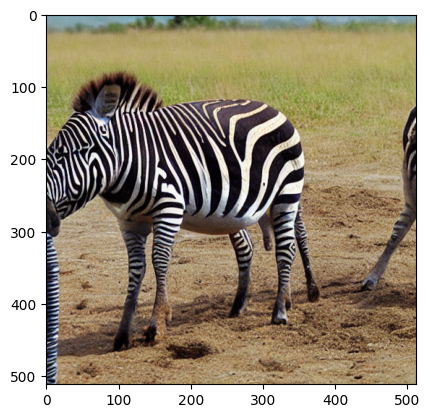

In [313]:
print(flipped[:10])
plt.imshow(counterfactual_images[11])

In [275]:
# Get distance in CLIP embedding space
from src.counterfactual_img import clip_embed
from src.distance import group_percent_explained

source_emb = clip_embed([source_imgs[i] for i in sample_source])
# source_gen_emb = clip_embed(source_gen_imgs)
target_emb = clip_embed(target_imgs)
cf_emb = clip_embed(counterfactual_images)
cf_g_emb = clip_embed(counterfactual_images_group)

# group_percent_explained(source_emb, source_gen_emb, target_emb[mapping], source_groups[sample_source], target_groups[mapping], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_emb, target_emb, source_groups[sample_source], target_groups, ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_g_emb, target_emb, source_groups[sample_source], target_groups, ["g1", "g2", "g3", "g4"])

Total Percent Explained: -18.711246591219705
g1 Percent Explained: -47.58814709734177
g2 Percent Explained: 2.9061272099421145
Worst group PE: -47.58814709734177
Total Percent Explained: -17.614355858341114
g1 Percent Explained: -47.50185848493025
g2 Percent Explained: 3.209242640080334
Worst group PE: -47.50185848493025


(-17.614355858341114, -47.50185848493025)

In [276]:
# Get distance in ResNet50 embedding space
from src.counterfactual_img import resnet50_embed
from src.distance import group_percent_explained

source_emb = resnet50_embed([source_imgs[i] for i in sample_source])
# source_gen_emb = resnet50_embed(source_gen_imgs)
target_emb = resnet50_embed(target_imgs)
cf_emb = resnet50_embed(counterfactual_images)
cf_g_emb = resnet50_embed(counterfactual_images_group)

# group_percent_explained(source_emb, source_gen_emb, target_emb[mapping], source_groups[sample_source], target_groups[mapping], ["g1", "g2", "g3", "g4"])
# pe_avg = 0.0
# group_pe_avg = 0.0
# for i in range(10):
#     sample_target = np.random.permutation(target.shape[0])[:100]
pe, _ = group_percent_explained(source_emb, cf_emb, target_emb, source_groups[sample_source], target_groups, ["g1", "g2", "g3", "g4"])
group_pe, _ = group_percent_explained(source_emb, cf_g_emb, target_emb, source_groups[sample_source], target_groups, ["g1", "g2", "g3", "g4"])
   
#     pe_avg += pe
#     group_pe_avg += group_pe
# print(pe_avg / 10)
# print(group_pe_avg / 10)

Total Percent Explained: -1.8979183315135812
g1 Percent Explained: -22.095904862550796
g2 Percent Explained: 13.174026137139647
Worst group PE: -22.095904862550796
Total Percent Explained: -0.480667190278359
g1 Percent Explained: -15.355564281774075
g2 Percent Explained: 11.211420356795117
Worst group PE: -15.355564281774075


In [277]:
# Get percent feasible
from src.counterfactual_img import resnet50_classify

source_cls = resnet50_classify([source_imgs[i] for i in sample_source])
cf_cls = resnet50_classify(counterfactual_images)
cf_group_cls = resnet50_classify(counterfactual_images_group)

init_group1 = (source_labels[sample_source] == 1)
init_group2 = (source_labels[sample_source] == 0)
cf_group1 = np.isin(cf_cls, subclass_split[1][1])
cf_group2 = np.isin(cf_cls, subclass_split[1][2])
cf_g_group1 = np.isin(cf_group_cls, subclass_split[1][1])
cf_g_group2 = np.isin(cf_group_cls, subclass_split[1][2])

# print(init_group1 & init_group2)
# print(init_group2)

print("% Feasible:", 100 * (np.sum(np.logical_or(init_group1 & cf_group1, init_group2 & cf_group2))) / sample_source.shape[0])
print("% Feasible:", 100 * (np.sum(np.logical_or(init_group1 & cf_g_group1, init_group2 & cf_g_group2))) / sample_source.shape[0])

% Feasible: 50.16722408026756
% Feasible: 49.49832775919732


In [303]:
# Percent flipped
flipped = np.logical_or(cf_group1, cf_group2)
flipped_group = np.logical_or(cf_g_group1, cf_g_group2)
print("% Flipped:", 100 * np.sum(flipped) / flipped.shape[0])
print("% Flipped:", 100 * np.sum(flipped_group) / flipped_group.shape[0])

% Flipped: 84.94983277591973
% Flipped: 83.61204013377926


In [31]:
with open("../data/imagenetx/dice_x_s_norm_5.pkl", "wb") as f:
    pickle.dump(x_s_norm, f)
with open("../data/imagenetx/dice_x_s_group_norm_5.pkl", "wb") as f:
    pickle.dump(x_s_group_norm, f)

# OT

In [280]:
import pickle

x_s = pickle.load(open("../data/imagenetx/x_s_5.pkl", "rb"))
x_s_group = pickle.load(open("../data/imagenetx/x_s_group_5.pkl", "rb"))

In [ ]:
import numpy as np
from src.optimal_transport import group_feature_transport
import pickle
from src.counterfactual_img import counterfactual_img2img
from src.counterfactual_img import resnet50_embed
from src.counterfactual_img import resnet50_classify
from src.distance import group_percent_explained

reg_total = []
reg_worst = []
emb_total = []
emb_worst = []
emb_group_total = []
emb_group_worst = []
reg_feas = []
reg_pf = []
reg_pf_worst = []
group_total = []
group_worst = []
group_feas = []
group_pf = []
group_pf_worst = []
for i in range(3):
    no_group_s = np.ones((source.shape[0], 1))
    no_group_t = np.ones((target.shape[0], 1))
    x_s = group_feature_transport(source, target, no_group_s, no_group_t, source.shape[0], 3.0, 100)

#     with open("../data/imagenetx/x_s_5.pkl", "wb") as f:
#         pickle.dump(x_s, f)

    pe, wgpe = group_percent_explained(source, x_s.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"]) #["few diffs", "mid diffs", "high diffs"])
    reg_total.append(pe)
    reg_worst.append(wgpe)
    
    x_s_group = group_feature_transport(source, target, source_groups, target_groups, source.shape[1], 3.0, 100)
    pe_g, wgpe_g = group_percent_explained(source, x_s_group.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"]) #["few diffs", "mid diffs", "high diffs"])
    group_total.append(pe_g)
    group_worst.append(pe_g)
    
    sample1 = np.arange(x_s.shape[0])
    sample2 = np.arange(target.shape[0])
    diff_group = (x_s_group - source)[sample1].round(0)
    diff_tot = (x_s - source)[sample1].round(0)

    counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_tot)
    counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_group)
    source_gen_imgs, _ = counterfactual_img2img([source_captions[i] for i in sample1], features, np.zeros_like(diff_tot))

    source_imgs = []
    for filename in source_files:
        source_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

    target_imgs = []
    for filename in target_files:
        target_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

    source_emb = resnet50_embed([source_imgs[i] for i in sample1])
    source_gen_emb = resnet50_embed(source_gen_imgs)
    target_emb = resnet50_embed(target_imgs)
    cf_emb = resnet50_embed(counterfactual_images)
    cf_g_emb = resnet50_embed(counterfactual_images_group)


    no_group_s = np.ones((source_emb.shape[0], 1))
    no_group_t = np.ones((target_emb.shape[0], 1))
    group_percent_explained(source_emb, source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
    pe, wgpe = group_percent_explained(source_emb, cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
    emb_total.append(pe)
    emb_worst.append(wgpe)
    pe, wgpe = group_percent_explained(source_emb, cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
    emb_group_total.append(pe)
    emb_group_worst.append(wgpe)

    source_cls = resnet50_classify([source_imgs[i] for i in sample1])
    cf_cls = resnet50_classify(counterfactual_images)
    cf_group_cls = resnet50_classify(counterfactual_images_group)

    init_group1 = (source_labels[sample1] == 1)
    init_group2 = (source_labels[sample1] == 0)
    cf_group1 = np.isin(cf_cls, subclass_split[1][1])
    cf_group2 = np.isin(cf_cls, subclass_split[1][2])
    cf_g_group1 = np.isin(cf_group_cls, subclass_split[1][1])
    cf_g_group2 = np.isin(cf_group_cls, subclass_split[1][2])

    reg_feas.append(100 * (np.sum(np.logical_or(init_group1 & cf_group1, init_group2 & cf_group2))) / sample1.shape[0])
    group_feas.append(100 * (np.sum(np.logical_or(init_group1 & cf_g_group1, init_group2 & cf_g_group2))) / sample1.shape[0])
    
    flipped = np.logical_or(cf_group1, cf_group2)
    flipped_group = np.logical_or(cf_g_group1, cf_g_group2)
    reg_pf.append(100 * np.sum(flipped) / flipped.shape[0])
    group_pf.append(100 * np.sum(flipped_group) / flipped_group.shape[0])

[0]
Iter 0 loss: 1.0
Change in x_s: 18.204435348510742
Iter 1 loss: 0.6571379913890645
Change in x_s: 15.375048637390137
Iter 2 loss: 0.4193024757003296
Change in x_s: 12.308338165283203
Iter 3 loss: 0.26722478652221326
Change in x_s: 9.804691314697266
Iter 4 loss: 0.17073669857016902
Change in x_s: 7.802508354187012
Iter 5 loss: 0.10954975736501875
Change in x_s: 6.2205939292907715
Iter 6 loss: 0.07041676222342502
Change in x_s: 4.9860992431640625
Iter 7 loss: 0.04531997968095903
Change in x_s: 3.967937469482422
Iter 8 loss: 0.029401098838065857
Change in x_s: 3.157839298248291
Iter 9 loss: 0.019297765841331593
Change in x_s: 2.5116047859191895
Iter 10 loss: 0.012885868302010354
Change in x_s: 1.9976484775543213
Iter 11 loss: 0.008816779201154208
Change in x_s: 1.5937466621398926
Iter 12 loss: 0.006224758765783864
Change in x_s: 1.266353726387024
Iter 13 loss: 0.004572506617854479
Change in x_s: 1.0111244916915894
Iter 14 loss: 0.0034905345309825305
Change in x_s: 0.8459515571594238
I

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the early 1 9 6 0 s, black and white film photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['with white hair']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cattle']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (90 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the early 1 9 6 0 s, black and white film photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['hair']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['hypdertailed']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['2']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cattle']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

In [21]:
print(np.mean(reg_total), np.std(reg_total))
print(np.mean(reg_worst), np.std(reg_worst))
print(np.mean(emb_total), np.std(emb_total))
print(np.mean(emb_worst), np.std(emb_worst))
print(np.mean(reg_feas), np.std(reg_feas))
print(np.mean(reg_pf), np.std(reg_pf))
print()
print(np.mean(group_total), np.std(group_total))
print(np.mean(group_worst), np.std(group_worst))
print(np.mean(emb_group_total), np.std(emb_group_total))
print(np.mean(emb_group_worst), np.std(emb_group_worst))
print(np.mean(group_feas), np.std(group_feas))
print(np.mean(group_pf), np.std(group_pf))

99.7054262013561 0.00877488812569317
26.92769276927696 4.194415149667261
7.180868093382227 1.0418327911465817
-17.296284136521095 2.73867565242492
36.12040133779264 0.5461515591489817
53.6231884057971 0.877815816500761

99.63890705264718 0.1363638261188264
99.63890705264718 0.1363638261188264
12.806259022485248 1.338651350827349
-14.704217322649862 2.4968411289048293
48.16053511705686 0.722490601829191
54.06911928651059 0.8342602869061202


In [34]:
from src.distance import group_percent_explained

group_percent_explained(source, x_s.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"]) #["few diffs", "mid diffs", "high diffs"])

Total Percent Explained: 97.96322012241475
c1 Percent Explained: 50.09000900090008
c2 Percent Explained: 87.55857976365654
Worst group PE: 50.09000900090008


(97.96322012241475, 50.09000900090008)

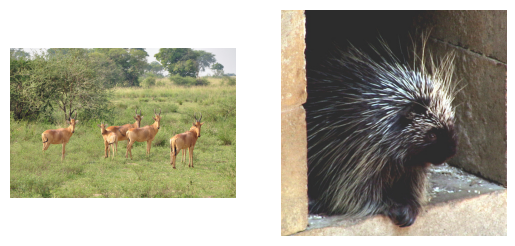

In [285]:
from sklearn.neighbors import KNeighborsClassifier
from PIL import Image
from matplotlib import pyplot as plt
import re

knn = KNeighborsClassifier(n_neighbors=1).fit(target, np.arange(target.shape[0]))
mapping = knn.predict(x_s.round(0))
row_s = source_files[0]
row_t = target_files[mapping[0]]

fig, ax = plt.subplots(1, 2)
for i, filename in enumerate([row_s, row_t]):
    # dirname = re.sub("_.*", "", filename)
    img = Image.open(f"{IMAGENET_DIR}/{filename}")
    ax[i].imshow(img)
    ax[i].axis('off')
plt.savefig("../figures/ot_bad_mapping.pdf", bbox_inches='tight')

In [36]:
from src.optimal_transport import group_feature_transport
import pickle

x_s_group = group_feature_transport(source, target, source_groups, target_groups, source.shape[1], 3.0, 100)

with open("../data/imagenetx/x_s_group_5.pkl", "wb") as f:
    pickle.dump(x_s_group, f)

[0, 1]
Iter 0 loss: 1.0
Iter 1 loss: 0.7146890295251185
Iter 2 loss: 0.501185571999752
Iter 3 loss: 0.3626433947430042
Iter 4 loss: 0.27337420970498033
Iter 5 loss: 0.21293757469209512
Iter 6 loss: 0.1712761737897049
Iter 7 loss: 0.14190019996810005
Iter 8 loss: 0.12121578690589202
Iter 9 loss: 0.10397689990001405
Iter 10 loss: 0.08242538833849047
Iter 11 loss: 0.06684920342584728
Iter 12 loss: 0.051551085258002755
Iter 13 loss: 0.042128677701313226
Iter 14 loss: 0.03578588793702127
Iter 15 loss: 0.03107460658113236
Iter 16 loss: 0.022019884877493415
Iter 17 loss: 0.017933397176535665
Iter 18 loss: 0.01456694792237593
Iter 19 loss: 0.012392176214881609
Iter 20 loss: 0.010728049172461424
Iter 21 loss: 0.009821441542939648
Iter 22 loss: 0.009292007062476147
Iter 23 loss: 0.00892393140642065
Iter 24 loss: 0.00863709953444613
Iter 25 loss: 0.008417159322262627
Iter 26 loss: 0.008305603418803854
Iter 27 loss: 0.008244671855119836
Iter 28 loss: 0.008211629262976685
Iter 29 loss: 0.0081947433

In [37]:
from src.distance import group_percent_explained

group_percent_explained(source, x_s_group.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"]) #["few diffs", "mid diffs", "high diffs"])

Total Percent Explained: 98.87798036465638
c1 Percent Explained: 97.92979297929793
c2 Percent Explained: 99.20262026414149
Worst group PE: 97.92979297929793


(98.87798036465638, 97.92979297929793)

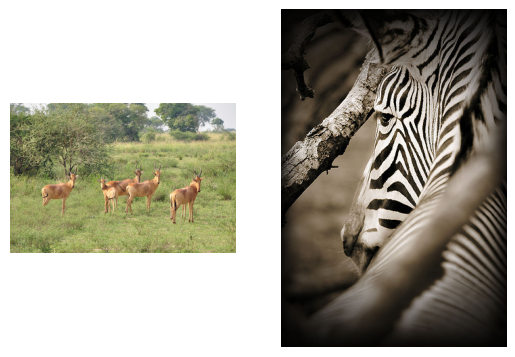

In [286]:
from sklearn.neighbors import KNeighborsClassifier
from PIL import Image
from matplotlib import pyplot as plt
import re

knn = KNeighborsClassifier(n_neighbors=1).fit(target, np.arange(target.shape[0]))
mapping_group = knn.predict(x_s_group.round(0))
row_s = source_files[0]
row_t = target_files[mapping_group[0]]

fig, ax = plt.subplots(1, 2)
for i, filename in enumerate([row_s, row_t]):
    # dirname = re.sub("_.*", "", filename)
    img = Image.open(f"{IMAGENET_DIR}/{filename}")
    ax[i].imshow(img)
    ax[i].axis('off')
plt.savefig("../figures/group_ot_good_mapping.pdf", bbox_inches='tight')

In [39]:
# %%capture
from src.counterfactual_img import counterfactual_img2img


sample1 = np.arange(x_s.shape[0])
sample2 = np.arange(target.shape[0])
diff_group = (x_s_group - source)[sample1].round(0)
diff_tot = (x_s - source)[sample1].round(0)

counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_tot)
counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_group)
source_gen_imgs, _ = counterfactual_img2img([source_captions[i] for i in sample1], features, np.zeros_like(diff_tot))

diff = np.nonzero(np.any(diff_group != diff_tot, axis=1))[0]
print("Differences:", diff.shape)

with open("../data/imagenetx/counterfactual_images_5.pkl", "wb") as f:
    pickle.dump(counterfactual_images, f)
with open("../data/imagenetx/counterfactual_images_group_5.pkl", "wb") as f:
    pickle.dump(counterfactual_images_group, f)
with open("../data/imagenetx/source_gen_imgs_5.pkl", "wb") as f:
    pickle.dump(source_gen_imgs, f)
with open("../data/imagenetx/ot_prompts_5.pkl", "wb") as f:
    pickle.dump(ot_prompts, f)
with open("../data/imagenetx/got_prompts_5.pkl", "wb") as f:
    pickle.dump(got_prompts, f)
with open("../data/imagenetx/subset_5.pkl", "wb") as f:
    pickle.dump(sample1, f)

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Differences: (236,)


In [39]:
counterfactual_images = pickle.load(open("../data/imagenetx/counterfactual_images_5.pkl", "rb"))
counterfactual_images_group = pickle.load(open("../data/imagenetx/counterfactual_images_group_5.pkl", "rb"))
# source_imgs = pickle.load(open("../data/imagenetx/source_imgs_5.pkl", "rb"))
source_gen_imgs = pickle.load(open("../data/imagenetx/source_gen_imgs_5.pkl", "rb"))
sample1 = pickle.load(open("../data/imagenetx/subset_5.pkl", "rb"))

In [18]:
source_imgs = []
for filename in source_files:
    source_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

target_imgs = []
for filename in target_files:
    target_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

In [42]:
# Get distance in CLIP embedding space
from src.counterfactual_img import clip_embed
from src.distance import group_percent_explained

source_emb = clip_embed([source_imgs[i] for i in sample1])
source_gen_emb = clip_embed(source_gen_imgs)
target_emb = clip_embed(target_imgs)
cf_emb = clip_embed(counterfactual_images)
cf_g_emb = clip_embed(counterfactual_images_group)


no_group_s = np.ones((source_emb.shape[0], 1))
no_group_t = np.ones((target_emb.shape[0], 1))
group_percent_explained(source_emb, source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])

Total Percent Explained: -10.07374232573133
g1 Percent Explained: -12.952090050202358
g2 Percent Explained: -7.535969454194884
Worst group PE: -12.952090050202358
Total Percent Explained: 8.538011439656772
g1 Percent Explained: -23.37870693153813
g2 Percent Explained: 26.106618483768884
Worst group PE: -23.37870693153813
Total Percent Explained: 11.14746991123838
g1 Percent Explained: -16.015702443502665
g2 Percent Explained: 32.555423681919
Worst group PE: -16.015702443502665


(11.14746991123838, -16.015702443502665)

In [43]:
# Get distance in ResNet50 embedding space
from src.counterfactual_img import resnet50_embed
from src.distance import group_percent_explained

source_emb = resnet50_embed([source_imgs[i] for i in sample1])
source_gen_emb = resnet50_embed(source_gen_imgs)
target_emb = resnet50_embed(target_imgs)
cf_emb = resnet50_embed(counterfactual_images)
cf_g_emb = resnet50_embed(counterfactual_images_group)


no_group_s = np.ones((source_emb.shape[0], 1))
no_group_t = np.ones((target_emb.shape[0], 1))
group_percent_explained(source_emb, source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])

Total Percent Explained: -1.6192764201860812
g1 Percent Explained: -0.140732201737091
g2 Percent Explained: -3.104219322096981
Worst group PE: -3.104219322096981
Total Percent Explained: 4.239531015032752
g1 Percent Explained: -22.095058956957953
g2 Percent Explained: 17.755537419302318
Worst group PE: -22.095058956957953
Total Percent Explained: 9.180438824008029
g1 Percent Explained: -18.989287486751287
g2 Percent Explained: 31.091989325369486
Worst group PE: -18.989287486751287


(9.180438824008029, -18.989287486751287)

In [40]:
# Get percent feasible
from src.counterfactual_img import resnet50_classify

source_cls = resnet50_classify([source_imgs[i] for i in sample1])
cf_cls = resnet50_classify(counterfactual_images)
cf_group_cls = resnet50_classify(counterfactual_images_group)

init_group1 = (source_labels[sample1] == 1)
init_group2 = (source_labels[sample1] == 0)
cf_group1 = np.isin(cf_cls, subclass_split[1][1])
cf_group2 = np.isin(cf_cls, subclass_split[1][2])
cf_g_group1 = np.isin(cf_group_cls, subclass_split[1][1])
cf_g_group2 = np.isin(cf_group_cls, subclass_split[1][2])

# print(init_group1 & init_group2)
# print(init_group2)

print("% Feasible:", 100 * (np.sum(np.logical_or(init_group1 & cf_group1, init_group2 & cf_group2))) / sample1.shape[0])
print("% Feasible:", 100 * (np.sum(np.logical_or(init_group1 & cf_g_group1, init_group2 & cf_g_group2))) / sample1.shape[0])

% Feasible: 36.45484949832776
% Feasible: 45.48494983277592


In [41]:
# Percent flipped
flipped = np.logical_or(cf_group1, cf_group2)
flipped_group = np.logical_or(cf_g_group1, cf_g_group2)
print("% Flipped:", 100 * np.sum(flipped) / flipped.shape[0])
print("% Flipped:", 100 * np.sum(flipped_group) / flipped_group.shape[0])

% Flipped: 52.17391304347826
% Flipped: 52.508361204013376


a painting of a cat climbing up a tree, by Robert Bateman, norm rockwell, , by Terry Redlin, by Harvey Dunn, inspired by Robert Bateman, inspired by Neil Welliver, berkey, by George Stubbs
a painting of a cat climbing up a tree, by Robert Bateman, norm rockwell, , by Terry Redlin, by Harvey Dunn, inspired by Robert Bateman, inspired by Neil Welliver, berkey, by George Stubbs
---


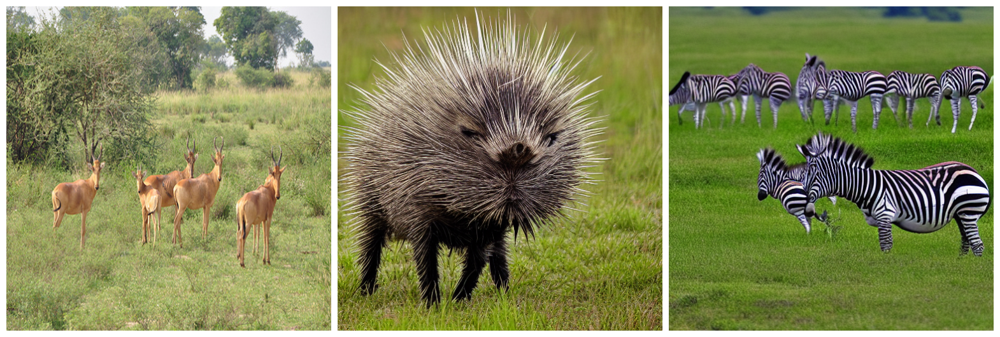

In [314]:
import pickle
from mpl_toolkits.axes_grid1 import ImageGrid
from matplotlib import pyplot as plt
from torchvision.transforms import Resize
import numpy as np

transform = Resize((256, 256))

counterfactual_images = pickle.load(open("../data/imagenetx/counterfactual_images_5.pkl", "rb"))
counterfactual_images_group = pickle.load(open("../data/imagenetx/counterfactual_images_group_5.pkl", "rb"))
# source_imgs = pickle.load(open("../data/imagenetx/source_imgs_1.pkl", "rb"))
source_gen_imgs = pickle.load(open("../data/imagenetx/source_gen_imgs_5.pkl", "rb"))
# target_imgs = pickle.load(open("../data/imagenetx/target_imgs.pkl", "rb"))

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(1, 3),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for i, j in enumerate(sample1[0:1]):
    if i >= 10:
        break
    print(ot_prompts[i])
    print(got_prompts[i])
    print("---")
    grid[i * 3 + 0].imshow(source_imgs[j])
    grid[i * 3 + 1].imshow(counterfactual_images[i])
    grid[i * 3 + 2].imshow(counterfactual_images_group[i])
    grid[i * 3 + 0].axis('off')
    grid[i * 3 + 1].axis('off')
    grid[i * 3 + 2].axis('off')
plt.savefig("../figures/ot_and_group_generated.pdf", bbox_inches='tight')
#     grid[i * 4 + 3].imshow(img_t)

In [46]:
# sample1 = pickle.load(open("../data/imagenetx/subset_2.pkl", "rb"))

In [47]:
# ot_prompts = pickle.load(open("../data/imagenetx/ot_prompts_2.pkl", "rb"))
# got_prompts = pickle.load(open("../data/imagenetx/got_prompts_2.pkl", "rb"))

# print(ot_prompts[8])
# print(got_prompts[8])

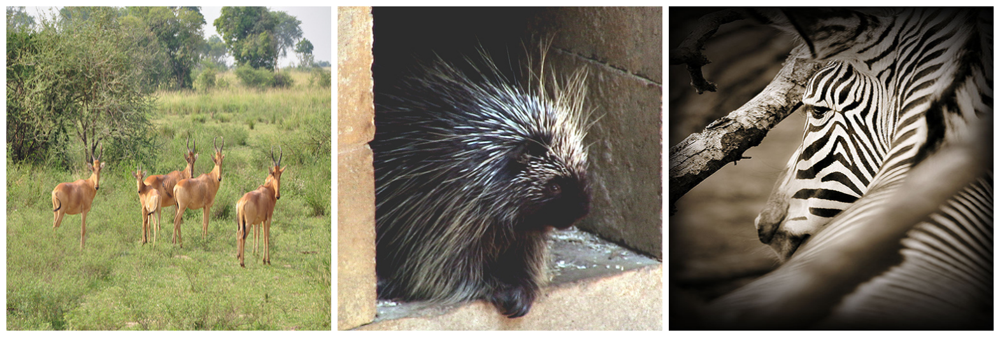

In [293]:
from mpl_toolkits.axes_grid1 import ImageGrid
from matplotlib import pyplot as plt
from PIL import Image

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(1, 3),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

# print(len(source_imgs), len(target_imgs))
for i in range(1):
    if i >= 10:
        break
    
    grid[i * 3 + 0].imshow(source_imgs[i])
    grid[i * 3 + 1].imshow(target_imgs[mapping[sample1[i]]])
    grid[i * 3 + 2].imshow(target_imgs[mapping_group[sample1[i]]])
    grid[i * 3 + 0].axis('off')
    grid[i * 3 + 1].axis('off')
    grid[i * 3 + 2].axis('off')
    # grid[i * 3 + 2].imshow(img_tg)
    # print(source[i])
    # print(x_s[i].round(0))
    # print(x_s_group[i].round(0))
    # print(target[i])
    # print("---")
plt.savefig("../figures/ot_and_group_compare.pdf", bbox_inches='tight')

# Mean Shift

In [49]:
import pickle

# x_s = pickle.load(open("../data/imagenetx/ms_x_s_5.pkl", "rb"))
# x_s_group = pickle.load(open("../data/imagenetx/ms_x_s_group_5.pkl", "rb"))
# counterfactual_images = pickle.load(open("../data/imagenetx/ms_counterfactual_images_5.pkl", "rb"))
# counterfactual_images_group = pickle.load(open("../data/imagenetx/ms_counterfactual_images_group_5.pkl", "rb"))

In [50]:
from src.optimal_transport import group_mean_shift_transport
from src.distance import group_percent_explained

# no_group_s = np.ones((source.shape[0], 1))
# no_group_t = np.ones((target.shape[0], 1))
# x_s, shift = group_mean_shift_transport(source, target, no_group_s, no_group_t, source.shape[1], 1.0, 100)
# # x_s = source + (np.mean(target, axis=0) - np.mean(source, axis=0))
# group_percent_explained(source, x_s.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"])

# with open("../data/imagenetx/ms_x_s_2.pkl", "wb") as f:
#     pickle.dump(x_s, f)

In [51]:
# for i in np.argsort(shift.round(0))[:5]:
#     print(f"Shift in {features[i]} by {shift[i].round(0)}.")
# for i in np.argsort(shift.round(0))[-5:]:
#     print(f"Shift in {features[i]} by {shift[i].round(0)}.")

In [52]:
# x_s_group, shift = group_mean_shift_transport(source, target, source_groups, target_groups, source.shape[1], 1.0, 100)
# group_percent_explained(source, x_s_group.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"])

# with open("../data/imagenetx/ms_x_s_group_2.pkl", "wb") as f:
#     pickle.dump(x_s_group, f)

In [53]:
# for i in np.argsort(shift.round(0))[:5]:
#     print(f"Shift in {features[i]} by {shift[i].round(0)}.")
# for i in np.argsort(shift.round(0))[-5:]:
#     print(f"Shift in {features[i]} by {shift[i].round(0)}.")

In [54]:
# %%capture
# from src.counterfactual_img import counterfactual_img2img

# diff_group = (x_s_group - source)[sample1].round(0)
# diff_tot = (x_s - source)[sample1].round(0)

# counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_tot)
# counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_group)

# diff = np.nonzero(np.any(diff_group != diff_tot, axis=1))[0]
# print("Differences:", diff.shape)

# with open("../data/imagenetx/ms_counterfactual_images_2.pkl", "wb") as f:
#     pickle.dump(counterfactual_images, f)
# with open("../data/imagenetx/ms_counterfactual_images_group_2.pkl", "wb") as f:
#     pickle.dump(counterfactual_images_group, f)
# with open("../data/imagenetx/ms_ot_prompts_2.pkl", "wb") as f:
#     pickle.dump(ot_prompts, f)
# with open("../data/imagenetx/ms_got_prompts_2.pkl", "wb") as f:
#     pickle.dump(got_prompts, f)

In [55]:
# # Get distance in CLIP embedding space
# from src.counterfactual_img import clip_embed
# from src.distance import group_percent_explained

# source_emb = clip_embed(source_imgs)
# source_gen_emb = clip_embed(source_gen_imgs)
# target_emb = clip_embed(target_imgs)
# cf_emb = clip_embed(counterfactual_images)
# cf_g_emb = clip_embed(counterfactual_images_group)


# no_group_s = np.ones((source_emb.shape[0], 1))
# no_group_t = np.ones((target_emb.shape[0], 1))
# group_percent_explained(source_emb[sample1], source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
# group_percent_explained(source_emb[sample1], cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
# group_percent_explained(source_emb[sample1], cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])

In [56]:
# counterfactual_images = pickle.load(open("../data/imagenetx/ms_counterfactual_images_2.pkl", "rb"))
# counterfactual_images_group = pickle.load(open("../data/imagenetx/ms_counterfactual_images_group_2.pkl", "rb"))

In [57]:
# # Get distance in ResNet50 embedding space
# from src.counterfactual_img import resnet50_embed
# from src.distance import group_percent_explained

# source_emb = resnet50_embed([source_imgs[i] for i in sample1])
# source_gen_emb = resnet50_embed(source_gen_imgs)
# target_emb = resnet50_embed(target_imgs)
# cf_emb = resnet50_embed(counterfactual_images)
# cf_g_emb = resnet50_embed(counterfactual_images_group)


# no_group_s = np.ones((source_emb.shape[0], 1))
# no_group_t = np.ones((target_emb.shape[0], 1))
# group_percent_explained(source_emb, source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
# group_percent_explained(source_emb, cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
# group_percent_explained(source_emb, cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])

# K-Cluster Shift

In [35]:
import pickle

x_s = pickle.load(open("../data/imagenetx/kc_x_s_5.pkl", "rb"))
x_s_group = pickle.load(open("../data/imagenetx/kc_x_s_group_5.pkl", "rb"))
counterfactual_images = pickle.load(open("../data/imagenetx/kc_counterfactual_images_5.pkl", "rb"))
counterfactual_images_group = pickle.load(open("../data/imagenetx/kc_counterfactual_images_group_5.pkl", "rb"))

In [128]:
from src.optimal_transport import group_kmeans_shift_transport
from src.distance import group_percent_explained

no_group_s = np.ones((source.shape[0], 1))
no_group_t = np.ones((target.shape[0], 1))
sample1 = np.arange(x_s.shape[0])

reg_total = []
reg_worst = []
emb_total = []
emb_worst = []
emb_group_total = []
emb_group_worst = []
reg_feas = []
reg_pf = []
reg_pf_worst = []
group_total = []
group_worst = []
group_feas = []
group_pf = []
group_pf_worst = []
for i in range(3):
    x_s, centroids, shifts = group_kmeans_shift_transport(source, target, no_group_s, no_group_t, source.shape[1], 5, 50.0, 100)
    pe, wgpe = group_percent_explained(source, x_s.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"])
    reg_total.append(pe)
    reg_worst.append(wgpe)
    
    x_s_group, centroids, shifts = group_kmeans_shift_transport(source, target, source_groups, target_groups, source.shape[1], 5, 50, 100)
    pe, wgpe = group_percent_explained(source, x_s_group.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"])
    group_total.append(pe)
    group_worst.append(wgpe)
    
    diff_group = (x_s_group - source)[sample1].round(0)
    diff_tot = (x_s - source)[sample1].round(0)

    counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_tot)
    counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_group)

    source_emb = resnet50_embed([source_imgs[i] for i in sample1])
    target_emb = resnet50_embed(target_imgs)
    cf_emb = resnet50_embed(counterfactual_images)
    cf_g_emb = resnet50_embed(counterfactual_images_group)

    no_group_s = np.ones((source_emb.shape[0], 1))
    no_group_t = np.ones((target_emb.shape[0], 1))
    pe, wgpe = group_percent_explained(source_emb, cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
    emb_total.append(pe)
    emb_worst.append(wgpe)
    pe, wgpe = group_percent_explained(source_emb, cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
    emb_group_total.append(pe)
    emb_group_worst.append(wgpe)
    
    source_cls = resnet50_classify([source_imgs[i] for i in sample1])
    cf_cls = resnet50_classify(counterfactual_images)
    cf_group_cls = resnet50_classify(counterfactual_images_group)

    init_group1 = (source_labels[sample1] == 1)
    init_group2 = (source_labels[sample1] == 0)
    cf_group1 = np.isin(cf_cls, subclass_split[1][1])
    cf_group2 = np.isin(cf_cls, subclass_split[1][2])
    cf_g_group1 = np.isin(cf_group_cls, subclass_split[1][1])
    cf_g_group2 = np.isin(cf_group_cls, subclass_split[1][2])

    reg_feas.append(100 * (np.sum(np.logical_or(init_group1 & cf_group1, init_group2 & cf_group2))) / sample1.shape[0])
    group_feas.append(100 * (np.sum(np.logical_or(init_group1 & cf_g_group1, init_group2 & cf_g_group2))) / sample1.shape[0])

    flipped = np.logical_or(cf_group1, cf_group2)
    flipped_group = np.logical_or(cf_g_group1, cf_g_group2)
    reg_pf.append(100 * np.sum(flipped) / flipped.shape[0])
    group_pf.append(100 * np.sum(flipped_group) / flipped_group.shape[0])
#     with open("../data/imagenetx/kc_x_s_5.pkl", "wb") as f:
#         pickle.dump(x_s, f)
#     with open("../data/imagenetx/kc_shifts_5.pkl", "wb") as f:
#         pickle.dump(shifts, f)
#     with open("../data/imagenetx/kc_centroids_5.pkl", "wb") as f:
#         pickle.dump(centroids, f)

Samples in cluster 0: 131
Samples in cluster 1: 52
Samples in cluster 2: 37
Samples in cluster 3: 32
Samples in cluster 4: 47
Iter 0 loss: 1.0
Change in x_s: 5.379418849945068
Iter 1 loss: 0.600264160197326
Change in x_s: 2.899392604827881
Iter 2 loss: 0.4556763010685622
Change in x_s: 2.1297926902770996
Iter 3 loss: 0.3778549028593209
Change in x_s: 1.583564043045044
Iter 4 loss: 0.3360383486197548
Change in x_s: 1.1318105459213257
Iter 5 loss: 0.31462180242498866
Change in x_s: 0.8104944825172424
Iter 6 loss: 0.30312369524363875
Change in x_s: 0.6130385398864746
Iter 7 loss: 0.29658393592267673
Change in x_s: 0.45528140664100647
Iter 8 loss: 0.2929187763929692
Change in x_s: 0.34974685311317444
Iter 9 loss: 0.2907674200190234
Change in x_s: 0.25848865509033203
Iter 10 loss: 0.2895650468894012
Change in x_s: 0.1893850713968277
Iter 11 loss: 0.2889146786300474
Change in x_s: 0.14823420345783234
Iter 12 loss: 0.2884518081016729
Change in x_s: 0.1293138563632965
Iter 13 loss: 0.288010915

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', powdered sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', 🐿🍸🍋, intruder']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ro']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', two large horns on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['portrait, 1 9 7 5 photo']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', running fast towards the camera']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sters']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns, young adult male, a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['canon']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ana background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wet']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['him']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pomorphism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mascot']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['raw']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['beautiful female white']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', on a branch']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tails, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['two male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', puffballs']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pose, roughled fur, servant']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', young male with walking stick, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', antigravity, olympic diving springoard']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['high - resolution photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['branch, contorted limbs']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['merged machima, lone female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['body portrait']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a birthday cake']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['bateman']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['landscape, steppe, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['springer']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horned tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife photography canon']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['surface']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['folgung']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['single animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['quarters']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ily']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['miniature animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['eating ice - cream, gluttony']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animal, thin young male, small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', gopher']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['growth from the back']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animal photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tree, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['buru, single horn']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['white film photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cuddly']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['aciated, adult pair of twins']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['away, african savannah']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['puffy']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['short horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male, sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['naturalist']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['running in savana']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', adult pair of twins']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['c 1 5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', african savannah']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['steppe']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['light brown fur']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grasslands, grassland, wildlife photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['adult male, acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animal, rare classified photo']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horn on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['springer']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', stuffed toy, mixed animal, animals mating']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['of twins, young male with walking stick']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grassy plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ttony']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ers']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['furry tail, tail raised']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['exhibit']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains, horses in run']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['large horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns!']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the, mature male, young female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['les crossed in background, wildlife preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', scared expression']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['digital photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['!!!!!!!!, surprised']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['use']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mil portrait']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['head,, short horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['chilla animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['1 0 0 0']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['lands, horns on its head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['coloring, acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ative biology']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['focus - c 1 5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', african steppe, two male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['�, eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['species photography, lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['adobe stock']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['two small horn on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['humanoid']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['night vision']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['head, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the lake']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pose']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', kodak hie infrared film, ground level camera view']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['commons attribution, young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['motion blur']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['!! t - shirt']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['style painting']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sabre']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ley']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', hamsters']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['head, picture taken in zoo, impressive horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in, two male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['kers']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['savannah, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['eos 5 d']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['5 0 mm sharp lens']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['up photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', small horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ers, lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife photograph, 2 0 0 mm telephoto']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['u, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['white spiral horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['with mud']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', mixed animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', squirrel / tiger, high quality nature photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['phic deer, horns on its head, single horn']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['illipeds, caza']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sharp long horns,']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['klipspringer, ground camera, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife photography canon']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african steppe']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['fur']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', running in savana, steppe']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['orns, cover shot']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['7 r']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tail with horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['canon, face of an ox']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ppy']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['single, zoo photography, on the']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['manimalist']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife documentary, maternal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['2 0 0. 0 mm']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wet, an ox, great horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['hamster']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [')']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['prayer, natural tpose']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['print']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cream']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['eyes']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['biden']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['looking body']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['coloring']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['phic beaver']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['aob tree']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animals, savanna']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['with mud']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [',, two large horns on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['holding rifles']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['monster']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['nature documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['film, photo 3 5 mm, kodak gold 2 0 0 film']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['culling']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['of white mesh rope']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['high - resolution photograph, still from nature documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
Token indices sequence length is longer than the specified maximum sequence length for this model (84 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['savanna, various animals, wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', fights, boxing match']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', by jacob willemszoon de wet']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, african steppe, many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female white']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['older male, young male, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['de wet, bushveld background, two male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['puffballs']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- resolution photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['norm rockwell in africa, merged machima, lone female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['unt, african steppe, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['portrait']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['birthday cake']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grassy plain, safari background, steppe landscape, steppe, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['u, sharp long horns, large horned tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', older male, sharp long horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', an expansive grassy plain, savanna, wildlife photography canon']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gung']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', with horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['stick, large horned tail, mature male, klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, golden grasslands, many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gopher']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['shot, ground camera']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['film photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['natural reflections']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife preservation, norm rockwell in africa']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['alist']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['landscape of africa, an expansive grassy plain, adult pair of twins']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', anthropomorphic deer fe']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['creature 5 meters tall']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in middle, two small horn on the']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['behind, adult pair of twins, young male with walking stick']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', safari background, wildlife photography canon, grassy plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tony']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the bark']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['!']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', golden grasslands, sables crossed in background, wildlife preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['scared expression']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', surprised']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['portrait']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['illa animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['towards the camera']


  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

Total Percent Explained: 5.792514550724561
g1 Percent Explained: -22.49750255737554
g2 Percent Explained: 5.979013667641971
Worst group PE: -22.49750255737554
Total Percent Explained: 9.122752075648126
g1 Percent Explained: -3.6502980073336375
g2 Percent Explained: 18.843813773292855
Worst group PE: -3.6502980073336375
Samples in cluster 0: 131
Samples in cluster 1: 52
Samples in cluster 2: 37
Samples in cluster 3: 32
Samples in cluster 4: 47
Iter 0 loss: 1.0
Change in x_s: 5.549088001251221
Iter 1 loss: 0.5849771740476226
Change in x_s: 2.7181618213653564
Iter 2 loss: 0.45490981304388206
Change in x_s: 2.0144715309143066
Iter 3 loss: 0.38477534311933737
Change in x_s: 1.5008546113967896
Iter 4 loss: 0.34630972325206394
Change in x_s: 1.1196614503860474
Iter 5 loss: 0.3246672259616954
Change in x_s: 0.8530774116516113
Iter 6 loss: 0.31185536886150983
Change in x_s: 0.6259458065032959
Iter 7 loss: 0.3049564342624128
Change in x_s: 0.45764875411987305
Iter 8 loss: 0.3012313243033044
Chan

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', powdered sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', 🐿🍸🍋, intruder']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ro']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', duel, fighting each other, fights, boxing match']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['phic deer, zoo photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['samburu, african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['portrait, 1 9 7 5 photo']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female full body, male emaciated']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sters']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ana background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['portrait of a delicate, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wet']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['him']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pomorphism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mascot']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['raw']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['beautiful female white']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', on a branch']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tails, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['large horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns!']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', two large horns on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['les crossed in background, wildlife preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', scared expression']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['digital photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['!!!!!!!!, surprised']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['use']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mil portrait']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['chilla animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['running pose, animals running along, running towards the camera']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['1 0 0 0']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['coloring, acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ative biology']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['focus - c 1 5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['�, eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['species photography, lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['adobe stock']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['humanoid']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['night vision']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['jaw, furries wearing tails, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, side view of a gaunt']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['head, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['portrait of a delicate, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['to a drier climate, anthropomorphism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', thick furry neck and chest fluff, on a branch']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', including a long tail, long tails, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', marmoset, natural tpose, roughled fur, servant']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['aping from babaob tree, antigravity, olympic diving springoard']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife preservation, sitting on a curly branch, contorted limbs']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['de wet, african plains, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', lone female']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['running pose, animals running along, running towards the camera']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tails worn, walnuts, mottled coloring, acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['figure photography, brown tail, sharp focus - c 1 5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photograph, 🐿🍸🍋, eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['jaw, furries wearing tails, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, side view of a gaunt']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['lands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ground level camera view']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['brown almond - shaped eyes, creative commons attribution, young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', long horns, a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ana background, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', by jacob willemszoon de wet']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, african steppe, many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a branch']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['older male, young male, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['de wet, bushveld background, two male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['roughled fur, servant']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gravity, olympic diving springoard']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['contorted limbs']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plains, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['norm rockwell in africa, merged machima, lone female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['unt, african steppe, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['c 1 5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['an ox, savanna, wild species photography, lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['les crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gaunt']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['two small horn on the, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ground level camera view']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tion, young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- shirt']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the african plains, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', by jacob willemszoon de wet']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, african steppe, many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['drier climate, anthropomorphism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['babaob tree, antigravity, olympic diving springoard']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sitting on a curly branch, contorted limbs']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['norm rockwell in africa, merged machima, lone female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['unt, african steppe, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grassy plain, safari background, steppe landscape, steppe, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['eyes, in a tree, acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['u, sharp long horns, large horned tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', older male, sharp long horns']


  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', walnuts, mottled coloring, acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', brown tail, sharp focus - c 1 5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['🐿🍸🍋, eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- shaped eyes, creative commons attribution, young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wearing a black!! t - shirt']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['twins, horns on its head, picture taken in zoo, impressive horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sables crossed in, two male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['unmistakably kenyan, standing in the savannah, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sharp lens, 2 5 0 mm sharp lens']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [129]:
print(np.mean(reg_total), np.std(reg_total))
print(np.mean(reg_worst), np.std(reg_worst))
print(np.mean(emb_total), np.std(emb_total))
print(np.mean(emb_worst), np.std(emb_worst))
# print(np.mean([0.552, 13.42, -0.579]), np.std([0.552, 13.42, -0.579]))
# print(np.mean([-15.095, -23.65, -10.898]), np.std([-15.095, -23.65, -10.898]))
print(np.mean(reg_feas), np.std(reg_feas))
print(np.mean(reg_pf), np.std(reg_pf))
print()
print(np.mean(group_total), np.std(group_total))
print(np.mean(group_worst), np.std(group_worst))
print(np.mean(emb_group_total), np.std(emb_group_total))
print(np.mean(emb_group_worst), np.std(emb_group_worst))
# print(np.mean([12.6855, 9.66, 14.41]), np.std([12.6855, 9.66, 14.41]))
# print(np.mean([-4.03, -7.47, -2.58]), np.std([-4.03, -7.49, -2.58]))
print(np.mean(group_feas), np.std(group_feas))
print(np.mean(group_pf), np.std(group_pf))

48.78918975261093 2.1054425225812095
-15.541554155415513 14.935588777537632
6.502594992839306 2.9675905676860386
-18.151903340052083 7.914641768934892
26.644370122630992 7.070149384931072
45.26198439241917 2.2072452478509863

50.49848284481175 2.1977596787371576
36.678667866786675 4.397103218028524
11.174099580558197 1.5662935107229408
-2.1969406694012688 1.3261012502908553
35.67447045707915 5.190834660790552
38.238573021181715 2.842262828089623


In [384]:
x_s = pickle.load(open("../data/imagenetx/kc_x_s_5.pkl", "rb"))
shifts = pickle.load(open("../data/imagenetx/kc_shifts_5.pkl", "rb"))
centroids = pickle.load(open("../data/imagenetx/kc_centroids_5.pkl", "rb"))

In [358]:
for centroid, shift in zip(centroids, shifts):
    print([f"{features[i]}: {centroid[i].round(0)}" for i in np.nonzero(centroid.round(0))[0]])
    for i in np.argsort(shift)[:5]:
        print(f"Shift in {features[i]} by {shift[i].round(0)}.")
    for i in np.argsort(shift)[-5:]:
        print(f"Shift in {features[i]} by {shift[i].round(0)}.")

['antelope: 1.0', 'background: 1.0', 'gerenuk: 1.0', 'head: 2.0', 'horn: 2.0', 'horns: 2.0', 'male: 1.0', 'walking: 1.0', 'young: 1.0']
Shift in horns by -2.0.
Shift in head by -2.0.
Shift in horn by -2.0.
Shift in background by -1.0.
Shift in antelope by -1.0.
Shift in porcup by 1.0.
Shift in spines by 1.0.
Shift in wild by 1.0.
Shift in hair by 1.0.
Shift in spiky by 2.0.
['beaver: 4.0', 'water: 1.0', 'wildlife: 1.0']
Shift in beaver by -3.0.
Shift in water by -1.0.
Shift in wildlife by -0.0.
Shift in stick by -0.0.
Shift in tail by -0.0.
Shift in hair by 0.0.
Shift in spiky by 0.0.
Shift in squirrel by 0.0.
Shift in porcup by 0.0.
Shift in wild by 0.0.
['king: 1.0', 'squirrel: 3.0', 'squirrels: 1.0', 'tail: 2.0']
Shift in squirrel by -3.0.
Shift in tail by -1.0.
Shift in squirrels by -1.0.
Shift in king by -1.0.
Shift in male by -0.0.
Shift in guinea by 0.0.
Shift in factory by 0.0.
Shift in introduction by 0.0.
Shift in horse by 0.0.
Shift in equine by 0.0.
['african: 2.0', 'antelo

In [317]:
x_s_group, centroids, shifts = group_kmeans_shift_transport(source, target, source_groups, target_groups, source.shape[1], 5, 3.5, 100)
group_percent_explained(source, x_s_group.round(0), target, source_groups, target_groups, ["c1", "c2", "c3", "c4"])

with open("../data/imagenetx/kc_x_s_group_5.pkl", "wb") as f:
    pickle.dump(x_s_group, f)
with open("../data/imagenetx/kc_shifts_group_5.pkl", "wb") as f:
    pickle.dump(shifts, f)
with open("../data/imagenetx/kc_centroids_group_5.pkl", "wb") as f:
    pickle.dump(centroids, f)

Samples in cluster 0: 41
Samples in cluster 1: 39
Samples in cluster 2: 48
Samples in cluster 3: 83
Samples in cluster 4: 88
Iter 0 loss: 1.0
Iter 1 loss: 0.9554852069038222
Iter 2 loss: 0.9104152074881733
Iter 3 loss: 0.870268864235748
Iter 4 loss: 0.8348716807098302
Iter 5 loss: 0.8032949400643425
Iter 6 loss: 0.775228056967342
Iter 7 loss: 0.7502068807961476
Iter 8 loss: 0.7279976710980861
Iter 9 loss: 0.708293685363556
Iter 10 loss: 0.6908046310407749
Iter 11 loss: 0.6752905674355248
Iter 12 loss: 0.6615222916983329
Iter 13 loss: 0.6492568857975902
Iter 14 loss: 0.6383007107708345
Iter 15 loss: 0.628499708811892
Iter 16 loss: 0.6197269167871695
Iter 17 loss: 0.6118557939449728
Iter 18 loss: 0.6047821587151193
Iter 19 loss: 0.5984360576302478
Iter 20 loss: 0.5927037744267125
Iter 21 loss: 0.5875423165399907
Iter 22 loss: 0.5828790708134742
Iter 23 loss: 0.5786758418310303
Iter 24 loss: 0.574879757445999
Iter 25 loss: 0.5714470026760279
Iter 26 loss: 0.5683312178123124
Iter 27 loss: 

In [385]:
from sklearn.metrics import pairwise_distances

# print(np.argmin(pairwise_distances(centroids, source), axis=0))
source_clusters = np.argsort(pairwise_distances(centroids, source), axis=1)

transformed_clusters = np.argsort(pairwise_distances(centroids + shifts, target), axis=1)

In [386]:
shifts = pickle.load(open("../data/imagenetx/kc_shifts_group_5.pkl", "rb"))
centroids = pickle.load(open("../data/imagenetx/kc_centroids_group_5.pkl", "rb"))

group_transformed_clusters = np.argsort(pairwise_distances(centroids + shifts, target), axis=1)

In [324]:
for centroid, shift in zip(centroids, shifts):
    print([f"{features[i]}: {centroid[i].round(0)}" for i in np.nonzero(centroid.round(0))[0]])
    for i in np.argsort(shift)[:5]:
        print(f"Shift in {features[i]}_{i} by {shift[i].round(0)}.")
    for i in np.argsort(shift)[-5:]:
        print(f"Shift in {features[i]}_{i} by {shift[i].round(0)}.")

['antelope: 1.0', 'background: 1.0', 'gerenuk: 1.0', 'head: 2.0', 'horn: 2.0', 'horns: 2.0', 'male: 1.0', 'walking: 1.0', 'young: 1.0']
Shift in horns by -2.0.
Shift in head by -2.0.
Shift in horn by -1.0.
Shift in background by -1.0.
Shift in male by -1.0.
Shift in factory by 0.0.
Shift in pork by 0.0.
Shift in pigs by 0.0.
Shift in horse by 1.0.
Shift in equine by 1.0.
['beaver: 4.0', 'water: 1.0', 'wildlife: 1.0']
Shift in beaver by -3.0.
Shift in water by -1.0.
Shift in wildlife by -0.0.
Shift in stick by -0.0.
Shift in young by -0.0.
Shift in spiky by 0.0.
Shift in wild by 0.0.
Shift in squirrel by 0.0.
Shift in black by 0.0.
Shift in porcup by 0.0.
['king: 1.0', 'squirrel: 3.0', 'squirrels: 1.0', 'tail: 2.0']
Shift in squirrel by -3.0.
Shift in tail by -1.0.
Shift in squirrels by -1.0.
Shift in king by -1.0.
Shift in running by -0.0.
Shift in porcup by 1.0.
Shift in spines by 1.0.
Shift in wild by 1.0.
Shift in hair by 1.0.
Shift in spiky by 1.0.
['african: 2.0', 'antelope: 1.0',

In [63]:
%%capture
from src.counterfactual_img import counterfactual_img2img

diff_group = (x_s_group - source)[sample1].round(0)
diff_tot = (x_s - source)[sample1].round(0)

counterfactual_images, ot_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_tot)
counterfactual_images_group, got_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_group)

diff = np.nonzero(np.any(diff_group != diff_tot, axis=1))[0]
print("Differences:", diff.shape)

with open("../data/imagenetx/kc_counterfactual_images_5.pkl", "wb") as f:
    pickle.dump(counterfactual_images, f)
with open("../data/imagenetx/kc_counterfactual_images_group_5.pkl", "wb") as f:
    pickle.dump(counterfactual_images_group, f)
with open("../data/imagenetx/kc_ot_prompts_5.pkl", "wb") as f:
    pickle.dump(ot_prompts, f)
with open("../data/imagenetx/kc_got_prompts_5.pkl", "wb") as f:
    pickle.dump(got_prompts, f)

Token indices sequence length is longer than the specified maximum sequence length for this model (87 > 77). Running this sequence through the model will result in indexing errors


In [64]:
# Get distance in CLIP embedding space
from src.counterfactual_img import clip_embed
from src.distance import group_percent_explained

source_emb = clip_embed(source_imgs)
source_gen_emb = clip_embed(source_gen_imgs)
target_emb = clip_embed(target_imgs)
cf_emb = clip_embed(counterfactual_images)
cf_g_emb = clip_embed(counterfactual_images_group)


no_group_s = np.ones((source_emb.shape[0], 1))
no_group_t = np.ones((target_emb.shape[0], 1))
group_percent_explained(source_emb[sample1], source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb[sample1], cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb[sample1], cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])

Total Percent Explained: -10.07374232573133
g1 Percent Explained: -12.952090050202358
g2 Percent Explained: -7.535969454194884
Worst group PE: -12.952090050202358
Total Percent Explained: -0.42540849486990845
g1 Percent Explained: -20.159750404806868
g2 Percent Explained: 7.931155938813713
Worst group PE: -20.159750404806868
Total Percent Explained: 5.33370805680832
g1 Percent Explained: -12.216381531694978
g2 Percent Explained: 14.99997014142605
Worst group PE: -12.216381531694978


(5.33370805680832, -12.216381531694978)

In [403]:
counterfactual_images = pickle.load(open("../data/imagenetx/kc_counterfactual_images_5.pkl", "rb"))
counterfactual_images_group = pickle.load(open("../data/imagenetx/kc_counterfactual_images_group_5.pkl", "rb"))
got_prompts = pickle.load(open("../data/imagenetx/kc_got_prompts_5.pkl", "rb"))

In [66]:
# Get distance in ResNet50 embedding space
from src.counterfactual_img import resnet50_embed
from src.distance import group_percent_explained

source_emb = resnet50_embed([source_imgs[i] for i in sample1])
source_gen_emb = resnet50_embed(source_gen_imgs)
target_emb = resnet50_embed(target_imgs)
cf_emb = resnet50_embed(counterfactual_images)
cf_g_emb = resnet50_embed(counterfactual_images_group)


no_group_s = np.ones((source_emb.shape[0], 1))
no_group_t = np.ones((target_emb.shape[0], 1))
group_percent_explained(source_emb, source_gen_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])
group_percent_explained(source_emb, cf_g_emb, target_emb[sample2], source_groups[sample1], target_groups[sample2], ["g1", "g2", "g3", "g4"])

Total Percent Explained: -1.6192764201860812
g1 Percent Explained: -0.140732201737091
g2 Percent Explained: -3.104219322096981
Worst group PE: -3.104219322096981
Total Percent Explained: -0.2612533747516901
g1 Percent Explained: -19.888132612837897
g2 Percent Explained: 9.736076820416931
Worst group PE: -19.888132612837897
Total Percent Explained: 12.78372064441713
g1 Percent Explained: -3.359034617817262
g2 Percent Explained: 20.00484982952905
Worst group PE: -3.359034617817262


(12.78372064441713, -3.359034617817262)

In [36]:
# Get percent feasible
from src.counterfactual_img import resnet50_classify

source_cls = resnet50_classify([source_imgs[i] for i in sample1])
cf_cls = resnet50_classify(counterfactual_images)
cf_group_cls = resnet50_classify(counterfactual_images_group)

init_group1 = (source_labels[sample1] == 1)
init_group2 = (source_labels[sample1] == 0)
cf_group1 = np.isin(cf_cls, subclass_split[1][1])
cf_group2 = np.isin(cf_cls, subclass_split[1][2])
cf_g_group1 = np.isin(cf_group_cls, subclass_split[1][1])
cf_g_group2 = np.isin(cf_group_cls, subclass_split[1][2])

print("% Feasible:", 100 * (np.sum(np.logical_or(init_group1 & cf_group1, init_group2 & cf_group2))) / sample1.shape[0])
print("% Feasible:", 100 * (np.sum(np.logical_or(init_group1 & cf_g_group1, init_group2 & cf_g_group2))) / sample1.shape[0])

% Feasible: 33.779264214046826
% Feasible: 46.48829431438127


In [37]:
# Percent flipped
flipped = np.logical_or(cf_group1, cf_group2)
flipped_group = np.logical_or(cf_g_group1, cf_g_group2)
print("% Flipped:", 100 * np.sum(flipped) / flipped.shape[0])
print("% Flipped:", 100 * np.sum(flipped_group) / flipped_group.shape[0])

% Flipped: 39.130434782608695
% Flipped: 58.862876254180605


[0 1 2 3 4]
a brown cow eating grass in a field, grazing, single horn, an ox, sharp long horns, short horns, still from nature documentary, bushveld background, two small horn on the head, still from a nature documentary

HORSE, EQUINE, a brown cow eating grass in a field, grazing, single , an ox, sharp long , short , still from nature documentary, bushveld , two small horn on the , still from a nature documentary
a large antelope standing on top of a grass covered field, gerenuk, klipspringer, long tail with horns, zoo photography, single horn, sharp long horns, two small horn on the head, young male with walking stick, long horns

HORSE, EQUINE, a large  standing on top of a grass covered field, , klipspringer, long tail with s, zoo photography, single horn, sharp long , two small horn on the , young  with walking stick, long 
a large antelope standing next to a tree, gerenuk, animals mating, still from nature documentary, two small horn on the head, savana background, horns on its h

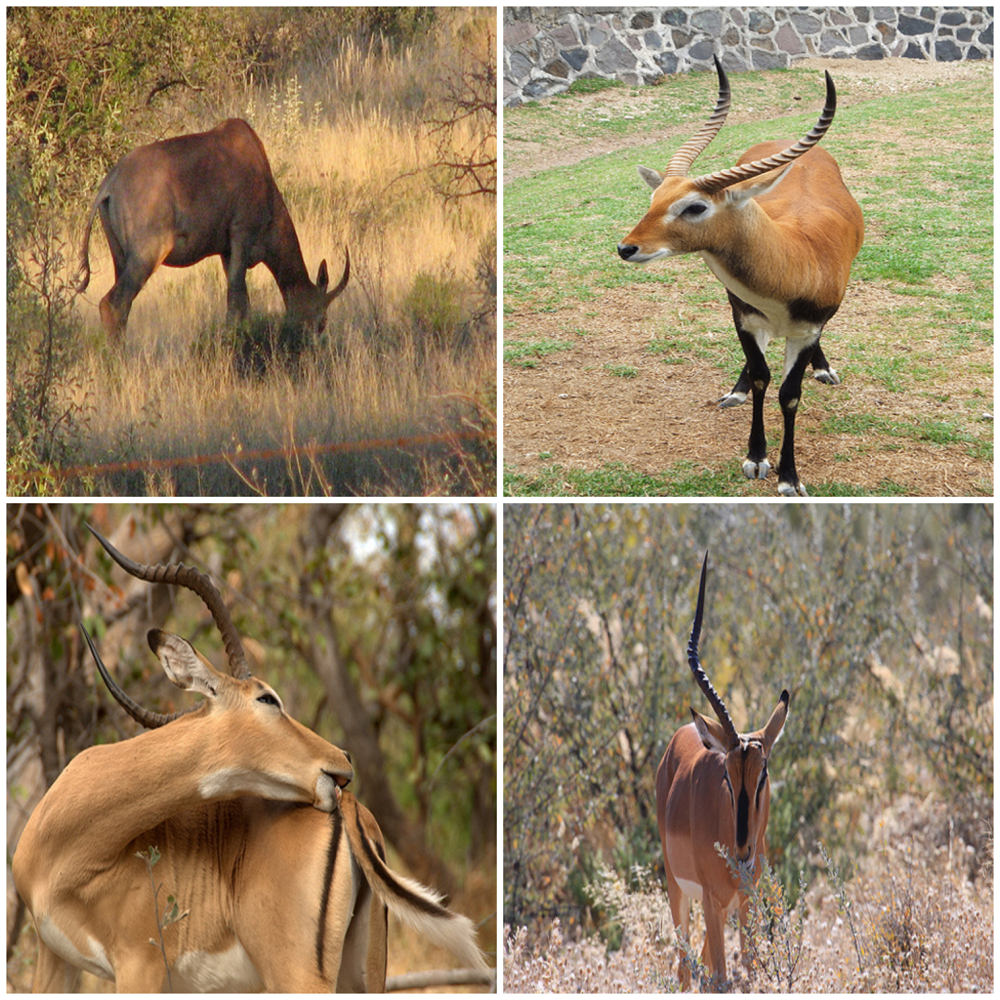

In [404]:
print(np.nonzero(source_clusters == 2)[0])
fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(2, 2),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )
for i in range(4):
    print(source_captions[source_clusters[0][0 + i]])
    print()
    print(got_prompts[source_clusters[0][0 + i]])
    grid[i].imshow(source_imgs[source_clusters[0][0 + i]])
    grid[i].axis('off')
plt.savefig("../figures/imagenet_cluster_0.pdf", bbox_inches='tight')

a woman standing next to a brown horse, danboru, aquiline nose, sleipnir, cheval michael, open neck collar, white and orange breastplate, einar jonsson, djelleba, arabian
a man standing next to a brown horse on a lush green field, aquiline nose, broadsword, anchient, classic dancer striking a pose, arabian, arabian features, phalanster, portcullis, inspired by George Lambourn


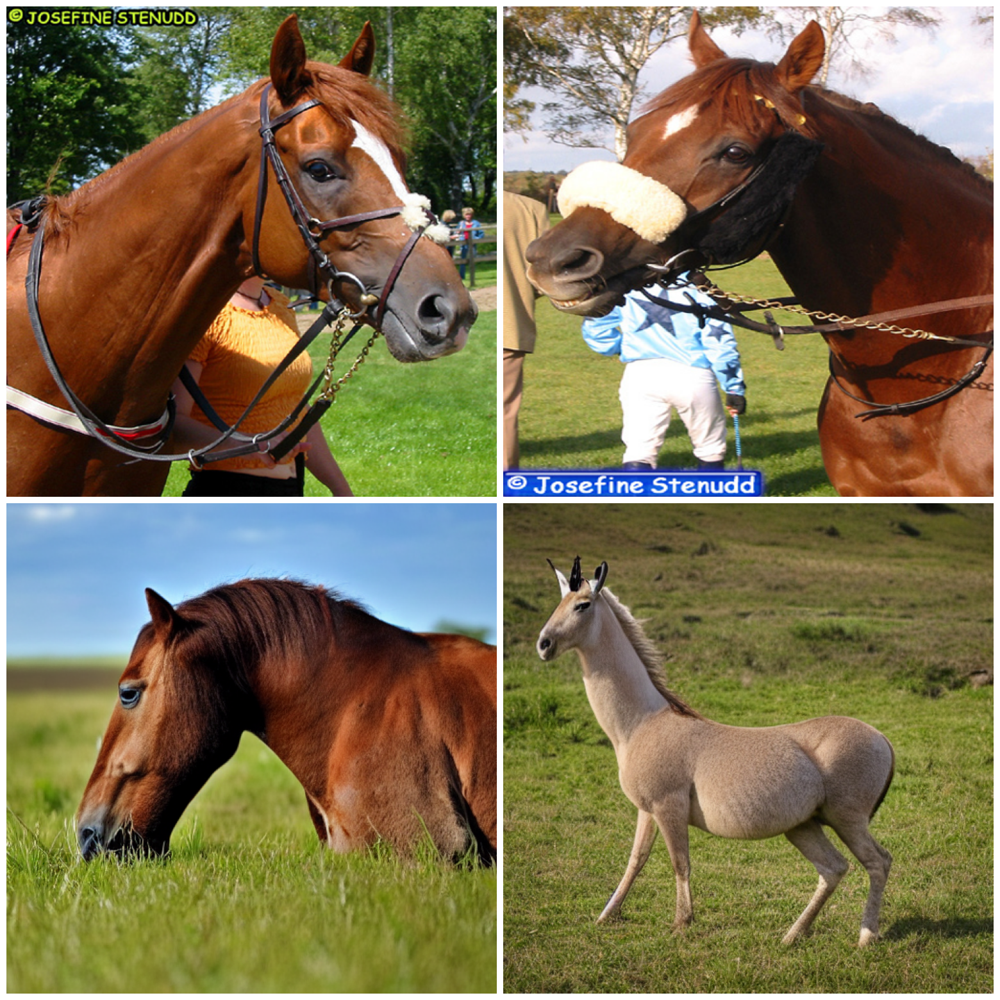

In [401]:
reverse_source_map = {j: i for i, j in enumerate(sample1)}

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(2, 2),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )
for i in range(2):
    grid[i].imshow(target_imgs[transformed_clusters[0][0 + i]])
    grid[i].axis('off')
for i in range(2):
    grid[2 + i].imshow(counterfactual_images[reverse_source_map[source_clusters[0][0 + i]]])
    grid[2 + i].axis('off')
plt.savefig("../figures/imagenet_cluster_0_transformed.pdf", bbox_inches='tight')
plt.close()

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(2, 2),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )
for i in range(2):
    print(target_captions[group_transformed_clusters[0][0 + i]])
    grid[i].imshow(target_imgs[group_transformed_clusters[0][0 + i]])
    grid[i].axis('off')
for i in range(2):
    grid[2 + i].imshow(counterfactual_images_group[reverse_source_map[source_clusters[0][0 + i]]])
    grid[2 + i].axis('off')
plt.savefig("../figures/imagenet_cluster_0_group_transformed.pdf", bbox_inches='tight')
# plt.close()

# Visualization of robustness experiment

In [136]:
def perturb_features(data, types, r=1):
    rand = np.random.uniform(size=data.shape)
    nonzero_feats = np.nonzero(np.sum(data, axis=0) > 0)[0]
    perturb_feats = np.random.choice(nonzero_feats, size=int(3 * nonzero_feats.shape[0]/4), replace=False) 
    perturbation = np.zeros(data.shape)
    for perturb_feat in perturb_feats:
        if types[perturb_feat] == "binary":
            # print(perturb_feat, "binary")
            if np.random.choice([-1, 1]) == 1: #np.sum(data[:, perturb_feat]) > data.shape[0] / 2:
                one_mask = data[:, perturb_feat] == 1
                perturb_mask = (rand[:, perturb_feat] < (r / 100)).astype(bool)
                perturbation[:, perturb_feat][one_mask & perturb_mask] = -1
                # print(np.sum(one_mask & perturb_mask))
            else:
                zero_mask = data[:, perturb_feat] == 0
                perturb_mask = (rand[:, perturb_feat] < (r / 100)).astype(bool)
                perturbation[:, perturb_feat][zero_mask & perturb_mask] = 1
                # print(np.sum(zero_mask & perturb_mask))
        elif types[perturb_feat] == "int":
            # print(perturb_feat, "int")
            if np.random.choice([-1, 1]) == 1:
                stdev = 1
                perturb_mask = (rand[:, perturb_feat] < (r / 100)).astype(bool)
                perturbation[:, perturb_feat][perturb_mask] = stdev
            else:
                stdev = 1
                perturb_mask = (rand[:, perturb_feat] < (r / 100)).astype(bool)
                pos_mask = data[:, perturb_feat] >= stdev
                perturbation[:, perturb_feat][pos_mask & perturb_mask] = -stdev
        else:
            stdev = 0.05 * np.std(data[:, perturb_feat])
            # print(perturb_feat, "float", stdev)
            perturb_mask = (rand[:, perturb_feat] < ((r) / 100)).astype(bool)
            pos_mask = data[:, perturb_feat] >= stdev
            perturbation[:, perturb_feat][pos_mask & perturb_mask] = stdev * np.random.choice([-1, 1])
    return r, perturbation

In [149]:
import pickle
import numpy as np
from PIL import Image
from src.distance import group_percent_explained
from src.counterfactual_img import resnet50_classify, counterfactual_img2img, resnet50_embed
from src.optimal_transport import group_kmeans_shift_transport
from sklearn.neighbors import KNeighborsClassifier


sample1 = pickle.load(open("../data/imagenetx/subset_5.pkl", "rb"))[:298]
sample2 = np.arange(target.shape[0])
print(sample1.shape, sample1)

# perturbation = pickle.load(open(f"../data/robustness/kmeans/imagenet_best_ceds_perturb.pkl", "rb"))
_, perturbation = perturb_features(source[sample1], ["int"] * source.shape[1], r=1)
print(perturbation.shape)
print(source.shape, target.shape)
source_captions = pickle.load(open("../data/imagenetx/source_captions.pkl", "rb"))

source_imgs = []
for filename in source_files:
    source_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))

target_imgs = []
for filename in target_files:
    target_imgs.append(Image.open(f"{IMAGENET_DIR}/{filename}").convert("RGB").resize((512, 512)))
    
no_group_s = np.ones((sample1.shape[0], 1))
x_s, centroids, shifts = group_kmeans_shift_transport(source[sample1], target, no_group_s, no_group_s, source.shape[1], 20, 150, 100)
x_s_pert, centroids, shifts = group_kmeans_shift_transport(source[sample1] + perturbation, target, no_group_s, no_group_s, source.shape[1], 20, 150, 100)
diff_pert = (x_s_pert - source[sample1]).round(0)
diff = (x_s - source[sample1]).round(0)

# counterfactual_images = pickle.load(open("../data/imagenetx/kc_counterfactual_images_5.pkl", "rb"))
# knn = KNeighborsClassifier(n_neighbors=1).fit(target, np.arange(target.shape[0]))
print("cf images:", len(counterfactual_images))
counterfactual_images, prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff)
# counterfactual_images = [target_imgs[i] for i in knn.predict(x_s.round(0))]
print("cf images:", len(counterfactual_images))
counterfactual_images_pert, pert_prompts = counterfactual_img2img([source_captions[i] for i in sample1], features, diff_pert)
# counterfactual_images_pert = [target_imgs[i] for i in knn.predict(x_s_pert.round(0))]

(298,) [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242 243 244

Iter 94 loss: 0.15481051280440697
Change in x_s: 0.003999528009444475
Iter 95 loss: 0.1548104071979545
Change in x_s: 0.0038307385984808207
Iter 96 loss: 0.1548103103997415
Change in x_s: 0.0036691480781883
Iter 97 loss: 0.15481022176452583
Change in x_s: 0.003514275886118412
Iter 98 loss: 0.154810140269274
Change in x_s: 0.0033659925684332848
Iter 99 loss: 0.15481006543045453
Change in x_s: 0.0032240222208201885
Samples in cluster 0: 19
Samples in cluster 1: 14
Samples in cluster 2: 12
Samples in cluster 3: 12
Samples in cluster 4: 7
Samples in cluster 5: 31
Samples in cluster 6: 17
Samples in cluster 7: 47
Samples in cluster 8: 4
Samples in cluster 9: 24
Samples in cluster 10: 5
Samples in cluster 11: 6
Samples in cluster 12: 34
Samples in cluster 13: 8
Samples in cluster 14: 9
Samples in cluster 15: 6
Samples in cluster 16: 14
Samples in cluster 17: 6
Samples in cluster 18: 15
Samples in cluster 19: 8
Iter 0 loss: 1.0
Change in x_s: 9.888654708862305
Iter 1 loss: 0.5235141600404264


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['dered sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['�🍸🍋, intruder']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', shocked expression']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', face to face, duel, fighting each other, fights, boxing match']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', an anthropomorphic deer, zoo photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns, two large horns on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['1 9 7 5 photo']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', african plains, female full body, male emaciated']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['expression, messy eater, hamsters']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', young adult male, a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male, a frontal portrait of a delicate, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['recore, m & m mascot']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', tufty whiskers, beautiful female white']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a branch']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on the, african plains, klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['face, jumping, bouncy belly']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', festive']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['veld background, two male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', by avigdor arikha, on the african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['roughled fur, servant']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gravity, olympic diving springoard']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['contorted limbs']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['hamlet, style of chippy, small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ima, lone female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ppe, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['with white hair, black female']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['k, holding a glowing orb']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', zumi, athene, small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['m on the head, holding a birthday cake']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['g, flexiseal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female, bushveld background, wildlife photography canon, savana background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['za, older male, big natural horns on her head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['greedy, eating, messy eater']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ppe landscape, steppe, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['orns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['savanna, wildlife photography canon']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['purple background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cute animal, staring hungrily']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['closeup of an adorable']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cute animal, inquisitive, miniature animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['dslr photo, whiskers']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- cream, gluttony']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male, small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the back']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plains, sables crossed in background, the most bizarre hybrid animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['footage, long tail with horns, full body profile camera shot, ground camera']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [", fluffy '', cute and cuddly"]


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', adult pair of twins']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', reflecting pool, wild species photography, wildlife preservation, natural reflections']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on a finger, lemon, puffy']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['curved horns!, two little horn on the head, with horns, short horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', maplestory mouse, young male, sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['archimedes, mouse']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plain, adult pair of twins']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ably kenyan, norm rockwell in africa, dynamic active running pose']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['from nature documentary, deer portrait, running in savana']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['with walking stick, sharp long horns, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['rare classified photo']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['african plains, klipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['toy, mixed animal, animals mating']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['glowing orb, small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gerenuk']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['munk, eating, gluttony']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['single horn, maxillipeds, an anthropomorphic, older male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['adorable, deer portrait, cute caracal, mouth in the bark']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', tail raised']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', long antennae, large horns, large horned tail, curved horns!']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plains, mature male, young female']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['crossed in background, wildlife preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['frightened and angry, cute animal, scared expression']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['huge surprised eyes, big eyes!!!!!!!!, surprised']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', smiling male, bauhause']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', rodent, mark hammil portrait']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['renuk, short horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['anna, wild species photography, lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['zumi, round cute face']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['level camera view']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tion, young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['inspired by correggio, motion blur']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- shirt']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['steppe, male emaciated, on the african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male, athene']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["earl, fluffy ''"]


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['bowl filled with food, superbowl, hamsters']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['of twins, on its, picture taken in zoo, impressive horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', anthropomorphic mouse']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', hamlet, short light grey whiskers']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in the savannah, grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['bone, wearing a tiara']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['deer, wildlife photograph, 2 0 0 mm telephoto']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['samburu, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mating, mixed animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['/ tiger, high quality nature photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['steppe, with, male, sharp long, background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cam footage, klipspringer, ground camera, thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cover shot']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ted brown fur, black female']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['white beard']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['albino, female looking, doe, single, female, perfect animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['zumi, style of chippy']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife documentary, maternal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['0. 0 mm']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['de wet, an ox, great']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['screenshot, kindred spirits, hamster']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', saturday night fever ( film )']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['natural tpose']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pomorphic deer, perfect animal, zoo photography, cute single animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ly!!!']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ram antlers, 4 k trailcam, small horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [", fluffy '', strawberry ice cream"]


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['with round cheeks, very fat']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['red - eyed, glowing red laser eyes']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', stock photography, hamsters holding rifles']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['k, gric, cookie monster']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['0 0 film']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sables crossed in background, full body profile camera shot']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mesh rope']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['resolution photograph, still from nature documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

cf images: 298


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['dered sugar']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['�🍸🍋, intruder']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gaturro']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', face to face, duel, fighting each other, fights, boxing match']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', an anthropomorphic deer, zoo photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on the head, great horns, two large horns on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photography canon, samburu, african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horn on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['1 9 7 5 photo']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['and giraffe body, s, long neck, savana background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['crossed in background, african steppe, many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', brown tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on the african plains, african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ism, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a branch']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['light brown fur, fast food, puffballs']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on the african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['roughled fur, servant']


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gravity, olympic diving springoard']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns on her head, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['contorted limbs']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['willemszoon de wet, african plains, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['caracal, perfect animal, 3 d parallax view effect,']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['orns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['large horned tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['satellite dishes, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['foggy effect']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['elterverfolgung']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['canon, young and slender, maternal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['id ecosystem, outside enclosure']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['by eugene von guerard, cute single animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', ibex masters, in the zoo exhibit, with horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['lipspringer']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- cream, gluttony']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male, small animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the back']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['footage, long tail with s, full body profile camera shot, ground camera']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['aciated, adult pair of twins']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', reflecting pool, wild species photography, wildlife preservation, natural reflections']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns, short horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['5. 0']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['documentary, caracal, real picture taken in zoo, anthropomorphic deer female']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on de wet, very tall and slender, a creature 5 meters tall']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['its head, zoology! fantastical creatures, large horned tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['unmistakably kenyan, norm rockwell in africa, dynamic active running pose']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['rare classified photo']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['steppe, zoomorphic, head and upper body in frame']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['jacob willemszoon de wet']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['toy, mixed animal, animals mating']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['deer, older male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['an adorable, deer portrait, cute caracal, mouth in the bark']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', tail raised']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on the, large horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['curved horns!']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['male, on its head, two large horns on the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['background, preservation']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horns on the head, gerenuk, short horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['fur, chinchilla animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['into the air, running pose, animals running along, running towards the camera']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['acorns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['�, eating outside, brown']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ines, beaver']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the head']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['blurry, night vision']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tails, sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['grasslands']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['footage, kodak hie infrared film, ground level camera view']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['tion, young male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', large horned tail, long horns, a horned']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['- shirt']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['steppe, male emaciated, on the african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', mixed animal, young male, mature male']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['0 s style painting']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', wildlife preservation, long sleek tail behind, on the, wild species photography']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['taken in zoo, impressive horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['two male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mm sharp lens']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in background, lush wildlife, long tail with horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['emaciated, small horns']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['srihari, deers, lush wildlife']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['deer, photograph, 2 0 0 mm telephoto']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sables crossed in background']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['taken in zoo, the devastating wise goat, petting zoo, zoo photography, white spiral s']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mixed animal']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', squirrel / tiger, high quality nature photography']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cartoon animal, an anthropomorphic deer, on its head, single horn']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sables crossed in, many wild animals']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['cover shot']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', thin young male']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['crossed animal, white stripes all over its body, single, zoo photography, on the african plains']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['horned tail, older male, long tail with horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['female, manimalist']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife documentary, maternal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['0. 0 mm']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['on de wet, an ox, great horns']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['natural tpose']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['pomorphic deer, perfect animal, zoo photography, cute single animal']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['anthropomorphic beaver']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wildlife, sharp long horns, large horned tail']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['still from nature documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['of film, photo 3 5 mm, kodak gold 2 0 0 film']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', sables crossed in background, full body profile camera shot']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', before the final culling']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mesh rope']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['resolution photograph, still from nature documentary']


  0%|          | 0/50 [00:00<?, ?it/s]

In [153]:
source_emb = resnet50_embed([source_imgs[i] for i in sample1])
target_emb = resnet50_embed(target_imgs)
cf_emb = resnet50_embed(counterfactual_images)
pert_emb = resnet50_embed(counterfactual_images_pert)

no_group_s = np.ones((source_emb.shape[0], 1))
no_group_t = np.ones((target_emb.shape[0], 1))
print(source_emb.shape, source_groups.shape)
pe, wgpe = group_percent_explained(source_emb, cf_emb[sample1], target_emb, source_groups[sample1], target_groups, ["g1", "g2", "g3", "g4"])
print("Regular PE:", pe, wgpe)
pe, wgpe = group_percent_explained(source_emb, pert_emb, target_emb, source_groups[sample1], target_groups, ["g1", "g2", "g3", "g4"])
print("Perturbed PE:", pe, wgpe)

source_cls = resnet50_classify([source_imgs[i] for i in sample1])
cf_cls = resnet50_classify(counterfactual_images)
cf_pert_cls = resnet50_classify(counterfactual_images_pert)

init_group1 = (source_labels[sample1] == 1)
init_group2 = (source_labels[sample1] == 0)
cf_group1 = np.isin(cf_cls, subclass_split[1][1])
cf_group2 = np.isin(cf_cls, subclass_split[1][2])
cf_pert_group1 = np.isin(cf_pert_cls, subclass_split[1][1])
cf_pert_group2 = np.isin(cf_pert_cls, subclass_split[1][2])

(298, 2048) (299, 2)
Total Percent Explained: 3.4045448728071825
g1 Percent Explained: -24.978000015271835
g2 Percent Explained: 10.931889834722238
Worst group PE: -24.978000015271835
Regular PE: 3.4045448728071825 -24.978000015271835
Total Percent Explained: 6.043149566621707
g1 Percent Explained: -21.966633851027144
g2 Percent Explained: 20.64909019270183
Worst group PE: -21.966633851027144
Perturbed PE: 6.043149566621707 -21.966633851027144


In [154]:
reg_feas = np.logical_or(init_group1 & cf_group1[sample1], init_group2 & cf_group2[sample1])
pert_feas = np.logical_or(init_group1 & cf_pert_group1, init_group2 & cf_pert_group2)

becomes_infeasible = np.logical_and(reg_feas == True, pert_feas == False)

In [155]:
print(np.sum(reg_feas) / reg_feas.shape[0])
print(np.sum(pert_feas) / pert_feas.shape[0])

0.3087248322147651
0.2684563758389262


In [156]:
print(np.sum(becomes_infeasible))
print(np.nonzero(becomes_infeasible))

50
(array([  3,   4,  12,  15,  19,  25,  40,  47,  55,  74,  95, 101, 108,
       112, 116, 123, 124, 125, 143, 148, 150, 153, 158, 163, 164, 165,
       166, 171, 177, 182, 196, 208, 215, 217, 219, 223, 224, 225, 227,
       228, 238, 250, 253, 254, 261, 262, 265, 272, 284, 291]),)


a large antelope standing on top of a grass covered field, savana background, samburu, on the african plains, running in savana, gerenuk, young male with walking stick, african steppe, african plains, two small horn on the head, wildlife preservation, male emaciated, single horn, wildlife photography canon, sables crossed in background
a large  standing on top of a grass covered field,  , samburu, on the  ,  in , , young male with walking stick,  ,  , two small  on the , wildlife preservation, male emaciated, single horn, wildlife photography canon, sables crossed in background

WILD, SPINES, SPIKY, SPIKY, PORCUP, HAIR, a large  standing on top of a grass covered field,  , samburu, on the  ,  in savana, , young male with walking stick,  ,  , two small  on the head, wildlife preservation, male emaciated, single horn, wildlife photography canon, sables crossed in background
-2.687499761581421
7.745966692414834


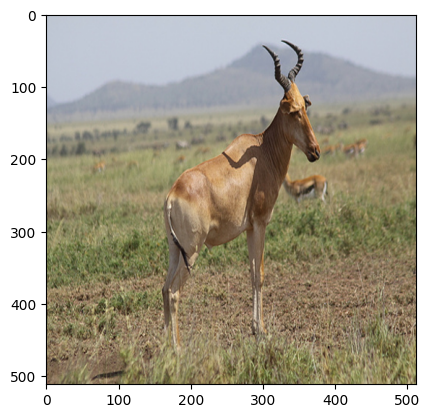

In [169]:
from matplotlib import pyplot as plt
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=1).fit(target, np.arange(target.shape[0]))
cf_nearest = knn.predict(x_s.round(0))
cf_pert_nearest = knn.predict(x_s_pert.round(0))

idx = 250
plt.imshow(source_imgs[idx])
print(source_captions[idx])
print(prompts[idx])
print()
print(pert_prompts[idx])
print((x_s - source[sample1])[idx][list(features).index("african")])
print(np.linalg.norm(perturbation))

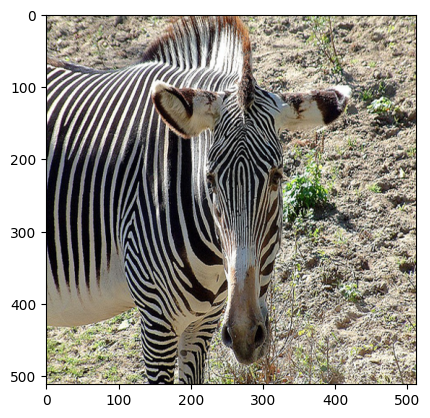

In [107]:
plt.imshow(target_imgs[cf_nearest[idx]])

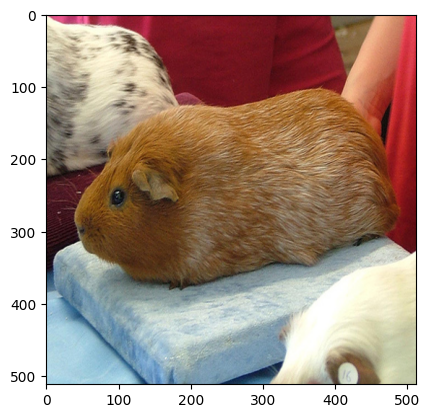

In [108]:
plt.imshow(target_imgs[cf_pert_nearest[idx]])